## NLP SUMMIT HACKATHON, OCTOBER 07-08, 2020, Diana Roccaro 

## IMPORTING LIBRARIES

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
import seaborn as sns

In [205]:
pd.set_option('display.max_columns', None)  
pd.set_option('display.expand_frame_repr', False)
#pd.set_option('max_colwidth', -1)

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import copy
import scipy.stats as stats

In [ ]:
pip install missingno

In [ ]:
import missingno as msno

## COVID PER COUNTRY

In [ ]:
# copy-pasted into xls from https://www.worldometers.info/coronavirus/#countries

In [ ]:
covid_recent_better = pd.read_excel('covid_most_recent_nocommas.xls')

In [ ]:
covid_recent_better.head

<bound method NDFrame.head of      Unnamed: 0       Unnamed: 1  total_cases  new_cases  total_deaths  new_deaths  total_recovered  active_cases  serious_cases  total_per_1M  deaths_per_1M  total_tests  tests_per_1M    population
0             1              USA      7762482    36753.0      216567.0       715.0        4969405.0     2576510.0        14517.0       23415.0          653.0  114013173.0      343909.0  3.315210e+08
1             2            India      6832988    78809.0      105554.0       963.0        5824462.0      902972.0         8944.0        4939.0           76.0   82271654.0       59462.0  1.383604e+09
2             3           Brazil      5000694    29741.0      148228.0       657.0        4391424.0      461042.0         8318.0       23482.0          696.0   17900000.0       84053.0  2.129621e+08
3             4           Russia      1248619    11115.0       21865.0       202.0         995275.0      231479.0         2300.0        8555.0          150.0   48700000.0    

In [ ]:
type(covid_recent_better)

pandas.core.frame.DataFrame

In [ ]:
covid_recent_better.describe()

,Unnamed: 0,total_cases,new_cases,total_deaths,new_deaths,total_recovered,active_cases,serious_cases,total_per_1M,deaths_per_1M,total_tests,tests_per_1M,population
count,216.000,2.160000e+02,142.000000,193.000000,93.000000,2.100000e+02,2.120000e+02,133.000000,214.000000,191.000000,1.950000e+02,1.950000e+02,2.140000e+02
mean,108.500,1.682101e+05,2090.774648,5487.005181,52.698925,1.279816e+05,3.218171e+04,510.842105,5934.336449,140.294660,3.500803e+06,1.726138e+05,3.635039e+07
std,62.498,7.899275e+05,7907.310651,21818.677873,148.428638,6.151474e+05,1.935747e+05,1725.231446,8072.423514,208.382265,1.570567e+07,3.255041e+05,1.414494e+08
min,1.000,1.000000e+00,1.000000,1.000000,1.000000,3.000000e+00,0.000000e+00,1.000000,1.000000,0.080000,4.830000e+02,1.073000e+03,8.020000e+02
25%,54.750,1.329000e+03,30.500000,49.000000,3.000000,1.039750e+03,7.425000e+01,5.000000,565.500000,13.500000,4.270850e+04,2.220750e+04,8.092802e+05
50%,108.500,8.978500e+03,208.500000,212.000000,8.000000,5.581500e+03,1.209000e+03,26.000000,3036.000000,54.000000,2.532640e+05,7.503800e+04,6.856539e+06
75%,162.250,6.317025e+04,1058.000000,1255.000000,29.000000,4.478200e+04,8.754500e+03,211.000000,8078.750000,182.500000,1.409318e+06,1.749750e+05,2.529071e+07
max,216.000,7.762482e+06,78809.000000,216567.000000,963.000000,5.824462e+06,2.576510e+06,14517.000000,45296.000000,1237.000000,1.600000e+08,2.778198e+06,1.439324e+09


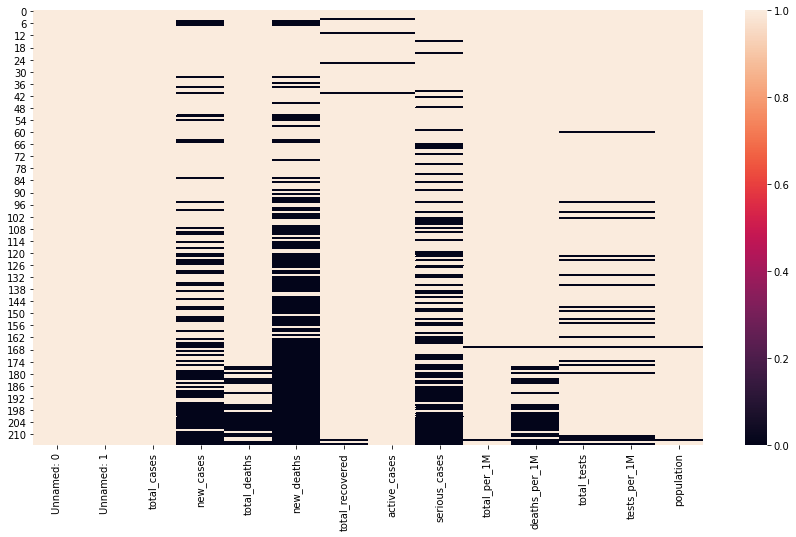

In [ ]:
plt.figure(figsize=(15,8))
sns.heatmap(covid_recent_better.notna())
plt.show()

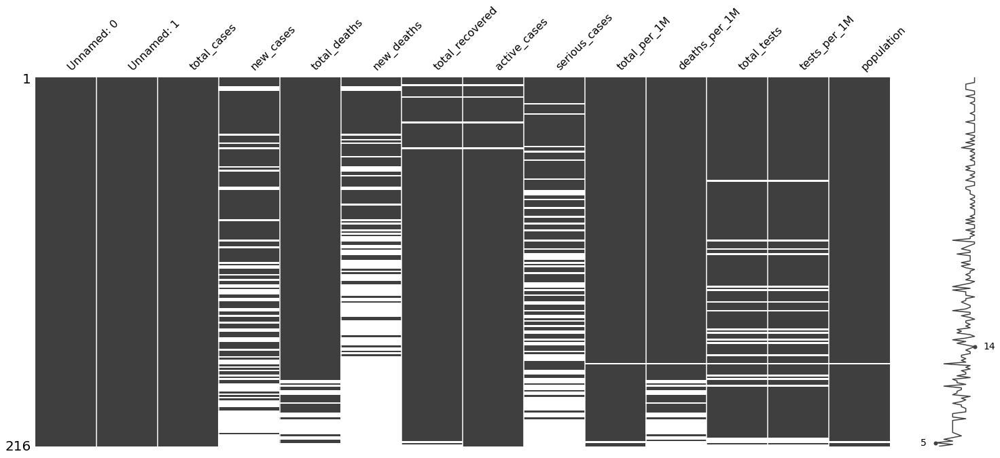

In [ ]:
import missingno as msno
%matplotlib inline
msno.matrix(covid_recent_better)

In [ ]:
covid_recent_better.columns

Index(['Unnamed: 0', 'Unnamed: 1', 'total_cases', 'new_cases', 'total_deaths',
       'new_deaths', 'total_recovered', 'active_cases', 'serious_cases',
       'total_per_1M', 'deaths_per_1M', 'total_tests', 'tests_per_1M',
       'population'],
      dtype='object')

In [ ]:
covid_interesting = covid_recent_better[['Unnamed: 1', 'total_per_1M', 'deaths_per_1M', 'tests_per_1M']]

In [ ]:
covid_interesting.head()

,Unnamed: 1,total_per_1M,deaths_per_1M,tests_per_1M
0,USA,23415.0,653.0,343909.0
1,India,4939.0,76.0,59462.0
2,Brazil,23482.0,696.0,84053.0
3,Russia,8555.0,150.0,333673.0
4,Spain,18654.0,696.0,292769.0


In [ ]:
covid_interesting.head()

,Unnamed: 1,total_per_1M,deaths_per_1M,tests_per_1M
0,USA,23415.0,653.0,343909.0
1,India,4939.0,76.0,59462.0
2,Brazil,23482.0,696.0,84053.0
3,Russia,8555.0,150.0,333673.0
4,Spain,18654.0,696.0,292769.0


In [ ]:
covid_interesting['deathsPerTotal'] = covid_interesting.deaths_per_1M / covid_interesting.total_per_1M

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
covid_interesting.head()

,Unnamed: 1,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal
0,USA,23415.0,653.0,343909.0,0.027888
1,India,4939.0,76.0,59462.0,0.015388
2,Brazil,23482.0,696.0,84053.0,0.029640
3,Russia,8555.0,150.0,333673.0,0.017534
4,Spain,18654.0,696.0,292769.0,0.037311


In [ ]:
covid_interesting.rename(columns={'Unnamed: 1': 'country'}, inplace=True)

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4303: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [ ]:
covid_interesting.head()

,country,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal
0,USA,23415.0,653.0,343909.0,0.027888
1,India,4939.0,76.0,59462.0,0.015388
2,Brazil,23482.0,696.0,84053.0,0.029640
3,Russia,8555.0,150.0,333673.0,0.017534
4,Spain,18654.0,696.0,292769.0,0.037311


/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


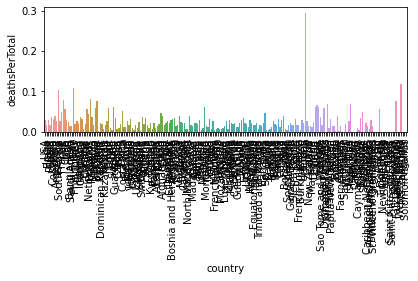

In [ ]:
sns.barplot(covid_interesting['country'],covid_interesting['deathsPerTotal'])

plt.xticks(rotation=90)
plt.tight_layout()

In [ ]:
# https://opensource.com/article/20/4/python-map-covid-19

In [ ]:
list_countries = covid_interesting['country'].unique().tolist()

In [ ]:
list_countries

['USA',
 'India',
 'Brazil',
 'Russia',
 'Spain',
 'Colombia',
 'Peru',
 'Argentina',
 'Mexico',
 'South Africa',
 'France',
 'UK',
 'Iran',
 'Chile',
 'Iraq',
 'Bangladesh',
 'Saudi Arabia',
 'Italy',
 'Philippines',
 'Turkey',
 'Pakistan',
 'Indonesia',
 'Germany',
 'Israel',
 'Ukraine',
 'Canada',
 'Netherlands',
 'Ecuador',
 'Romania',
 'Morocco',
 'Bolivia',
 'Belgium',
 'Qatar',
 'Panama',
 'Dominican Republic',
 'Kuwait',
 'Kazakhstan',
 'Poland',
 'Egypt',
 'Oman',
 'UAE',
 'Sweden',
 'Guatemala',
 'Nepal',
 'Czechia',
 'Japan',
 'China',
 'Costa Rica',
 'Belarus',
 'Portugal',
 'Ethiopia',
 'Honduras',
 'Venezuela',
 'Bahrain',
 'Nigeria',
 'Uzbekistan',
 'Moldova',
 'Singapore',
 'Switzerland',
 'Armenia',
 'Algeria',
 'Austria',
 'Lebanon',
 'Kyrgyzstan',
 'Ghana',
 'Paraguay',
 'Palestine',
 'Azerbaijan',
 'Kenya',
 'Ireland',
 'Afghanistan',
 'Libya',
 'Serbia',
 'Hungary',
 'Denmark',
 'El Salvador',
 'Bosnia and Herzegovina',
 'Australia',
 'Tunisia',
 'S. Korea',
 'Bulg

In [ ]:
d_country_code = {}  # To hold the country names and their ISO
for country in list_countries:
    try:
        country_data = pycountry.countries.search_fuzzy(country)
        # country_data is a list of objects of class pycountry.db.Country
        # The first item  ie at index 0 of list is best fit
        # object of class Country have an alpha_3 attribute
        country_code = country_data[0].alpha_3
        d_country_code.update({country: country_code})
    except:
        print('could not add ISO 3 code for ->', country)
        # If could not find country, make ISO code ' '
        d_country_code.update({country: ' '})

could not add ISO 3 code for -> UAE
could not add ISO 3 code for -> S. Korea
could not add ISO 3 code for -> Ivory Coast
could not add ISO 3 code for -> DRC
could not add ISO 3 code for -> Diamond Princess
could not add ISO 3 code for -> Channel Islands
could not add ISO 3 code for -> Faeroe Islands
could not add ISO 3 code for -> Caribbean Netherlands
could not add ISO 3 code for -> St. Vincent Grenadines
could not add ISO 3 code for -> St. Barth
could not add ISO 3 code for -> Laos
could not add ISO 3 code for -> Saint Pierre Miquelon
could not add ISO 3 code for -> MS Zaandam


In [ ]:
d_country_code.update({'S. Korea': 'KOR', 'Laos': 'LAO', 'Macao SAR, China': 'MAC'})

In [ ]:
print(d_country_code)

{'USA': 'USA', 'India': 'IND', 'Brazil': 'BRA', 'Russia': 'RUS', 'Spain': 'ESP', 'Colombia': 'COL', 'Peru': 'PER', 'Argentina': 'ARG', 'Mexico': 'MEX', 'South Africa': 'ZAF', 'France': 'FRA', 'UK': 'UKR', 'Iran': 'IRN', 'Chile': 'CHL', 'Iraq': 'IRQ', 'Bangladesh': 'BGD', 'Saudi Arabia': 'SAU', 'Italy': 'ITA', 'Philippines': 'PHL', 'Turkey': 'TUR', 'Pakistan': 'PAK', 'Indonesia': 'IDN', 'Germany': 'DEU', 'Israel': 'ISR', 'Ukraine': 'UKR', 'Canada': 'CAN', 'Netherlands': 'NLD', 'Ecuador': 'ECU', 'Romania': 'ROU', 'Morocco': 'MAR', 'Bolivia': 'BOL', 'Belgium': 'BEL', 'Qatar': 'QAT', 'Panama': 'PAN', 'Dominican Republic': 'DOM', 'Kuwait': 'KWT', 'Kazakhstan': 'KAZ', 'Poland': 'POL', 'Egypt': 'EGY', 'Oman': 'OMN', 'UAE': ' ', 'Sweden': 'SWE', 'Guatemala': 'GTM', 'Nepal': 'NPL', 'Czechia': 'CZE', 'Japan': 'JPN', 'China': 'CHN', 'Costa Rica': 'CRI', 'Belarus': 'BLR', 'Portugal': 'PRT', 'Ethiopia': 'ETH', 'Honduras': 'HND', 'Venezuela': 'VEN', 'Bahrain': 'BHR', 'Nigeria': 'NGA', 'Uzbekistan': 

In [ ]:
covid_interesting.head()

,country,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal
0,USA,23415.0,653.0,343909.0,0.027888
1,India,4939.0,76.0,59462.0,0.015388
2,Brazil,23482.0,696.0,84053.0,0.029640
3,Russia,8555.0,150.0,333673.0,0.017534
4,Spain,18654.0,696.0,292769.0,0.037311


In [ ]:
# create a new column iso_alpha in the df
# and fill it with appropriate iso 3 code
for k, v in d_country_code.items():
    covid_interesting.loc[(covid_interesting['country'] == k), 'iso_alpha'] = v

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
covid_interesting.head()

,country,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha
0,USA,23415.0,653.0,343909.0,0.027888,USA
1,India,4939.0,76.0,59462.0,0.015388,IND
2,Brazil,23482.0,696.0,84053.0,0.029640,BRA
3,Russia,8555.0,150.0,333673.0,0.017534,RUS
4,Spain,18654.0,696.0,292769.0,0.037311,ESP


In [ ]:
covid_interesting.describe()

,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal
count,214.000000,191.000000,1.950000e+02,191.000000
mean,5934.336449,140.294660,1.726138e+05,0.026405
std,8072.423514,208.382265,3.255041e+05,0.027884
min,1.000000,0.080000,1.073000e+03,0.000507
25%,565.500000,13.500000,2.220750e+04,0.012524
50%,3036.000000,54.000000,7.503800e+04,0.020351
75%,8078.750000,182.500000,1.749750e+05,0.031071
max,45296.000000,1237.000000,2.778198e+06,0.294118


In [ ]:
covid_interesting.sort_values(by=['deathsPerTotal'], ascending=False)

,country,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha
155,Yemen,68.0,20.0,NaN,0.294118,YEM
212,Western Sahara,17.0,2.0,NaN,0.117647,ESH
17,Italy,5525.0,597.0,199700.0,0.108054,ITA
8,Mexico,6146.0,637.0,15633.0,0.103645,MEX
27,Ecuador,8103.0,663.0,25694.0,0.081822,ECU
...,...,...,...,...,...,...
210,Falkland Islands,3708.0,NaN,644894.0,NaN,FLK
211,Vatican City,14963.0,NaN,NaN,NaN,VAT
213,MS Zaandam,NaN,NaN,NaN,NaN,
214,Anguilla,199.0,NaN,67824.0,NaN,AIA


In [ ]:
from google.colab import files

covid_interesting.to_csv('covid_interesting.csv')
files.download('covid_interesting.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
fig = px.choropleth(data_frame = covid_interesting,
                    locations= "iso_alpha",
                    color= "deathsPerTotal",  # value in column 'Confirmed' determines color
                    hover_name= "country",
                    color_continuous_scale= 'BuPu',  #  color scale red, yellow green   # RdYlGn_r
                    #plt.clim(0, 252)
                    # animation_frame= "Date"
                    )

In [ ]:
fig.show() # deathsPerTotal

## BMI Lancet

In [ ]:
# BMI_Lancet = pd.read_csv('NCD_RisC_Lancet_2017_BMI_age_standardised_country.txt')

In [ ]:
BMI_Lancet = pd.read_excel('BMI_Lancet.xlsx')

In [ ]:
BMI_Lancet.head()

,Country/Region/World,ISO,Sex,Year,Mean BMI,Mean BMI lower 95% uncertainty interval,Mean BMI upper 95% uncertainty interval,Prevalence of BMI>=30 kg/mｲ (obesity),Prevalence of BMI>=30 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI>=30 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI>=35 kg/mｲ (severe obesity),Prevalence of BMI>=35 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI>=35 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI<18.5 kg/mｲ (underweight),Prevalence of BMI<18.5 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI<18.5 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI 18.5 kg/mｲ to <20 kg/mｲ,Prevalence of BMI 18.5 kg/mｲ to <20 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI 18.5 kg/mｲ to <20 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI 20 kg/mｲ to <25 kg/mｲ,Prevalence of BMI 20 kg/mｲ to <25 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI 20 kg/mｲ to <25 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI 25 kg/mｲ to <30 kg/mｲ,Prevalence of BMI 25 kg/mｲ to <30 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI 25 kg/mｲ to <30 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI 30 kg/mｲ to <35 kg/mｲ,Prevalence of BMI 30 kg/mｲ to <35 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI 30 kg/mｲ to <35 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI 35 kg/mｲ to <40 kg/mｲ,Prevalence of BMI 35 kg/mｲ to <40 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI 35 kg/mｲ to <40 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI >=40 kg/mｲ(morbid obesity),Prevalence of BMI >=40 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI >=40 kg/mｲ upper 95% uncertainty interval
0,Afghanistan,AFG,Men,1975,18.999440,16.331119,21.763077,0.002078,0.000384,0.006515,0.000034,0.000002,0.000158,0.284239,0.147565,0.421922,0.234271,0.134912,0.347236,0.428146,0.312880,0.551022,0.051266,0.021452,0.096419,0.002043,0.000351,0.006493,0.000027,6.663263e-07,0.000138,0.000008,5.054664e-08,0.000047
1,Afghanistan,AFG,Men,1976,19.105518,16.500077,21.801109,0.002237,0.000437,0.006820,0.000038,0.000002,0.000168,0.281990,0.148634,0.417047,0.232208,0.136020,0.340563,0.430523,0.317865,0.549570,0.053042,0.022928,0.097881,0.002199,0.000403,0.006779,0.000030,8.525116e-07,0.000149,0.000009,6.816061e-08,0.000049
2,Afghanistan,AFG,Men,1977,19.212080,16.646507,21.842021,0.002410,0.000497,0.007179,0.000042,0.000003,0.000185,0.279694,0.149224,0.412887,0.230125,0.136671,0.335139,0.432881,0.322810,0.549225,0.054890,0.024613,0.098869,0.002368,0.000454,0.007144,0.000033,1.080451e-06,0.000163,0.000009,9.255251e-08,0.000053
3,Afghanistan,AFG,Men,1978,19.319053,16.786899,21.876516,0.002599,0.000559,0.007567,0.000047,0.000003,0.000202,0.277336,0.150410,0.407314,0.228031,0.137231,0.330865,0.435219,0.327795,0.548325,0.056815,0.026318,0.100453,0.002551,0.000519,0.007540,0.000037,1.364412e-06,0.000178,0.000010,1.262377e-07,0.000057
4,Afghanistan,AFG,Men,1979,19.425952,16.950002,21.930634,0.002804,0.000636,0.008026,0.000053,0.000004,0.000220,0.274931,0.151589,0.403758,0.225927,0.137064,0.327193,0.437522,0.332613,0.547925,0.058816,0.028116,0.102426,0.002751,0.000581,0.007971,0.000041,1.698723e-06,0.000193,0.000011,1.576738e-07,0.000062


In [ ]:
BMI_Lancet.Year.describe()

count    16800.000000
mean      1995.500000
std         12.121279
min       1975.000000
25%       1985.000000
50%       1995.500000
75%       2006.000000
max       2016.000000
Name: Year, dtype: float64

In [ ]:
bmi_2015 = BMI_Lancet.loc[BMI_Lancet.Year==2015]

In [ ]:
bmi_2015.shape

(400, 34)

In [ ]:
bmi_15_m = bmi_2015.loc[bmi_2015.Sex=='Men']

In [ ]:
bmi_15_m.shape

(200, 34)

In [ ]:
bmi_2016 = BMI_Lancet.loc[BMI_Lancet.Year==2016]

In [ ]:
bmi_2016.shape

(400, 34)

In [ ]:
bmi_16_m = bmi_2016.loc[bmi_2016.Sex=='Men']

In [ ]:
bmi_16_m.shape

(200, 34)

In [ ]:
bmi_2016

,Country/Region/World,ISO,Sex,Year,Mean BMI,Mean BMI lower 95% uncertainty interval,Mean BMI upper 95% uncertainty interval,Prevalence of BMI>=30 kg/mｲ (obesity),Prevalence of BMI>=30 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI>=30 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI>=35 kg/mｲ (severe obesity),Prevalence of BMI>=35 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI>=35 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI<18.5 kg/mｲ (underweight),Prevalence of BMI<18.5 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI<18.5 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI 18.5 kg/mｲ to <20 kg/mｲ,Prevalence of BMI 18.5 kg/mｲ to <20 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI 18.5 kg/mｲ to <20 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI 20 kg/mｲ to <25 kg/mｲ,Prevalence of BMI 20 kg/mｲ to <25 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI 20 kg/mｲ to <25 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI 25 kg/mｲ to <30 kg/mｲ,Prevalence of BMI 25 kg/mｲ to <30 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI 25 kg/mｲ to <30 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI 30 kg/mｲ to <35 kg/mｲ,Prevalence of BMI 30 kg/mｲ to <35 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI 30 kg/mｲ to <35 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI 35 kg/mｲ to <40 kg/mｲ,Prevalence of BMI 35 kg/mｲ to <40 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI 35 kg/mｲ to <40 kg/mｲ upper 95% uncertainty interval,Prevalence of BMI >=40 kg/mｲ(morbid obesity),Prevalence of BMI >=40 kg/mｲ lower 95% uncertainty interval,Prevalence of BMI >=40 kg/mｲ upper 95% uncertainty interval
41,Afghanistan,AFG,Men,2016,22.682456,20.157475,25.241857,0.033603,0.013884,0.066334,0.003314,0.000700,0.009421,0.166902,0.074886,0.282181,0.143171,0.080741,0.221186,0.485283,0.392800,0.580704,0.171040,0.111980,0.242503,0.030290,0.011207,0.062681,0.002271,0.000310,0.007487,0.001043,0.000074,0.004265
83,Albania,ALB,Men,2016,27.174471,25.975170,28.338256,0.223735,0.153334,0.300834,0.045036,0.019174,0.085221,0.003623,0.000924,0.009317,0.016129,0.007466,0.029420,0.317555,0.251689,0.386917,0.438957,0.360796,0.515957,0.178699,0.113401,0.252200,0.037684,0.013616,0.076984,0.007352,0.001180,0.021953
125,Algeria,DZA,Men,2016,24.865386,23.487321,26.220294,0.206662,0.141854,0.279979,0.042840,0.018966,0.079619,0.033010,0.012411,0.065925,0.039562,0.020643,0.068641,0.330278,0.267167,0.397481,0.390488,0.314456,0.463570,0.163822,0.102610,0.234048,0.031750,0.011066,0.065164,0.011090,0.002289,0.029802
167,American Samoa,ASM,Men,2016,33.066721,31.338678,34.662447,0.587546,0.502606,0.666355,0.322678,0.228947,0.418486,0.000456,0.000081,0.001409,0.001946,0.000662,0.004212,0.113775,0.076331,0.156528,0.296277,0.227702,0.370043,0.264868,0.191211,0.340031,0.183871,0.109862,0.263723,0.138807,0.067651,0.223666
209,Andorra,AND,Men,2016,27.478395,24.988831,30.001977,0.267498,0.186223,0.354723,0.068565,0.027992,0.130821,0.003248,0.000686,0.009325,0.011511,0.004766,0.022611,0.263758,0.204134,0.329945,0.453984,0.374915,0.532478,0.198934,0.125035,0.280761,0.052701,0.017627,0.109639,0.015864,0.002652,0.046309
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16631,Venezuela,VEN,Women,2016,26.939841,26.148956,27.733570,0.297526,0.234430,0.364287,0.100923,0.062282,0.149537,0.015851,0.007058,0.029991,0.035085,0.019523,0.054924,0.293812,0.237227,0.355353,0.357725,0.295225,0.421753,0.196603,0.139026,0.262398,0.075728,0.041070,0.120149,0.025195,0.009495,0.048975
16673,Viet Nam,VNM,Women,2016,21.940594,21.329260,22.564460,0.027065,0.015304,0.044264,0.003012,0.001205,0.006063,0.179459,0.121435,0.242012,0.144157,0.100163,0.193800,0.463826,0.401319,0.527711,0.185493,0.136820,0.237665,0.024053,0.012707,0.041163,0.002742,0.000968,0.005795,0.000270,0.000051,0.000786
16715,Yemen,YEM,Women,2016,24.197709,23.356827,25.050170,0.229724,0

In [ ]:
bmi_2016_relevant = bmi_2016[['Country/Region/World', 'ISO', 'Sex', 'Mean BMI', 'Prevalence of BMI>=30 kg/mｲ (obesity)', 'Prevalence of BMI>=35 kg/mｲ (severe obesity)', 'Prevalence of BMI<18.5 kg/mｲ (underweight)']]

In [ ]:
bmi_2016_relevant

,Country/Region/World,ISO,Sex,Mean BMI,Prevalence of BMI>=30 kg/mｲ (obesity),Prevalence of BMI>=35 kg/mｲ (severe obesity),Prevalence of BMI<18.5 kg/mｲ (underweight)
41,Afghanistan,AFG,Men,22.682456,0.033603,0.003314,0.166902
83,Albania,ALB,Men,27.174471,0.223735,0.045036,0.003623
125,Algeria,DZA,Men,24.865386,0.206662,0.042840,0.033010
167,American Samoa,ASM,Men,33.066721,0.587546,0.322678,0.000456
209,Andorra,AND,Men,27.478395,0.267498,0.068565,0.003248
...,...,...,...,...,...,...,...
16631,Venezuela,VEN,Women,26.939841,0.297526,0.100923,0.015851
16673,Viet Nam,VNM,Women,21.940594,0.027065,0.003012,0.179459
16715,Yemen,YEM,Women,24.197709,0.229724,0.069347,0.076193
16757,Zambia,ZMB,Women,23.833982,0.129887,0.038038,0.084601


In [ ]:
from google.colab import files

bmi_2016_relevant.to_csv('bmi_2016_relevant.csv')
files.download('bmi_2016_relevant.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
bmi_2016_relevant = pd.read_csv('bmi_2016_relevant.csv')

In [ ]:
bmi_2016_relevant.ISO.isna().sum()

0

In [ ]:
bmi_2016_relevant.head()

,Unnamed: 0,Country/Region/World,ISO,Sex,Mean BMI,Prevalence of BMI>=30 kg/mｲ (obesity),Prevalence of BMI>=35 kg/mｲ (severe obesity),Prevalence of BMI<18.5 kg/mｲ (underweight)
0,41,Afghanistan,AFG,Men,22.682456,0.033603,0.003314,0.166902
1,83,Albania,ALB,Men,27.174471,0.223735,0.045036,0.003623
2,125,Algeria,DZA,Men,24.865386,0.206662,0.042840,0.033010
3,167,American Samoa,ASM,Men,33.066721,0.587546,0.322678,0.000456
4,209,Andorra,AND,Men,27.478395,0.267498,0.068565,0.003248


In [ ]:
bmi_2016_relevant.shape

(400, 8)

In [ ]:
bmi_2016_relevant.columns = bmi_2016_relevant.columns.str.replace(' ', '_')
bmi_2016_relevant.columns = bmi_2016_relevant.columns.str.replace('>=', '_above_')
bmi_2016_relevant.columns = bmi_2016_relevant.columns.str.replace('ｲ', '2')
bmi_2016_relevant.columns = bmi_2016_relevant.columns.str.replace('(', '')
bmi_2016_relevant.columns = bmi_2016_relevant.columns.str.replace(')', '')
bmi_2016_relevant.columns = bmi_2016_relevant.columns.str.replace('/', 'Per')
bmi_2016_relevant.columns = bmi_2016_relevant.columns.str.replace('<', '_below_')

In [ ]:
bmi_2016_relevant.head()

,Unnamed:_0,CountryPerRegionPerWorld,ISO,Sex,Mean_BMI,Prevalence_of_BMI_above_30_kgPerm2_obesity,Prevalence_of_BMI_above_35_kgPerm2_severe_obesity,Prevalence_of_BMI_below_18.5_kgPerm2_underweight
0,41,Afghanistan,AFG,Men,22.682456,0.033603,0.003314,0.166902
1,83,Albania,ALB,Men,27.174471,0.223735,0.045036,0.003623
2,125,Algeria,DZA,Men,24.865386,0.206662,0.042840,0.033010
3,167,American Samoa,ASM,Men,33.066721,0.587546,0.322678,0.000456
4,209,Andorra,AND,Men,27.478395,0.267498,0.068565,0.003248


In [ ]:
# create one columns for BMI 2016 men and one for 2015 women .... take prevalence of BMI>30 (since there is none such for >25 !?!?)

men = bmi_2016_relevant.loc[bmi_2016_relevant.Sex=='Men']
men.shape

(200, 8)

In [ ]:
men['BMIabove30_men'] = men['Prevalence_of_BMI_above_30_kgPerm2_obesity']

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
men['BMIabove35_men'] = men['Prevalence_of_BMI_above_35_kgPerm2_severe_obesity']
men['BMIbelow18_men'] = men['Prevalence_of_BMI_below_18.5_kgPerm2_underweight']

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
men['mean_BMI_men'] = men['Mean_BMI']

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
men.head()

,Unnamed:_0,CountryPerRegionPerWorld,ISO,Sex,Mean_BMI,Prevalence_of_BMI_above_30_kgPerm2_obesity,Prevalence_of_BMI_above_35_kgPerm2_severe_obesity,Prevalence_of_BMI_below_18.5_kgPerm2_underweight,BMIabove30_men,BMIabove35_men,BMIbelow18_men,mean_BMI_men
0,41,Afghanistan,AFG,Men,22.682456,0.033603,0.003314,0.166902,0.033603,0.003314,0.166902,22.682456
1,83,Albania,ALB,Men,27.174471,0.223735,0.045036,0.003623,0.223735,0.045036,0.003623,27.174471
2,125,Algeria,DZA,Men,24.865386,0.206662,0.042840,0.033010,0.206662,0.042840,0.033010,24.865386
3,167,American Samoa,ASM,Men,33.066721,0.587546,0.322678,0.000456,0.587546,0.322678,0.000456,33.066721
4,209,Andorra,AND,Men,27.478395,0.267498,0.068565,0.003248,0.267498,0.068565,0.003248,27.478395


In [ ]:
men_relevant = men[['CountryPerRegionPerWorld', 'ISO', 'mean_BMI_men', 'BMIabove30_men', 'BMIabove35_men', 'BMIbelow18_men']]

In [ ]:
# create one columns for BMI 2016 men and one for 2015 women .... take prevalence of BMI>30 (since there is none such for >25 !?!?)

women = bmi_2016_relevant.loc[bmi_2016_relevant.Sex=='Women']
women.shape

(200, 8)

In [ ]:
women['BMIabove30_women'] = women['Prevalence_of_BMI_above_30_kgPerm2_obesity']

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
women['BMIabove35_women'] = women['Prevalence_of_BMI_above_35_kgPerm2_severe_obesity']
women['BMIbelow18_women'] = women['Prevalence_of_BMI_below_18.5_kgPerm2_underweight']

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
women['mean_BMI_women'] = women['Mean_BMI']

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
women.head()

,Unnamed:_0,CountryPerRegionPerWorld,ISO,Sex,Mean_BMI,Prevalence_of_BMI_above_30_kgPerm2_obesity,Prevalence_of_BMI_above_35_kgPerm2_severe_obesity,Prevalence_of_BMI_below_18.5_kgPerm2_underweight,BMIabove30_women,BMIabove35_women,BMIbelow18_women,mean_BMI_women
200,8441,Afghanistan,AFG,Women,24.234135,0.080023,0.019154,0.156378,0.080023,0.019154,0.156378,24.234135
201,8483,Albania,ALB,Women,26.507512,0.227215,0.072337,0.019943,0.227215,0.072337,0.019943,26.507512
202,8525,Algeria,DZA,Women,26.561166,0.362187,0.136361,0.032798,0.362187,0.136361,0.032798,26.561166
203,8567,American Samoa,ASM,Women,35.148865,0.653208,0.396113,0.002016,0.653208,0.396113,0.002016,35.148865
204,8609,Andorra,AND,Women,26.271661,0.263382,0.093098,0.014833,0.263382,0.093098,0.014833,26.271661


In [ ]:
women_relevant = women[['CountryPerRegionPerWorld', 'ISO', 'mean_BMI_women', 'BMIabove30_women', 'BMIabove35_women', 'BMIbelow18_women']]

In [ ]:
men_relevant

,CountryPerRegionPerWorld,ISO,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men
0,Afghanistan,AFG,22.682456,0.033603,0.003314,0.166902
1,Albania,ALB,27.174471,0.223735,0.045036,0.003623
2,Algeria,DZA,24.865386,0.206662,0.042840,0.033010
3,American Samoa,ASM,33.066721,0.587546,0.322678,0.000456
4,Andorra,AND,27.478395,0.267498,0.068565,0.003248
...,...,...,...,...,...,...
195,Venezuela,VEN,26.709600,0.232074,0.060566,0.009199
196,Viet Nam,VNM,21.970528,0.016661,0.000970,0.168446
197,Yemen,YEM,23.726697,0.124615,0.023147,0.049965
198,Zambia,ZMB,21.448027,0.037227,0.004563,0.133235


In [ ]:
women_relevant

,CountryPerRegionPerWorld,ISO,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women
200,Afghanistan,AFG,24.234135,0.080023,0.019154,0.156378
201,Albania,ALB,26.507512,0.227215,0.072337,0.019943
202,Algeria,DZA,26.561166,0.362187,0.136361,0.032798
203,American Samoa,ASM,35.148865,0.653208,0.396113,0.002016
204,Andorra,AND,26.271661,0.263382,0.093098,0.014833
...,...,...,...,...,...,...
395,Venezuela,VEN,26.939841,0.297526,0.100923,0.015851
396,Viet Nam,VNM,21.940594,0.027065,0.003012,0.179459
397,Yemen,YEM,24.197709,0.229724,0.069347,0.076193
398,Zambia,ZMB,23.833982,0.129887,0.038038,0.084601


In [ ]:
from google.colab import files

men_relevant.to_csv('men_relevant.csv')
files.download('men_relevant.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import files

women_relevant.to_csv('women_relevant.csv')
files.download('women_relevant.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
bmi_by_sex = pd.merge(men_relevant, women_relevant, on='CountryPerRegionPerWorld')

In [ ]:
# bmi_by_sex = pd.concat([men_relevant, women_relevant], axis=1, join='outer') -> results in loss of all women values !!!! :o 
# also see: https://pandas.pydata.org/pandas-docs/stable/user_guide/merging.html#database-style-dataframe-or-named-series-joining-merging

In [164]:
bmi_by_sex.head()

,CountryPerRegionPerWorld,ISO_x,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women
0,Afghanistan,AFG,22.682456,0.033603,0.003314,0.166902,AFG,24.234135,0.080023,0.019154,0.156378
1,Albania,ALB,27.174471,0.223735,0.045036,0.003623,ALB,26.507512,0.227215,0.072337,0.019943
2,Algeria,DZA,24.865386,0.206662,0.042840,0.033010,DZA,26.561166,0.362187,0.136361,0.032798
3,American Samoa,ASM,33.066721,0.587546,0.322678,0.000456,ASM,35.148865,0.653208,0.396113,0.002016
4,Andorra,AND,27.478395,0.267498,0.068565,0.003248,AND,26.271661,0.263382,0.093098,0.014833


In [165]:
list_countries = bmi_by_sex['CountryPerRegionPerWorld'].unique().tolist()

In [166]:
list_countries

['Afghanistan',
 'Albania',
 'Algeria',
 'American Samoa',
 'Andorra',
 'Angola',
 'Antigua and Barbuda',
 'Argentina',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bermuda',
 'Bhutan',
 'Bolivia',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cabo Verde',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Central African Republic',
 'Chad',
 'Chile',
 'China',
 'China (Hong Kong SAR)',
 'Colombia',
 'Comoros',
 'Congo',
 'Cook Islands',
 'Costa Rica',
 "Cote d'Ivoire",
 'Croatia',
 'Cuba',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Djibouti',
 'Dominica',
 'Dominican Republic',
 'DR Congo',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Equatorial Guinea',
 'Eritrea',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'French Polynesia',
 'Gabon',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Greenland',
 'Gr

## ADDING THE WORLD MAP (PYCOUNTRY & PYPLOT)

In [ ]:
pip install pycountry

     |████████████████████████████████| 10.1MB 7.4MB/s 
  Created wheel for pycountry: filename=pycountry-20.7.3-py2.py3-none-any.whl size=10746865 sha256=e203858f9f4ad62b549b10235a16ff187bfed1ba9c30bdfec62793d333c1328d
  Stored in directory: /root/.cache/pip/wheels/33/4e/a6/be297e6b83567e537bed9df4a93f8590ec01c1acfbcd405348
Successfully built pycountry


In [ ]:
import pycountry
import plotly.express as px
import pandas as pd

In [ ]:
# https://opensource.com/article/20/4/python-map-covid-19

In [167]:
d_country_code = {}  # To hold the country names and their ISO
for country in list_countries:
    try:
        country_data = pycountry.countries.search_fuzzy(country)
        # country_data is a list of objects of class pycountry.db.Country
        # The first item  ie at index 0 of list is best fit
        # object of class Country have an alpha_3 attribute
        country_code = country_data[0].alpha_3
        d_country_code.update({country: country_code})
    except:
        print('could not add ISO 3 code for ->', country)
        # If could not find country, make ISO code ' '
        d_country_code.update({country: ' '})

could not add ISO 3 code for -> China (Hong Kong SAR)
could not add ISO 3 code for -> DR Congo
could not add ISO 3 code for -> Guinea Bissau
could not add ISO 3 code for -> Lao PDR
could not add ISO 3 code for -> Macedonia (TFYR)
could not add ISO 3 code for -> Micronesia (Federated States of)
could not add ISO 3 code for -> North Korea
could not add ISO 3 code for -> Occupied Palestinian Territory
could not add ISO 3 code for -> South Korea
could not add ISO 3 code for -> Swaziland


In [170]:
d_country_code.update({'South Korea': 'KOR', 'Lao PDR': 'LAO', 'China (Hong Kong SAR)': 'HKG', 'DR Congo': 'COD', 'Guinea Bissau': 'GNB', 'Lao PDR': 'LAO', 'Macedonia (TFYR)': 'MKD', 'Micronesia (Federated States of)': 'FSM', 'Swaziland': 'SWZ'})

In [171]:
print(d_country_code)

{'Afghanistan': 'AFG', 'Albania': 'ALB', 'Algeria': 'DZA', 'American Samoa': 'ASM', 'Andorra': 'AND', 'Angola': 'AGO', 'Antigua and Barbuda': 'ATG', 'Argentina': 'ARG', 'Armenia': 'ARM', 'Australia': 'AUS', 'Austria': 'AUT', 'Azerbaijan': 'AZE', 'Bahamas': 'BHS', 'Bahrain': 'BHR', 'Bangladesh': 'BGD', 'Barbados': 'BRB', 'Belarus': 'BLR', 'Belgium': 'BEL', 'Belize': 'BLZ', 'Benin': 'BEN', 'Bermuda': 'BMU', 'Bhutan': 'BTN', 'Bolivia': 'BOL', 'Bosnia and Herzegovina': 'BIH', 'Botswana': 'BWA', 'Brazil': 'BRA', 'Brunei Darussalam': 'BRN', 'Bulgaria': 'BGR', 'Burkina Faso': 'BFA', 'Burundi': 'BDI', 'Cabo Verde': 'CPV', 'Cambodia': 'KHM', 'Cameroon': 'CMR', 'Canada': 'CAN', 'Central African Republic': 'CAF', 'Chad': 'TCD', 'Chile': 'CHL', 'China': 'CHN', 'China (Hong Kong SAR)': 'HKG', 'Colombia': 'COL', 'Comoros': 'COM', 'Congo': 'COG', 'Cook Islands': 'COK', 'Costa Rica': 'CRI', "Cote d'Ivoire": 'CIV', 'Croatia': 'HRV', 'Cuba': 'CUB', 'Cyprus': 'CYP', 'Czech Republic': 'CZE', 'Denmark': 'D

In [ ]:
# Serbia & Montenegro -> SRB and MNE !!

In [172]:
bmi_by_sex.head()

,CountryPerRegionPerWorld,ISO_x,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women
0,Afghanistan,AFG,22.682456,0.033603,0.003314,0.166902,AFG,24.234135,0.080023,0.019154,0.156378
1,Albania,ALB,27.174471,0.223735,0.045036,0.003623,ALB,26.507512,0.227215,0.072337,0.019943
2,Algeria,DZA,24.865386,0.206662,0.042840,0.033010,DZA,26.561166,0.362187,0.136361,0.032798
3,American Samoa,ASM,33.066721,0.587546,0.322678,0.000456,ASM,35.148865,0.653208,0.396113,0.002016
4,Andorra,AND,27.478395,0.267498,0.068565,0.003248,AND,26.271661,0.263382,0.093098,0.014833


In [173]:
bmi_by_sex.ISO_x.isnull().sum()

0

In [ ]:
# create a new column iso_alpha in the df
# and fill it with appropriate iso 3 code
for k, v in d_country_code.items():
    reimported.loc[(bmi_by_sex['Unnamed: 0'] == k), 'iso_alpha'] = v

In [ ]:
reimported.head()

,Unnamed: 0,0,iso_alpha
0,China,920,CHN
1,United States,466,USA
2,Italy,375,ITA
3,Indonesia,296,IDN
4,India,249,IND


In [ ]:
fig = px.choropleth(data_frame = reimported,
                    locations= "iso_alpha",
                    color= "0",  # value in column 'Confirmed' determines color
                    hover_name= "Unnamed: 0",
                    color_continuous_scale= 'BuPu',  #  color scale red, yellow green   # RdYlGn_r
                    #plt.clim(0, 252)
                    # animation_frame= "Date"
                    )

In [ ]:
fig.show() # Covid Effects on Mental Health - CORE Repo scraped for covid AND mental health terms

# CLINICAL TRIALS COVID

In [ ]:
clinical_trials = pd.read_csv('ClinTrials_Covid.csv')

In [ ]:
# from https://clinicaltrials.gov/ct2/results?cond=COVID-19

In [266]:
clinical_trials.head()

,Rank,NCT Number,Title,Acronym,Status,Study Results,Conditions,Interventions,Outcome Measures,Sponsor/Collaborators,Gender,Age,Phases,Enrollment,Funded Bys,Study Type,Study Designs,Other IDs,Start Date,Primary Completion Date,Completion Date,First Posted,Results First Posted,Last Update Posted,Locations,Study Documents,URL
0,1,NCT04372602,Duvelisib to Combat COVID-19,NaN,Not yet recruiting,No Results Available,COVID-19,Drug: Duvelisib|Procedure: Peripheral blood dr...,Overall survival|Length of hospital stay|Lengt...,Washington University School of Medicine|Veras...,All,"18 Years and older (Adult, Older Adult)",Phase 2,28.0,Other|Industry,Interventional,Allocation: Randomized|Intervention Model: Sin...,202007009,"September 30, 2020","October 31, 2021","March 31, 2022","May 4, 2020",NaN,"September 10, 2020","Washington University School of Medicine, Sain...",NaN,https://ClinicalTrials.gov/show/NCT04372602
1,2,NCT04364698,Observational Cohort of COVID-19 Patients at R...,COVID-RPC,Recruiting,No Results Available,COVID-19,NaN,"clinical, biological and radiological characte...",Assistance Publique - Hôpitaux de Paris,All,"18 Years and older (Adult, Older Adult)",NaN,500.0,Other,Observational,Observational Model: Cohort|Time Perspective: ...,20SBS-COVID-RPC,"May 7, 2020",June 2020,June 2020,"April 28, 2020",NaN,"May 14, 2020","Department of Infectiology, Raymond Poincaré H...",NaN,https://ClinicalTrials.gov/show/NCT04364698
2,3,NCT04482621,Decitabine for Coronavirus (COVID-19) Pneumoni...,DART,Recruiting,No Results Available,COVID-19,Drug: Decitabine|Other: Placebo Saline,Change in clinical state as assessed by a 6-po...,Johns Hopkins University,All,"18 Years and older (Adult, Older Adult)",Phase 2,40.0,Other,Interventional,Allocation: Randomized|Intervention Model: Par...,IRB00247544,"September 14, 2020",May 2021,July 2021,"July 22, 2020",NaN,"September 25, 2020","Johns Hopkins University, Baltimore, Maryland,...",NaN,https://ClinicalTrials.gov/show/NCT04482621
3,4,NCT04459637,COVID-19 Surveillance Based on Smart Wearable ...,COVID-19SWD,Not yet recruiting,No Results Available,COVID-19,NaN,Deterioration of the condition|Mortality|The i...,Peking University First Hospital,All,"18 Years to 75 Years (Adult, Older Adult)",NaN,200.0,Other,Observational,Observational Model: Cohort|Time Perspective: ...,2020055-0615,"July 1, 2020","March 10, 2021","March 10, 2021","July 7, 2020",NaN,"July 7, 2020","Peking University First Hospital, Beijing, Bei...",NaN,https://ClinicalTrials.gov/show/NCT04459637
4,5,NCT04425538,A Phase 2 Trial of Infliximab in Coronavirus D...,NaN,Recruiting,No Results Available,COVID-19,Drug: Infliximab,Time to improvement in oxygenation|28-day mort...,Tufts Medical Center|National Institutes of He...,All,"18 Years and older (Adult, Older Adult)",Phase 2,17.0,Other|NIH,Interventional,Allocation: N/A|Intervention Model: Single Gro...,STUDY00000564,"June 1, 2020",September 2020,December 2020,"June 11, 2020",NaN,"June 11, 2020","Tufts Medical Center, Boston, Massachusetts, U...",NaN,https://ClinicalTrials.gov/show/NCT04425538


In [ ]:
clinical_trials.Locations.head()

0    Washington University School of Medicine, Sain...
1    Department of Infectiology, Raymond Poincaré H...
2    Johns Hopkins University, Baltimore, Maryland,...
3    Peking University First Hospital, Beijing, Bei...
4    Tufts Medical Center, Boston, Massachusetts, U...
Name: Locations, dtype: object

In [ ]:
clinical_trials.Locations[2]

'Johns Hopkins University, Baltimore, Maryland, United States'

In [306]:
# join the 3 article texts one after another:

all_texts = ''
for text in clinical_trials.Locations.dropna():
  all_texts += text + ' , '

In [307]:
all_texts

'Washington University School of Medicine, Saint Louis, Missouri, United States , Department of Infectiology, Raymond Poincaré Hospital, APHP, Garches, France , Johns Hopkins University, Baltimore, Maryland, United States , Peking University First Hospital, Beijing, Beijing, China , Tufts Medical Center, Boston, Massachusetts, United States , Jens Schirrmacher, Vaals, Limburg, Netherlands , Department of Medicine, Civil Hospital and B J Medical College, Ahmadabad, Gujarat, India|Infectious Disease, Metas Adventist Hospital, Surat, Gujarat, India|Clinical Research Department, Basement, Unity Trauma Centre and ICU (Unity Hospital, Surat, Gujarat, India|First Floor Clinical Research Department Rhythm Heart Institute, Vadodara, Gujarat, India|Internal Medicine S.L. Raheja Hospital, Mumbai, Maharashtra, India|Department of Medicine, Government Medical College and Hospital, Nagpur, Maharashtra, India|Neuro Critical Care, Grant Medical Foundation Ruby Hall Clinic, Pune, Maharashtra, India|Dep

In [308]:
# all_separated = clinical_trials.apply(lambda x: ' , '.join(x.dropna().values.tolist()))

In [309]:
# all_separated = clinical_trials.apply(' , '.join)

In [313]:
places = GeoText(all_texts)

In [314]:
country_list = places.countries

In [315]:
country_list

['United States',
 'France',
 'United States',
 'China',
 'United States',
 'Netherlands',
 'India',
 'India',
 'India',
 'India',
 'India',
 'India',
 'India',
 'India',
 'United Kingdom',
 'Iran',
 'Iran',
 'Turkey',
 'Switzerland',
 'Italy',
 'Japan',
 'Japan',
 'Japan',
 'Japan',
 'Japan',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'Spain',
 'United States',
 'Malaysia',
 'Colombia',
 'Colombia',
 'Colombia',
 'Colombia',
 'Colombia',
 'Colombia',
 'Colombia',
 'Colombia',
 'China',
 'Portugal',
 'Portugal',
 'Portugal',
 'United States',
 'France',
 'Pakistan',
 'United 

## IF WE SHOULD NEED SPACY NER FOR STH ELSE ....

In [ ]:
# https://towardsdatascience.com/named-entity-recognition-with-nltk-and-spacy-8c4a7d88e7da

In [317]:
from spacy import displacy
from collections import Counter

In [318]:
from nltk.chunk import conlltags2tree, tree2conlltags
from pprint import pprint

In [319]:
type(Counter(country_list))

collections.Counter

In [320]:
Counter(country_list)

Counter({'Albania': 1,
         'Algeria': 1,
         'Argentina': 100,
         'Armenia': 2,
         'Australia': 195,
         'Austria': 52,
         'Bahrain': 6,
         'Bangladesh': 16,
         'Belarus': 10,
         'Belgium': 162,
         'Bolivia': 2,
         'Botswana': 1,
         'Brazil': 509,
         'Bulgaria': 2,
         'Burkina Faso': 2,
         'Canada': 348,
         'Chile': 32,
         'China': 217,
         'Colombia': 80,
         'Costa Rica': 3,
         'Croatia': 4,
         'Cyprus': 2,
         'Czech Republic': 3,
         'Denmark': 154,
         'Dominican Republic': 1,
         'Ecuador': 10,
         'Egypt': 160,
         'Estonia': 2,
         'Ethiopia': 1,
         'Finland': 2,
         'France': 1680,
         'French Guiana': 10,
         'Gambia': 2,
         'Georgia': 115,
         'Germany': 269,
         'Ghana': 3,
         'Gibraltar': 1,
         'Greece': 91,
         'Grenada': 1,
         'Guadeloupe': 4,
         'Guate

In [ ]:
# def copied from the internet!!!!

In [321]:
def counter_to_series(counter):
  if not counter:
    return pd.Series() 
  counter_as_tuples = counter.most_common(len(counter)) 

  items, counts = zip(*counter_as_tuples)
  return pd.Series(counts, index=items)

In [323]:
counter_to_series(Counter(country_list))

United States    4811
France           1680
Spain             958
Italy             567
Brazil            509
                 ... 
Albania             1
Algeria             1
Honduras            1
Panama              1
Oman                1
Length: 117, dtype: int64

In [324]:
hackathon_pd_series = counter_to_series(Counter(country_list))

In [325]:
hackathon_df = pd.DataFrame(hackathon_pd_series)

In [326]:
hackathon_df.head()

,0
United States,4811
France,1680
Spain,958
Italy,567
Brazil,509


In [327]:
from google.colab import files

hackathon_df.to_csv('clinical_trial_locations.csv')
files.download('clinical_trial_locations.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [330]:
reimported2 = pd.read_csv('clinical_trial_locations.csv')

In [331]:
reimported2.head()

,Unnamed: 0,0
0,United States,4811
1,France,1680
2,Spain,958
3,Italy,567
4,Brazil,509


In [ ]:
import seaborn as sns

In [ ]:
import matplotlib.pyplot as plt

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



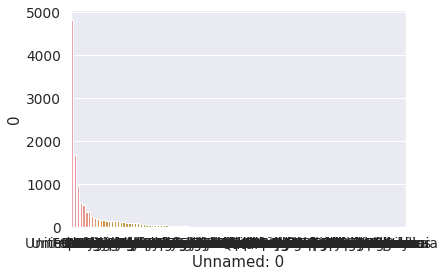

In [332]:
sns.barplot(reimported2['Unnamed: 0'],reimported2['0'])

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



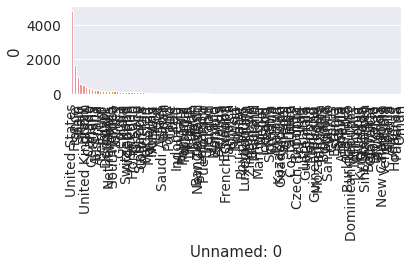

In [333]:
sns.barplot(reimported2['Unnamed: 0'],reimported2['0'])

plt.xticks(rotation=90)
plt.tight_layout()

In [334]:
clinical_trial_locations = reimported2

In [335]:
clinical_trial_locations.head()

,Unnamed: 0,0
0,United States,4811
1,France,1680
2,Spain,958
3,Italy,567
4,Brazil,509


In [336]:
clinical_trial_locations = clinical_trial_locations.rename(columns={"Unnamed: 0": "country_x", "0": "clinical_trial_frequency"})

In [337]:
clinical_trial_locations.head()

,country_x,clinical_trial_frequency
0,United States,4811
1,France,1680
2,Spain,958
3,Italy,567
4,Brazil,509


In [339]:
list_countries = clinical_trial_locations['country_x'].unique().tolist()

In [340]:
list_countries

['United States',
 'France',
 'Spain',
 'Italy',
 'Brazil',
 'United Kingdom',
 'Canada',
 'Germany',
 'China',
 'Australia',
 'Belgium',
 'Egypt',
 'Denmark',
 'Netherlands',
 'Mexico',
 'South Africa',
 'Turkey',
 'Georgia',
 'India',
 'Switzerland',
 'Argentina',
 'Sweden',
 'Hong Kong',
 'Greece',
 'Singapore',
 'Colombia',
 'Pakistan',
 'Malaysia',
 'Norway',
 'Austria',
 'Peru',
 'Israel',
 'Saudi Arabia',
 'Japan',
 'Poland',
 'Chile',
 'Iran',
 'Indonesia',
 'Hungary',
 'Romania',
 'Portugal',
 'Nigeria',
 'Ukraine',
 'Taiwan',
 'Bangladesh',
 'New Zealand',
 'Lebanon',
 'Puerto Rico',
 'Ireland',
 'Jordan',
 'Monaco',
 'Zambia',
 'Belarus',
 'Tunisia',
 'Ecuador',
 'French Guiana',
 'Jamaica',
 'Kuwait',
 'Russia',
 'Qatar',
 'Philippines',
 'Luxembourg',
 'Vietnam',
 'Zimbabwe',
 'Bahrain',
 'Thailand',
 'Martinique',
 'Nepal',
 'Iceland',
 'Kenya',
 'Slovenia',
 'Croatia',
 'Malawi',
 'Kazakhstan',
 'Guadeloupe',
 'Senegal',
 'Ghana',
 'Sudan',
 'Costa Rica',
 'Uganda',
 'Cz

In [341]:
d_country_code = {}  # To hold the country names and their ISO
for country in list_countries:
    try:
        country_data = pycountry.countries.search_fuzzy(country)
        # country_data is a list of objects of class pycountry.db.Country
        # The first item  ie at index 0 of list is best fit
        # object of class Country have an alpha_3 attribute
        country_code = country_data[0].alpha_3
        d_country_code.update({country: country_code})
    except:
        print('could not add ISO 3 code for ->', country)
        # If could not find country, make ISO code ' '
        d_country_code.update({country: ' '})

In [ ]:
# d_country_code.update({'Korea, Dem. People’s Rep.': 'KOR', 'Korea, Rep.': 'PRK', 'Lao PDR': 'LAO', 'Micronesia, Fed. Sts.': 'FSM', 'Macao SAR, China': 'MAC', 'Bahamas, The': 'BHS'})

In [342]:
print(d_country_code)

{'United States': 'USA', 'France': 'FRA', 'Spain': 'ESP', 'Italy': 'ITA', 'Brazil': 'BRA', 'United Kingdom': 'GBR', 'Canada': 'CAN', 'Germany': 'DEU', 'China': 'CHN', 'Australia': 'AUS', 'Belgium': 'BEL', 'Egypt': 'EGY', 'Denmark': 'DNK', 'Netherlands': 'NLD', 'Mexico': 'MEX', 'South Africa': 'ZAF', 'Turkey': 'TUR', 'Georgia': 'GEO', 'India': 'IND', 'Switzerland': 'CHE', 'Argentina': 'ARG', 'Sweden': 'SWE', 'Hong Kong': 'HKG', 'Greece': 'GRC', 'Singapore': 'SGP', 'Colombia': 'COL', 'Pakistan': 'PAK', 'Malaysia': 'MYS', 'Norway': 'NOR', 'Austria': 'AUT', 'Peru': 'PER', 'Israel': 'ISR', 'Saudi Arabia': 'SAU', 'Japan': 'JPN', 'Poland': 'POL', 'Chile': 'CHL', 'Iran': 'IRN', 'Indonesia': 'IDN', 'Hungary': 'HUN', 'Romania': 'ROU', 'Portugal': 'PRT', 'Nigeria': 'NGA', 'Ukraine': 'UKR', 'Taiwan': 'TWN', 'Bangladesh': 'BGD', 'New Zealand': 'NZL', 'Lebanon': 'LBN', 'Puerto Rico': 'PRI', 'Ireland': 'IRL', 'Jordan': 'JOR', 'Monaco': 'MCO', 'Zambia': 'ZMB', 'Belarus': 'BLR', 'Tunisia': 'TUN', 'Ecua

In [343]:
clinical_trial_locations.head()

,country_x,clinical_trial_frequency
0,United States,4811
1,France,1680
2,Spain,958
3,Italy,567
4,Brazil,509


In [344]:
# create a new column iso_alpha in the df
# and fill it with appropriate iso 3 code
for k, v in d_country_code.items():
    clinical_trial_locations.loc[(clinical_trial_locations['country_x'] == k), 'iso_alpha'] = v

In [345]:
clinical_trial_locations.head()  

,country_x,clinical_trial_frequency,iso_alpha
0,United States,4811,USA
1,France,1680,FRA
2,Spain,958,ESP
3,Italy,567,ITA
4,Brazil,509,BRA


In [346]:
from google.colab import files

clinical_trial_locations.to_csv('clinical_trial_locations.csv')
files.download('clinical_trial_locations.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# HEALTHCARE ACCESS ETC ... - WORLD DEV3

In [202]:
world_dev3 = pd.read_csv('world_dev2_complete.csv')

In [203]:
world_dev3.head()

,Country,Population_2000,Population_2018,Annual_Growth_2000_2018,Ages_0_to_14_2018,Ages_15_to_64_2018,Ages_65_Up_2018,Dependency_Ratio_Young_2018,Dependency_Ratio_Old_2018,Crude_Death_Rate_2018,Crude_Birth_Rate_2018,Labor_Force_Participation_Male_2000,Labor_Force_Participation_Male_2017,Labor_Force_Participation_Female_2000,Labor_Force_Participation_Female_2017,Labor_Force_Total_2000,Labor_Force_Total_2017,Labor_Force_Female_2000,Labor_Force_Female_2017,Labor_Force_Growth_2008_2017,Agriculture_Male_2000,Agriculture_Male_2017,Agriculture_Female_2000,Agriculture_Female_2017,Industry_Male_2000,Industry_Male_2017,Industry_Female_2000,Industry_Female_2017,Services_Male_2000,Services_Male_2017,Services_Female_2000,Services_Female_2017,Employment_Population_Ratio_Total_2000,Employment_Population_Ratio_Total_2017,Employment_Population_Ratio_Youth_2000,Employment_Population_Ratio_Youth_2017,Vulnerable_Employment_Male_2000,Vulnerable_Employment_Male_2017,Vulnerable_Employment_Female_2000,Vulnerable_Employment_Female_2017,Labor_Productivity_2000_2002,Labor_Productivity_2014_2017,Unemployment_Male_2000,Unemployment_Male_2017,Unemployment_Female_2000,Unemployment_Female_2017,Unemployment_Male_Youth_2000,Unemployment_Male_Youth_2017,Unemployment_Female_Youth_2000,Unemployment_Female_Youth_2017,Unemployment_Basic_Education_2014_2017,Unemployment_Intermediate_Education_2014_2017,Unemployment_Advanced_Education_2014_2017,Child_Employment_Survey_Year,Employed_Children_Total,Employed_Children_Male,Employed_Children_Female,Children_Work_Only,Children_Study_and_Work,Employment_Agriculture,Employment_Manufacturing,Employment_Services,Status_Self_Employed,Status_Wage,Status_Unpaid,GDP_Primary_1999,Government_Expenditure_Primary_2017,Government_Expenditure_Secondary_1999,Government_Expenditure_Secondary_2017,Government_Expenditure_Tertiary_1999,Government_Expenditure_Tertiary_2017,Government_Expenditure_Per_Capita_2017,Government_Expenditure_Education_2017,Trained_Teachers_Primary_2017,Trained_Teachers_Secondary_2017,Pupil_Teacher_Ratio_Primary_2017,Pupil_Teacher_Ratio_Secondary_2017,Gross_Enrollment_Ratio_Preprimary_2017,Gross_Enrollment_Ratio_Primary_2017,Gross_Enrollment_Ratio_Secondary_2017,Gross_Enrollment_Ratio_Tertiary_2017,Net_Enrollment_Rater_Primary_1999,Net_Enrollment_Rater_Primary_2017,Net_Enrollment_Rater_Secondary_1999,Net_Enrollment_Rater_Secondary_2017,Adjusted_Net_Enrollment_Rate_Primary_Male_2017,Adjusted_Net_Enrollment_Rate_Primary_Female_2017,Children_Out_Of_Primary_School_Male_2017,Children_Out_Of_Primary_School_Female_2017,Gross_Intake_Ratio_Grade_1_Male_2017,Gross_Intake_Ratio_Grade_1_Female_2017,Reaching_Grade_5_Male_1999,Reaching_Grade_5_Male_2016,Reaching_Grade_5_Female_1999,Reaching_Grade_5_Female_2016,Reaching_Last_Grade_Male_2016,Reaching_Last_Grade_Female_2016,Repeaters_Primary_Male_2017,Repeaters_Primary_Female_2017,Transition_Rate_Secondary_Male_2016,Transition_Rate_Secondary_Female_2016,Primary_Completion_Rate_Male_2017,Primary_Completion_Rate_Female_2017,Lower_Secondary_Completion_Rate_Male_2017,Lower_Secondary_Completion_Rate_Female_2017,Youth_Literacy_Rate_Male_2008_2017,Youth_Literacy_Rate_Female_2008_2017,Adult_Literacy_Rate_Male_2008_2017,Adult_Literacy_Rate_Female_2008_2017,Proficiency_Mathematics_2015,Proficiency_Reading_2015,Proficiency_Science_2015,Primary_Completion_Rate_Poorest_2008_2017,Primary_Completion_Rate_Richest_2008_2017,Primary_Completion_Rate_Male_2008_2017,Primary_Completion_Rate_Female_2008_2017,Primary_Completion_Rate_Urban_2008_2017,Primary_Completion_Rate_Rural_2008_2017,Average_Years_Schooling_Poorest_2008_2017,Average_Years_Schooling_Richest_2008_2017,Children_Out_of_School_Poorest_2008_2017,Children_Out_of_School_Richest_2008_2017,Current_Health_Expenditure_2016,Public_Health_Expenditure_2016,Out_of_Pocket_Health_Expenditure_2016,Health_Expenditure_per_Capita_2016,Health_Expenditure_Current_PPP_2016,External_Health_Expenditure_2016,Physicians_2008_2016,Nurses_and_Midwives_2008_2016,Specia

In [208]:
world_dev3_sub = world_dev3[['Country', 'Health_Expenditure_per_Capita_2016', 'Prevalence_Undernourishment_2000', 'Adult_Literacy_Rate_Female_2008_2017', 
'Labor_Force_Participation_Female_2017', 'Labor_Force_Participation_Male_2000', 'Problems_Accessing_Healthcare_Poorest_MRV', 'Employed_Children_Total', 'Teenage_Mothers_Richest_MRV', 
'Life_Expectancy_At_Birth_2017', 'Physicians_2008_2016', 'Population_2018']]

In [207]:
world_dev3.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 151 entries, 0 to 150
Data columns (total 221 columns):
 #   Column                                                      Dtype  
---  ------                                                      -----  
 0   Country                                                     object 
 1   Population_2000                                             float64
 2   Population_2018                                             float64
 3   Annual_Growth_2000_2018                                     float64
 4   Ages_0_to_14_2018                                           float64
 5   Ages_15_to_64_2018                                          float64
 6   Ages_65_Up_2018                                             float64
 7   Dependency_Ratio_Young_2018                                 float64
 8   Dependency_Ratio_Old_2018                                   float64
 9   Crude_Death_Rate_2018                                       float64
 10  Crude_Birth_R

In [ ]:
'''
ANALYSE !!! :
Health_Expenditure_per_Capita_2016   
Prevalence_Undernourishment_2000
Adult_Literacy_Rate_Female_2008_2017
Labor_Force_Participation_Female_2017
Labor_Force_Participation_Male_2000

In [ ]:
'''
add!!
Problems_Accessing_Healthcare_Poorest_MRV
Employed_Children_Total
Teenage_Mothers_Richest_MRV
Life_Expectancy_At_Birth_2017 

Physicians_2008_2016
Population_2018 
'''

In [209]:
world_dev3_sub

,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018
0,Afghanistan,57.0,46.0,18.0,49.0,83.0,94.0,9.0,9.0,64.0,0.0,37.0
1,Albania,272.0,7.0,96.0,47.0,74.0,95.0,6.0,2.0,78.0,1.0,3.0
2,Algeria,260.0,11.0,68.0,15.0,75.0,NaN,8.0,NaN,76.0,1.0,42.0
3,American Samoa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
4,Andorra,3835.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
146,Pakistan,40.0,23.0,44.0,24.0,84.0,87.0,13.0,3.0,67.0,1.0,212.0
147,Palau,1674.0,NaN,96.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0
148,Panama,1041.0,28.0,93.0,53.0,81.0,NaN,6.0,NaN,78.0,2.0,4.0
149,Papua New Guinea,55.0,NaN,58.0,46.0,73.0,NaN,NaN,NaN,66.0,0.0,9.0


In [210]:
list_countries = world_dev3_sub['Country'].unique().tolist()

In [211]:
list_countries

['Afghanistan',
 'Albania',
 'Algeria',
 'American Samoa',
 'Andorra',
 'Angola',
 'Antigua and Barbuda',
 'Argentina',
 'Armenia',
 'Aruba',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas, The',
 'Bahrain',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bermuda',
 'Bhutan',
 'Bolivia',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cabo Verde',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cayman Islands',
 'Central African Republic',
 'Chad',
 'Channel Islands',
 'Chile',
 'China',
 'Hong Kong SAR, China',
 'Macao SAR, China',
 'Colombia',
 'Comoros',
 'Congo, Dem. Rep.',
 'Congo, Rep.',
 'Costa Rica',
 "Cote d'Ivoire",
 'Croatia',
 'Cuba',
 'Curacao',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Djibouti',
 'Dominica',
 'Dominican Republic',
 'Ecuador',
 'Egypt, Arab Rep.',
 'El Salvador',
 'Equatorial Guinea',
 'Eritrea',
 'Estonia',
 'Eswatini',
 'Ethiopia',
 'Faroe Islands',
 'Fiji',
 'F

In [ ]:
# https://opensource.com/article/20/4/python-map-covid-19

In [212]:
d_country_code = {}  # To hold the country names and their ISO
for country in list_countries:
    try:
        country_data = pycountry.countries.search_fuzzy(country)
        # country_data is a list of objects of class pycountry.db.Country
        # The first item  ie at index 0 of list is best fit
        # object of class Country have an alpha_3 attribute
        country_code = country_data[0].alpha_3
        d_country_code.update({country: country_code})
    except:
        print('could not add ISO 3 code for ->', country)
        # If could not find country, make ISO code ' '
        d_country_code.update({country: ' '})

could not add ISO 3 code for -> Bahamas, The
could not add ISO 3 code for -> Channel Islands
could not add ISO 3 code for -> Hong Kong SAR, China
could not add ISO 3 code for -> Macao SAR, China
could not add ISO 3 code for -> Congo, Dem. Rep.
could not add ISO 3 code for -> Congo, Rep.
could not add ISO 3 code for -> Egypt, Arab Rep.
could not add ISO 3 code for -> Gambia, The
could not add ISO 3 code for -> Iran, Islamic Rep.
could not add ISO 3 code for -> Korea, Dem. People’s Rep.
could not add ISO 3 code for -> Korea, Rep.
could not add ISO 3 code for -> Lao PDR
could not add ISO 3 code for -> Micronesia, Fed. Sts.


In [213]:
d_country_code.update({'Korea, Dem. People’s Rep.': 'KOR', 'Lao PDR': 'LAO', 'Bahamas, The': 'BHS', 'Hong Kong SAR, China': 'HKG', 'Congo, Dem. Rep.': 'COD', 'Micronesia, Fed. Sts.': 'FSM', 
                       'Congo, Rep.': 'COG', 'Egypt, Arab Rep.': 'EGY', 'Gambia, The': 'GMB',
                       'Iran, Islamic Rep.': 'IRN', 'Korea, Rep.': 'PRK'})

In [ ]:
# d_country_code.update({'Korea Rep.': 'KOR', 'Democratic Republic of the Congo': 'COD', 'Hong Kong SAR China': 'HKG', 'DR Congo': 'COD', 'Micronesia (Federated States of)': 'FSM'})

In [ ]:
#d_country_code.update({'South Korea': 'KOR', 'Lao PDR': 'LAO', 'China (Hong Kong SAR)': 'HKG', 'DR Congo': 'COD', 'Guinea Bissau': 'GNB', 'Lao PDR': 'LAO', 'Macedonia (TFYR)': 'MKD', 
# 'Micronesia (Federated States of)': 'FSM', 'Swaziland': 'SWZ'})

In [214]:
print(d_country_code)

{'Afghanistan': 'AFG', 'Albania': 'ALB', 'Algeria': 'DZA', 'American Samoa': 'ASM', 'Andorra': 'AND', 'Angola': 'AGO', 'Antigua and Barbuda': 'ATG', 'Argentina': 'ARG', 'Armenia': 'ARM', 'Aruba': 'ABW', 'Australia': 'AUS', 'Austria': 'AUT', 'Azerbaijan': 'AZE', 'Bahamas, The': 'BHS', 'Bahrain': 'BHR', 'Bangladesh': 'BGD', 'Barbados': 'BRB', 'Belarus': 'BLR', 'Belgium': 'BEL', 'Belize': 'BLZ', 'Benin': 'BEN', 'Bermuda': 'BMU', 'Bhutan': 'BTN', 'Bolivia': 'BOL', 'Bosnia and Herzegovina': 'BIH', 'Botswana': 'BWA', 'Brazil': 'BRA', 'Brunei Darussalam': 'BRN', 'Bulgaria': 'BGR', 'Burkina Faso': 'BFA', 'Burundi': 'BDI', 'Cabo Verde': 'CPV', 'Cambodia': 'KHM', 'Cameroon': 'CMR', 'Canada': 'CAN', 'Cayman Islands': 'CYM', 'Central African Republic': 'CAF', 'Chad': 'TCD', 'Channel Islands': ' ', 'Chile': 'CHL', 'China': 'CHN', 'Hong Kong SAR, China': 'HKG', 'Macao SAR, China': ' ', 'Colombia': 'COL', 'Comoros': 'COM', 'Congo, Dem. Rep.': 'COD', 'Congo, Rep.': 'COG', 'Costa Rica': 'CRI', "Cote d'

In [ ]:
# Serbia & Montenegro -> SRB and MNE !!

In [215]:
world_dev3_sub.head()

,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018
0,Afghanistan,57.0,46.0,18.0,49.0,83.0,94.0,9.0,9.0,64.0,0.0,37.0
1,Albania,272.0,7.0,96.0,47.0,74.0,95.0,6.0,2.0,78.0,1.0,3.0
2,Algeria,260.0,11.0,68.0,15.0,75.0,NaN,8.0,NaN,76.0,1.0,42.0
3,American Samoa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
4,Andorra,3835.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,0.0


In [216]:
# create a new column iso_alpha in the df
# and fill it with appropriate iso 3 code
for k, v in d_country_code.items():
    world_dev3_sub.loc[(world_dev3_sub['Country'] == k), 'iso_alpha'] = v

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [217]:
world_dev3_sub.head()

,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,iso_alpha
0,Afghanistan,57.0,46.0,18.0,49.0,83.0,94.0,9.0,9.0,64.0,0.0,37.0,AFG
1,Albania,272.0,7.0,96.0,47.0,74.0,95.0,6.0,2.0,78.0,1.0,3.0,ALB
2,Algeria,260.0,11.0,68.0,15.0,75.0,NaN,8.0,NaN,76.0,1.0,42.0,DZA
3,American Samoa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,ASM
4,Andorra,3835.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,0.0,AND


## NUTRITION & HEALTH - fat percentage etc... next time .... !

# NUTRITION

In [ ]:
nutrition_health = pd.read_csv('health_nutrition_population_stats_preview.csv')

In [ ]:
nutrition_health.head()

,Country Name,Country Code,Indicator Name,Indicator Code,Year 1960,Year 1961,Year 1962,Year 1963,Year 1964,Year 1965,Year 1966,Year 1967,Year 1968,Year 1969,Year 1970,Year 1971,Year 1972,Year 1973,Year 1974,Year 1975,Year 1976,Year 1977,Year 1978,Year 1979,Year 1980,Year 1981,Year 1982,Year 1983,Year 1984,Year 1985,Year 1986,Year 1987,Year 1988,Year 1989,Year 1990,Year 1991,Year 1992,Year 1993,Year 1994,Year 1995,Year 1996,Year 1997,Year 1998,Year 1999,Year 2000,Year 2001,Year 2002,Year 2003,Year 2004,Year 2005,Year 2006,Year 2007,Year 2008,Year 2009,Year 2010,Year 2011,Year 2012,Year 2013,Year 2014,Year 2015,Year 2016,Year 2017
0,Arab World,ARB,% of females ages 15-49 having comprehensive c...,SH.HIV.KNOW.FE.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Arab World,ARB,% of males ages 15-49 having comprehensive cor...,SH.HIV.KNOW.MA.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Arab World,ARB,"Adolescent fertility rate (births per 1,000 wo...",SP.ADO.TFRT,134.22,134.84,135.57,135.44,135.27,134.95,134.23,133.36,130.87,128.41,126.08,123.84,121.76,119.63,117.47,115.24,112.92,110.52,106.66,102.86,99.14,95.52,91.96,88.19,84.4,80.58,76.72,72.84,71.57,70.32,69.47,68.21,67.31,65.26,63.18,60.91,58.77,56.59,55.74,54.93,54.17,53.31,52.49,52.03,51.63,51.27,50.88,50.54,50.32,50.1,49.9,49.72,49.54,49.11,48.65,48.11,47.44,NaN
3,Arab World,ARB,Adults (ages 15+) and children (0-14 years) li...,SH.HIV.TOTL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Arab World,ARB,Adults (ages 15+) and children (ages 0-14) new...,SH.HIV.INCD.TL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# WORLD DEVELOPMENT - DOWNLOAD COMPLETE! INVESTIGATE PARLIAMENTS ELECTRICITY & CO2!

In [ ]:
import pandas as pd

In [155]:
world_development = pd.read_csv('development_indicators.csv')

In [156]:
world_development.head()

,Country,Population,Surface_Area,Population_Density,Gross_National_Income,Gross_National_Income_Per_Capita,Purchasing_Power_Parity,Purchasing_Power_Parity_Per_Capita,Gross_Domestic_Product,Gross_Domestic_Product_Per_Capita,Percentage_Share_Income_Or_Consumption,Prevalence_Child_Malnutrition,Maternal_Mortality_Ratio,Under_Five_Mortality_Rate,Incidence_HIV,Incidence_Tuberculosis,Mortality_Road_Injury,Primary_Completion_Rate,Contributing_Family_Workers_Male,Contributing_Family_Workers_Female,Labor_Productivity,Safely_Managed_Drinking_Water_Services,Safely_Managed_Sanitation_Services,Access_To_Electricity,Renewable_Energy_Consumption,Expenditures_for_Research_and_Development,Urban_Population_Living_In_Slums,Ambient_Air_Pollution,Adjusted_Net_Savings,Carbon_Dioxide_Emissions,Nationally_Protected_Areas,Intentional_Homicides,Internet_Use,Life_Expectancy_At_Birth_Male,Life_Expectancy_At_Birth_Female,Married_By_Age_18,Employment_Male,Employment_Female,Firms_With_Female,Women_In_Parliaments,Is_Nondiscrimination_Clause
0,Afghanistan,36.0,653.0,54.0,2.0,57.0,71.0,2.0,3.0,0.0,NaN,5.0,396.0,62.0,0.0,189.0,15.0,NaN,20.0,58.0,-3.0,NaN,NaN,84.0,18.0,NaN,63.0,63.0,-29.0,0.0,0.0,6.0,2.0,62.0,65.0,35.0,33.0,4.0,2.0,28.0,False
1,Albania,3.0,29.0,15.0,12.0,432.0,35.0,1212.0,4.0,4.0,9.0,NaN,29.0,9.0,NaN,16.0,14.0,16.0,23.0,4.0,NaN,69.0,65.0,1.0,39.0,NaN,NaN,15.0,7.0,2.0,14.0,2.0,66.0,76.0,9.0,NaN,40.0,42.0,13.0,28.0,True
2,Algeria,41.0,2382.0,17.0,164.0,396.0,622.0,155.0,2.0,0.0,9.0,12.0,14.0,24.0,0.0,7.0,24.0,15.0,1.0,2.0,4.0,NaN,19.0,99.0,0.0,NaN,NaN,37.0,19.0,4.0,7.0,1.0,43.0,75.0,77.0,3.0,69.0,71.0,NaN,26.0,True
3,American Samoa,0.0,0.0,278.0,NaN,NaN,NaN,NaN,-3.0,-3.0,NaN,NaN,NaN,NaN,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,4.0,NaN,NaN,9.0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
4,Andorra,0.0,1.0,164.0,NaN,NaN,NaN,NaN,2.0,2.0,NaN,NaN,NaN,3.0,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,20.0,NaN,NaN,2.0,NaN,6.0,27.0,NaN,98.0,NaN,NaN,NaN,NaN,NaN,NaN,32.0,False


In [157]:
world_development_use = world_development[['Country', 'Gross_Domestic_Product_Per_Capita', 'Prevalence_Child_Malnutrition', 'Under_Five_Mortality_Rate', 'Safely_Managed_Drinking_Water_Services', 'Access_To_Electricity', 'Renewable_Energy_Consumption', 'Ambient_Air_Pollution', 'Carbon_Dioxide_Emissions', 'Internet_Use', 'Married_By_Age_18', 'Women_In_Parliaments']]

In [ ]:
# world_development.columns = world_development.columns.str.replace(' ', '_')

In [ ]:
''' 
RELEVANT!!!:
Access to electricity
Prevalence Child Malnutrition


tryout, for fun:
women in parliaments ;)
Carbon Dioxide Emissions




In [159]:
world_development_use.head()

,Country,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments
0,Afghanistan,0.0,5.0,62.0,NaN,84.0,18.0,63.0,0.0,2.0,35.0,28.0
1,Albania,4.0,NaN,9.0,69.0,1.0,39.0,15.0,2.0,66.0,NaN,28.0
2,Algeria,0.0,12.0,24.0,NaN,99.0,0.0,37.0,4.0,43.0,3.0,26.0
3,American Samoa,-3.0,NaN,NaN,NaN,NaN,1.0,4.0,NaN,NaN,NaN,NaN
4,Andorra,2.0,NaN,3.0,NaN,1.0,20.0,2.0,6.0,98.0,NaN,32.0


In [158]:
world_development_use.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227 entries, 0 to 226
Data columns (total 12 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   Country                                 227 non-null    object 
 1   Gross_Domestic_Product_Per_Capita       207 non-null    float64
 2   Prevalence_Child_Malnutrition           126 non-null    float64
 3   Under_Five_Mortality_Rate               191 non-null    float64
 4   Safely_Managed_Drinking_Water_Services  99 non-null     float64
 5   Access_To_Electricity                   225 non-null    float64
 6   Renewable_Energy_Consumption            208 non-null    float64
 7   Ambient_Air_Pollution                   206 non-null    float64
 8   Carbon_Dioxide_Emissions                213 non-null    float64
 9   Internet_Use                            215 non-null    float64
 10  Married_By_Age_18                       96 non-null     float6

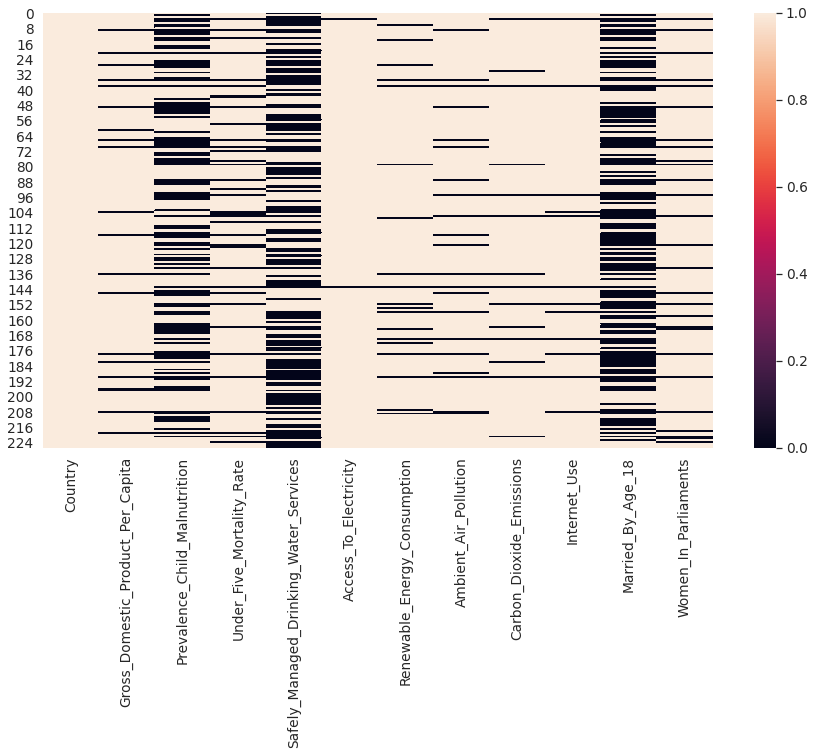

In [160]:
plt.figure(figsize=(15,8))
sns.heatmap(world_development_use.notna())
plt.show()

In [186]:
world_development_use.shape

(227, 12)

In [183]:
list_countries = world_development_use['Country'].unique().tolist()

In [184]:
list_countries

['Afghanistan',
 'Albania',
 'Algeria',
 'American Samoa',
 'Andorra',
 'Angola',
 'Antigua and Barbuda',
 'Argentina',
 'Armenia',
 'Aruba',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas, The',
 'Bahrain',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bermuda',
 'Bhutan',
 'Bolivia',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cabo Verde',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cayman Islands',
 'Central African Republic',
 'Chad',
 'Channel Islands',
 'Chile',
 'China',
 'Colombia',
 'Comoros',
 'Democratic Republic of the Congo',
 'Congo Rep.',
 'Costa Rica',
 "Cote d'Ivoire",
 'Croatia',
 'Cuba',
 'Curacao',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Djibouti',
 'Dominica',
 'Dominican Republic',
 'East Asia & Pacific',
 'Ecuador',
 'Egypt Arab Rep.',
 'El Salvador',
 'Equatorial Guinea',
 'Eritrea',
 'Estonia',
 'Eswatini',
 'Ethiopia',
 'Europe & Central Asia',
 'Faroe Isla

In [ ]:
pip install pycountry

     |████████████████████████████████| 10.1MB 7.4MB/s 
  Created wheel for pycountry: filename=pycountry-20.7.3-py2.py3-none-any.whl size=10746865 sha256=e203858f9f4ad62b549b10235a16ff187bfed1ba9c30bdfec62793d333c1328d
  Stored in directory: /root/.cache/pip/wheels/33/4e/a6/be297e6b83567e537bed9df4a93f8590ec01c1acfbcd405348
Successfully built pycountry


In [ ]:
import pycountry
import plotly.express as px
import pandas as pd

In [ ]:
# https://opensource.com/article/20/4/python-map-covid-19

In [185]:
d_country_code = {}  # To hold the country names and their ISO
for country in list_countries:
    try:
        country_data = pycountry.countries.search_fuzzy(country)
        # country_data is a list of objects of class pycountry.db.Country
        # The first item  ie at index 0 of list is best fit
        # object of class Country have an alpha_3 attribute
        country_code = country_data[0].alpha_3
        d_country_code.update({country: country_code})
    except:
        print('could not add ISO 3 code for ->', country)
        # If could not find country, make ISO code ' '
        d_country_code.update({country: ' '})

could not add ISO 3 code for -> Bahamas, The
could not add ISO 3 code for -> Channel Islands
could not add ISO 3 code for -> Democratic Republic of the Congo
could not add ISO 3 code for -> Congo Rep.
could not add ISO 3 code for -> East Asia & Pacific
could not add ISO 3 code for -> Egypt Arab Rep.
could not add ISO 3 code for -> Europe & Central Asia
could not add ISO 3 code for -> Gambia The
could not add ISO 3 code for -> High income
could not add ISO 3 code for -> Hong Kong SAR China
could not add ISO 3 code for -> Iran Islamic Rep.
could not add ISO 3 code for -> Korea Rep.
could not add ISO 3 code for -> Latin America & Caribbean
could not add ISO 3 code for -> Low income
could not add ISO 3 code for -> Lower middle income
could not add ISO 3 code for -> Macao SAR China
could not add ISO 3 code for -> Macedonia FYR
could not add ISO 3 code for -> Micronesia Fed. Sts.
could not add ISO 3 code for -> Middle East & North Africa
could not add ISO 3 code for -> North America
could no

In [187]:
d_country_code.update({'Korea Rep.': 'KOR', 'Democratic Republic of the Congo': 'COD', 'Hong Kong SAR China': 'HKG', 'DR Congo': 'COD', 'Micronesia (Federated States of)': 'FSM'})

In [ ]:
# d_country_code.update({'South Korea': 'KOR', 'Lao PDR': 'LAO', 'China (Hong Kong SAR)': 'HKG', 'DR Congo': 'COD', 'Guinea Bissau': 'GNB', 'Lao PDR': 'LAO', 'Macedonia (TFYR)': 'MKD', 'Micronesia (Federated States of)': 'FSM', 'Swaziland': 'SWZ'})

In [188]:
print(d_country_code)

{'Afghanistan': 'AFG', 'Albania': 'ALB', 'Algeria': 'DZA', 'American Samoa': 'ASM', 'Andorra': 'AND', 'Angola': 'AGO', 'Antigua and Barbuda': 'ATG', 'Argentina': 'ARG', 'Armenia': 'ARM', 'Aruba': 'ABW', 'Australia': 'AUS', 'Austria': 'AUT', 'Azerbaijan': 'AZE', 'Bahamas, The': ' ', 'Bahrain': 'BHR', 'Bangladesh': 'BGD', 'Barbados': 'BRB', 'Belarus': 'BLR', 'Belgium': 'BEL', 'Belize': 'BLZ', 'Benin': 'BEN', 'Bermuda': 'BMU', 'Bhutan': 'BTN', 'Bolivia': 'BOL', 'Bosnia and Herzegovina': 'BIH', 'Botswana': 'BWA', 'Brazil': 'BRA', 'Brunei Darussalam': 'BRN', 'Bulgaria': 'BGR', 'Burkina Faso': 'BFA', 'Burundi': 'BDI', 'Cabo Verde': 'CPV', 'Cambodia': 'KHM', 'Cameroon': 'CMR', 'Canada': 'CAN', 'Cayman Islands': 'CYM', 'Central African Republic': 'CAF', 'Chad': 'TCD', 'Channel Islands': ' ', 'Chile': 'CHL', 'China': 'CHN', 'Colombia': 'COL', 'Comoros': 'COM', 'Democratic Republic of the Congo': 'COD', 'Congo Rep.': ' ', 'Costa Rica': 'CRI', "Cote d'Ivoire": 'CIV', 'Croatia': 'HRV', 'Cuba': 'CU

In [ ]:
# Serbia & Montenegro -> SRB and MNE !!

In [189]:
world_development_use.head()

,Country,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments
0,Afghanistan,0.0,5.0,62.0,NaN,84.0,18.0,63.0,0.0,2.0,35.0,28.0
1,Albania,4.0,NaN,9.0,69.0,1.0,39.0,15.0,2.0,66.0,NaN,28.0
2,Algeria,0.0,12.0,24.0,NaN,99.0,0.0,37.0,4.0,43.0,3.0,26.0
3,American Samoa,-3.0,NaN,NaN,NaN,NaN,1.0,4.0,NaN,NaN,NaN,NaN
4,Andorra,2.0,NaN,3.0,NaN,1.0,20.0,2.0,6.0,98.0,NaN,32.0


In [191]:
# create a new column iso_alpha in the df
# and fill it with appropriate iso 3 code
for k, v in d_country_code.items():
    world_development_use.loc[(world_development_use['Country'] == k), 'iso_alpha'] = v

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [192]:
world_development_use.head()

,Country,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,iso_alpha
0,Afghanistan,0.0,5.0,62.0,NaN,84.0,18.0,63.0,0.0,2.0,35.0,28.0,AFG
1,Albania,4.0,NaN,9.0,69.0,1.0,39.0,15.0,2.0,66.0,NaN,28.0,ALB
2,Algeria,0.0,12.0,24.0,NaN,99.0,0.0,37.0,4.0,43.0,3.0,26.0,DZA
3,American Samoa,-3.0,NaN,NaN,NaN,NaN,1.0,4.0,NaN,NaN,NaN,NaN,ASM
4,Andorra,2.0,NaN,3.0,NaN,1.0,20.0,2.0,6.0,98.0,NaN,32.0,AND


## SAFELY MANAGED DRINKING WATER

In [ ]:
world_dev_complete1 = pd.read_csv('data1.csv')

In [ ]:
world_dev_complete1.head()

,Country,Population,Surface_Area,Population_Density,Gross_National_Income,Gross_National_Income_Per_Capita,Purchasing_Power_Parity,Purchasing_Power_Parity_Per_Capita,Gross_Domestic_Product,Gross_Domestic_Product_Per_Capita,Percentage_Share_Income_Or_Consumption,Prevalence_Child_Malnutrition,Maternal_Mortality_Ratio,Under_Five_Mortality_Rate,Incidence_HIV,Incidence_Tuberculosis,Mortality_Road_Injury,Primary_Completion_Rate,Contributing_Family_Workers_Male,Contributing_Family_Workers_Female,Labor_Productivity,Safely_Managed_Drinking_Water_Services,Safely_Managed_Sanitation_Services,Access_To_Electricity,Renewable_Energy_Consumption,Expenditures_for_Research_and_Development,Urban_Population_Living_In_Slums,Ambient_Air_Pollution,Adjusted_Net_Savings,Carbon_Dioxide_Emissions,Nationally_Protected_Areas,Intentional_Homicides,Internet_Use,Life_Expectancy_At_Birth_Male,Life_Expectancy_At_Birth_Female,Married_By_Age_18,Employment_Male,Employment_Female,Firms_With_Female,Women_In_Parliaments,Is_Nondiscrimination_Clause
0,Afghanistan,36.0,653.0,54.0,2.0,57.0,71.0,2.0,3.0,0.0,NaN,5.0,396.0,62.0,0.0,189.0,15.0,NaN,20.0,58.0,-3.0,NaN,NaN,84.0,18.0,NaN,63.0,63.0,-29.0,0.0,0.0,6.0,2.0,62.0,65.0,35.0,33.0,4.0,2.0,28.0,False
1,Albania,3.0,29.0,15.0,12.0,432.0,35.0,1212.0,4.0,4.0,9.0,NaN,29.0,9.0,NaN,16.0,14.0,16.0,23.0,4.0,NaN,69.0,65.0,1.0,39.0,NaN,NaN,15.0,7.0,2.0,14.0,2.0,66.0,76.0,9.0,NaN,40.0,42.0,13.0,28.0,True
2,Algeria,41.0,2382.0,17.0,164.0,396.0,622.0,155.0,2.0,0.0,9.0,12.0,14.0,24.0,0.0,7.0,24.0,15.0,1.0,2.0,4.0,NaN,19.0,99.0,0.0,NaN,NaN,37.0,19.0,4.0,7.0,1.0,43.0,75.0,77.0,3.0,69.0,71.0,NaN,26.0,True
3,American Samoa,0.0,0.0,278.0,NaN,NaN,NaN,NaN,-3.0,-3.0,NaN,NaN,NaN,NaN,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,4.0,NaN,NaN,9.0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
4,Andorra,0.0,1.0,164.0,NaN,NaN,NaN,NaN,2.0,2.0,NaN,NaN,NaN,3.0,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,20.0,NaN,NaN,2.0,NaN,6.0,27.0,NaN,98.0,NaN,NaN,NaN,NaN,NaN,NaN,32.0,False


In [ ]:
world_dev_complete1.shape

(227, 41)

In [ ]:
world_dev_cool = world_dev_complete1[['Country', 'Gross_National_Income_Per_Capita', 'Gross_Domestic_Product_Per_Capita', 'Prevalence_Child_Malnutrition', 'Under_Five_Mortality_Rate', 'Safely_Managed_Drinking_Water_Services', 'Access_To_Electricity', 'Women_In_Parliaments', 'Internet_Use']]

NameError: ignored

## WORD DEV2

In [ ]:
world_dev_complete2 = pd.read_csv('world_dev_complete2_sub.csv')

In [ ]:
world_dev_complete2.head()

,Unnamed: 0,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,iso_alpha
0,0,Afghanistan,57.0,46.0,18.0,49.0,83.0,AFG
1,1,Albania,272.0,7.0,96.0,47.0,74.0,ALB
2,2,Algeria,260.0,11.0,68.0,15.0,75.0,DZA
3,3,American Samoa,NaN,NaN,NaN,NaN,NaN,ASM
4,4,Andorra,3835.0,NaN,NaN,NaN,NaN,AND


In [ ]:
world_dev_complete2.shape

(151, 8)

In [ ]:
world_dev_complete2.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 151 entries, 0 to 150
Data columns (total 221 columns):
 #   Column                                                      Dtype  
---  ------                                                      -----  
 0   Country                                                     object 
 1   Population_2000                                             float64
 2   Population_2018                                             float64
 3   Annual_Growth_2000_2018                                     float64
 4   Ages_0_to_14_2018                                           float64
 5   Ages_15_to_64_2018                                          float64
 6   Ages_65_Up_2018                                             float64
 7   Dependency_Ratio_Young_2018                                 float64
 8   Dependency_Ratio_Old_2018                                   float64
 9   Crude_Death_Rate_2018                                       float64
 10  Crude_Birth_R

In [ ]:
'''
ANALYSE !!! :
Health_Expenditure_per_Capita_2016   
Prevalence_Undernourishment_2000
Adult_Literacy_Rate_Female_2008_2017
Labor_Force_Participation_Female_2017
Labor_Force_Participation_Male_2000

In [ ]:
'''
add!!
Problems_Accessing_Healthcare_Poorest_MRV
Employed_Children_Total
Teenage_Mothers_Richest_MRV
Life_Expectancy_At_Birth_2017 

Physicians_2008_2016
Population_2018 
'''

In [ ]:
world_dev_complete2_sub = world_dev_complete2[['Country', 'Health_Expenditure_per_Capita_2016', 'Prevalence_Undernourishment_2000', 'Adult_Literacy_Rate_Female_2008_2017', 'Labor_Force_Participation_Female_2017', 'Labor_Force_Participation_Male_2000']]

In [ ]:
world_dev_complete2_MORE_sub = world_dev_complete2[['Problems_Accessing_Healthcare_Poorest_MRV', 'Employed_Children_Total', 'Teenage_Mothers_Richest_MRV', 'Life_Expectancy_At_Birth_2017', 'Physicians_2008_2016', 'Population_2018']]

KeyError: ignored

In [ ]:
world_dev_complete2.Adult_Literacy_Rate_Female_2008_2017.isna().sum()

48

In [ ]:
world_dev_complete2.Health_Expenditure_per_Capita_2016.isna().sum()

20

In [ ]:
world_dev_complete2.Prevalence_Undernourishment_2000.isna().sum()

33

In [ ]:
world_dev_complete2.Annual_Growth_2000_2018.isna().sum()

1

In [ ]:
world_dev_complete2.Annual_Growth_2000_2018.value_counts(dropna=False)

 1.0    54
 2.0    30
 0.0    30
 3.0    23
-1.0     6
 4.0     6
 NaN     1
 5.0     1
Name: Annual_Growth_2000_2018, dtype: int64

In [ ]:
world_dev_complete2.Overweight_Male_2008_2016.isna().sum()

77

In [ ]:
world_dev_complete2.Overweight_Female_2008_2016.isna().sum()

77

In [ ]:
world_dev_complete2.Labor_Force_Participation_Male_2000.isna().sum()

20

In [ ]:
world_dev_complete2.Labor_Force_Participation_Male_2017.isna().sum()

20

In [ ]:
world_dev_complete2.Labor_Force_Participation_Female_2000.isna().sum()

20

In [ ]:
world_dev_complete2.Labor_Force_Participation_Female_2017.isna().sum()

20

In [ ]:
world_dev_complete2_sub.head()

,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000
0,Afghanistan,57.0,46.0,18.0,49.0,83.0
1,Albania,272.0,7.0,96.0,47.0,74.0
2,Algeria,260.0,11.0,68.0,15.0,75.0
3,American Samoa,NaN,NaN,NaN,NaN,NaN
4,Andorra,3835.0,NaN,NaN,NaN,NaN


In [ ]:
world_dev_complete2_sub

NameError: ignored

## ADDING THE WORLD MAP (PYCOUNTRY & PYPLOT)

In [ ]:
pip install pycountry

     |████████████████████████████████| 10.1MB 3.2MB/s 
  Created wheel for pycountry: filename=pycountry-20.7.3-py2.py3-none-any.whl size=10746865 sha256=e0a74bda8469c15510ff11897a1eea58c0a8e3c75999ed2afcc2f19fcc98f9ea
  Stored in directory: /root/.cache/pip/wheels/33/4e/a6/be297e6b83567e537bed9df4a93f8590ec01c1acfbcd405348
Successfully built pycountry


In [ ]:
import pycountry
import plotly.express as px
import pandas as pd

In [ ]:
# https://opensource.com/article/20/4/python-map-covid-19

In [ ]:
list_countries = world_dev_complete2_sub['Country'].unique().tolist()

In [ ]:
list_countries

['Afghanistan',
 'Albania',
 'Algeria',
 'American Samoa',
 'Andorra',
 'Angola',
 'Antigua and Barbuda',
 'Argentina',
 'Armenia',
 'Aruba',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas, The',
 'Bahrain',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bermuda',
 'Bhutan',
 'Bolivia',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cabo Verde',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cayman Islands',
 'Central African Republic',
 'Chad',
 'Channel Islands',
 'Chile',
 'China',
 'Hong Kong SAR, China',
 'Macao SAR, China',
 'Colombia',
 'Comoros',
 'Congo, Dem. Rep.',
 'Congo, Rep.',
 'Costa Rica',
 "Cote d'Ivoire",
 'Croatia',
 'Cuba',
 'Curacao',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Djibouti',
 'Dominica',
 'Dominican Republic',
 'Ecuador',
 'Egypt, Arab Rep.',
 'El Salvador',
 'Equatorial Guinea',
 'Eritrea',
 'Estonia',
 'Eswatini',
 'Ethiopia',
 'Faroe Islands',
 'Fiji',
 'F

In [ ]:
d_country_code = {}  # To hold the country names and their ISO
for country in list_countries:
    try:
        country_data = pycountry.countries.search_fuzzy(country)
        # country_data is a list of objects of class pycountry.db.Country
        # The first item  ie at index 0 of list is best fit
        # object of class Country have an alpha_3 attribute
        country_code = country_data[0].alpha_3
        d_country_code.update({country: country_code})
    except:
        print('could not add ISO 3 code for ->', country)
        # If could not find country, make ISO code ' '
        d_country_code.update({country: ' '})

could not add ISO 3 code for -> Bahamas, The
could not add ISO 3 code for -> Channel Islands
could not add ISO 3 code for -> Hong Kong SAR, China
could not add ISO 3 code for -> Macao SAR, China
could not add ISO 3 code for -> Congo, Dem. Rep.
could not add ISO 3 code for -> Congo, Rep.
could not add ISO 3 code for -> Egypt, Arab Rep.
could not add ISO 3 code for -> Gambia, The
could not add ISO 3 code for -> Iran, Islamic Rep.
could not add ISO 3 code for -> Korea, Dem. People’s Rep.
could not add ISO 3 code for -> Korea, Rep.
could not add ISO 3 code for -> Lao PDR
could not add ISO 3 code for -> Micronesia, Fed. Sts.


In [ ]:
d_country_code.update({'Korea, Dem. People’s Rep.': 'KOR', 'Korea, Rep.': 'PRK', 'Lao PDR': 'LAO', 'Micronesia, Fed. Sts.': 'FSM', 'Macao SAR, China': 'MAC', 'Bahamas, The': 'BHS'})

In [ ]:
print(d_country_code)

{'Afghanistan': 'AFG', 'Albania': 'ALB', 'Algeria': 'DZA', 'American Samoa': 'ASM', 'Andorra': 'AND', 'Angola': 'AGO', 'Antigua and Barbuda': 'ATG', 'Argentina': 'ARG', 'Armenia': 'ARM', 'Aruba': 'ABW', 'Australia': 'AUS', 'Austria': 'AUT', 'Azerbaijan': 'AZE', 'Bahamas, The': 'BHS', 'Bahrain': 'BHR', 'Bangladesh': 'BGD', 'Barbados': 'BRB', 'Belarus': 'BLR', 'Belgium': 'BEL', 'Belize': 'BLZ', 'Benin': 'BEN', 'Bermuda': 'BMU', 'Bhutan': 'BTN', 'Bolivia': 'BOL', 'Bosnia and Herzegovina': 'BIH', 'Botswana': 'BWA', 'Brazil': 'BRA', 'Brunei Darussalam': 'BRN', 'Bulgaria': 'BGR', 'Burkina Faso': 'BFA', 'Burundi': 'BDI', 'Cabo Verde': 'CPV', 'Cambodia': 'KHM', 'Cameroon': 'CMR', 'Canada': 'CAN', 'Cayman Islands': 'CYM', 'Central African Republic': 'CAF', 'Chad': 'TCD', 'Channel Islands': ' ', 'Chile': 'CHL', 'China': 'CHN', 'Hong Kong SAR, China': ' ', 'Macao SAR, China': 'MAC', 'Colombia': 'COL', 'Comoros': 'COM', 'Congo, Dem. Rep.': ' ', 'Congo, Rep.': ' ', 'Costa Rica': 'CRI', "Cote d'Ivoi

In [ ]:
world_dev_complete2_sub.head()

,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000
0,Afghanistan,57.0,46.0,18.0,49.0,83.0
1,Albania,272.0,7.0,96.0,47.0,74.0
2,Algeria,260.0,11.0,68.0,15.0,75.0
3,American Samoa,NaN,NaN,NaN,NaN,NaN
4,Andorra,3835.0,NaN,NaN,NaN,NaN


In [ ]:
# create a new column iso_alpha in the df
# and fill it with appropriate iso 3 code
for k, v in d_country_code.items():
    world_dev_complete2_sub.loc[(world_dev_complete2_sub['Country'] == k), 'iso_alpha'] = v

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
world_dev_complete2_sub.head()  

,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,iso_alpha
0,Afghanistan,57.0,46.0,18.0,49.0,83.0,AFG
1,Albania,272.0,7.0,96.0,47.0,74.0,ALB
2,Algeria,260.0,11.0,68.0,15.0,75.0,DZA
3,American Samoa,NaN,NaN,NaN,NaN,NaN,ASM
4,Andorra,3835.0,NaN,NaN,NaN,NaN,AND


In [ ]:
from google.colab import files

world_dev_complete2_sub.to_csv('world_dev_complete2_sub.csv')
files.download('world_dev_complete2_sub.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
world_dev_complete2_sub.head()

,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,iso_alpha
0,Afghanistan,57.0,46.0,18.0,49.0,83.0,AFG
1,Albania,272.0,7.0,96.0,47.0,74.0,ALB
2,Algeria,260.0,11.0,68.0,15.0,75.0,DZA
3,American Samoa,NaN,NaN,NaN,NaN,NaN,ASM
4,Andorra,3835.0,NaN,NaN,NaN,NaN,AND


In [ ]:
fig = px.choropleth(data_frame = world_dev_complete2_sub,
                    locations= "iso_alpha",
                    color= "Health_Expenditure_per_Capita_2016",  # value in column 'Confirmed' determines color
                    hover_name= "Country",
                    color_continuous_scale= 'BuPu',  #  color scale red, yellow green   # RdYlGn_r
                    #plt.clim(0, 252)
                    # animation_frame= "Date"
                    )

In [ ]:
fig.show() # Health_Expenditure_per_Capita_2016

In [ ]:
fig = px.choropleth(data_frame = world_dev_complete2_sub,
                    locations= "iso_alpha",
                    color= "Prevalence_Undernourishment_2000",  # value in column 'Confirmed' determines color
                    hover_name= "Country",
                    color_continuous_scale= 'BuPu',  #  color scale red, yellow green   # RdYlGn_r
                    #plt.clim(0, 252)
                    # animation_frame= "Date"
                    )

In [ ]:
fig.show() # Health_Expenditure_per_Capita_2016 # Prevalence_Undernourishment_2000

In [ ]:
fig = px.choropleth(data_frame = world_dev_complete2_sub,
                    locations= "iso_alpha",
                    color= "Adult_Literacy_Rate_Female_2008_2017",  # value in column 'Confirmed' determines color
                    hover_name= "Country",
                    color_continuous_scale= 'BuPu',  #  color scale red, yellow green   # RdYlGn_r
                    #plt.clim(0, 252)
                    # animation_frame= "Date"
                    )

In [ ]:
fig.show() # Adult_Literacy_Rate_Female_2008_2017

In [ ]:
fig = px.choropleth(data_frame = world_dev_complete2_sub,
                    locations= "iso_alpha",
                    color= "Labor_Force_Participation_Female_2017",  # value in column 'Confirmed' determines color
                    hover_name= "Country",
                    color_continuous_scale= 'BuPu',  #  color scale red, yellow green   # RdYlGn_r
                    #plt.clim(0, 252)
                    # animation_frame= "Date"
                    )

In [ ]:
fig.show() # Labor_Force_Participation_Female_2017

In [ ]:
fig = px.choropleth(data_frame = world_dev_complete2_sub,
                    locations= "iso_alpha",
                    color= "Labor_Force_Participation_Male_2000",  # value in column 'Confirmed' determines color
                    hover_name= "Country",
                    color_continuous_scale= 'BuPu',  #  color scale red, yellow green   # RdYlGn_r
                    #plt.clim(0, 252)
                    # animation_frame= "Date"
                    )

In [ ]:
fig.show() # Labor_Force_Participation_Male_2000

## WORLD POVERTY

In [ ]:
world_poverty = pd.read_csv('poverty_complete.csv')

In [ ]:
world_poverty.head()

,Country,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,Population_Below_Poverty_Rural,Population_Below_Poverty_Urban,Poverty_Gap_Year,Poverty_Gap_National,Poverty_Gap_Rural,Poverty_Gap_Urban,Population_Below_Poverty_International_Year,Population_Below_2_Per_Day,Population_Below_3_Per_Day,Population_Below_6_Per_Day,Reference_Year,World_Bank_Estimate,Income_Lowest_10,Income_Lowest_20,Income_Second_20,Income_Third_20,Income_Fourth_20,Income_Highest_20,Income_Highest_10,Baseline_Year,Recent_Year,Annualized_Growth_Bottom_40,Annualized_Growth_Total_Population,Mean_Consumption_Bottom_40_Baseline,Mean_Consumption_Bottom_40_Most_Recent,Mean_Consumption_Total_Population_Baseline,Mean_Consumption_Total_Population_Most_Recent
0,Afghanistan,2011.0,36.0,38.0,28.0,2011.0,8.0,9.0,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Albania,2012.0,14.0,15.0,14.0,2012.0,3.0,3.0,3.0,2012.0,1.0,8.0,39.0,2012.0,29.0,4.0,9.0,13.0,17.0,23.0,38.0,23.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Algeria,2011.0,6.0,5.0,6.0,NaN,NaN,1.0,1.0,2011.0,1.0,4.0,29.0,2011.0,28.0,4.0,9.0,14.0,18.0,22.0,37.0,23.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,American Samoa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Andorra,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
world_poverty_sub = world_poverty[['Country', 'Population_Below_Poverty_National_Year', 'Population_Below_Poverty_National']]

In [ ]:
world_poverty_sub.describe()

,Population_Below_Poverty_National_Year,Population_Below_Poverty_National
count,136.000000,136.000000
mean,2013.448529,30.301471
std,3.645027,18.586861
min,1993.000000,0.000000
25%,2012.000000,16.750000
50%,2014.000000,26.000000
75%,2016.000000,42.000000
max,2018.000000,82.000000


In [ ]:
world_poverty_subsub = world_poverty_sub.loc[world_poverty_sub.Population_Below_Poverty_National_Year>2009]

In [ ]:
world_poverty_subsub.shape

(118, 3)

In [ ]:
world_poverty.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 216 entries, 0 to 215
Data columns (total 30 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   Country                                        216 non-null    object 
 1   Population_Below_Poverty_National_Year         136 non-null    float64
 2   Population_Below_Poverty_National              136 non-null    float64
 3   Population_Below_Poverty_Rural                 89 non-null     float64
 4   Population_Below_Poverty_Urban                 91 non-null     float64
 5   Poverty_Gap_Year                               86 non-null     float64
 6   Poverty_Gap_National                           86 non-null     float64
 7   Poverty_Gap_Rural                              71 non-null     float64
 8   Poverty_Gap_Urban                              71 non-null     float64
 9   Population_Below_Poverty_International_Year    161 non

In [ ]:
''' 
RELEVANT!!!:
Population Below Poverty National (need to mean per year ...!?...)


tryout, for fun:


In [ ]:
world_poverty_subsub.head()

,Country,Population_Below_Poverty_National_Year,Population_Below_Poverty_National
0,Afghanistan,2011.0,36.0
1,Albania,2012.0,14.0
2,Algeria,2011.0,6.0
7,Argentina,2018.0,32.0
8,Armenia,2018.0,6.0


In [ ]:
list_countries = world_poverty_subsub['Country'].unique().tolist()

In [ ]:
list_countries

['Afghanistan',
 'Albania',
 'Algeria',
 'Argentina',
 'Armenia',
 'Azerbaijan',
 'Bangladesh',
 'Belarus',
 'Benin',
 'Bhutan',
 'Bolivia',
 'Bosnia and Herzegovina',
 'Brazil',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cabo Verde',
 'Cambodia',
 'Cameroon',
 'Chad',
 'Chile',
 'China',
 'Colombia',
 'Comoros',
 'Congo, Dem. Rep.',
 'Congo, Rep.',
 'Costa Rica',
 "Cote d'Ivoire",
 'Croatia',
 'Czech Republic',
 'Djibouti',
 'Dominican Republic',
 'Ecuador',
 'Egypt, Arab Rep.',
 'El Salvador',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Gabon',
 'Gambia, The',
 'Georgia',
 'Ghana',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Haiti',
 'Honduras',
 'Hungary',
 'India',
 'Indonesia',
 'Iraq',
 'Jamaica',
 'Jordan',
 'Kazakhstan',
 'Kenya',
 'Kosovo',
 'Kyrgyz Republic',
 'Lao PDR',
 'Latvia',
 'Lebanon',
 'Lesotho',
 'Liberia',
 'Lithuania',
 'Macedonia, FYR',
 'Madagascar',
 'Malawi',
 'Malaysia',
 'Mauritania',
 'Mauritius',
 'Mexico',
 'Micronesia, Fed. Sts.',
 'Moldova',
 'Mongolia',
 'Mo

In [ ]:
d_country_code = {}  # To hold the country names and their ISO
for country in list_countries:
    try:
        country_data = pycountry.countries.search_fuzzy(country)
        # country_data is a list of objects of class pycountry.db.Country
        # The first item  ie at index 0 of list is best fit
        # object of class Country have an alpha_3 attribute
        country_code = country_data[0].alpha_3
        d_country_code.update({country: country_code})
    except:
        print('could not add ISO 3 code for ->', country)
        # If could not find country, make ISO code ' '
        d_country_code.update({country: ' '})

could not add ISO 3 code for -> Congo, Dem. Rep.
could not add ISO 3 code for -> Congo, Rep.
could not add ISO 3 code for -> Egypt, Arab Rep.
could not add ISO 3 code for -> Gambia, The
could not add ISO 3 code for -> Lao PDR
could not add ISO 3 code for -> Macedonia, FYR
could not add ISO 3 code for -> Micronesia, Fed. Sts.
could not add ISO 3 code for -> Venezuela, RB
could not add ISO 3 code for -> West Bank and Gaza
could not add ISO 3 code for -> Yemen, Rep.


In [ ]:
d_country_code.update({'Korea, Dem. People’s Rep.': 'KOR', 'Korea, Rep.': 'PRK', 'Lao PDR': 'LAO', 'Micronesia, Fed. Sts.': 'FSM', 'Macao SAR, China': 'MAC', 'Bahamas, The': 'BHS'})

In [ ]:
print(d_country_code)

{'Afghanistan': 'AFG', 'Albania': 'ALB', 'Algeria': 'DZA', 'Argentina': 'ARG', 'Armenia': 'ARM', 'Azerbaijan': 'AZE', 'Bangladesh': 'BGD', 'Belarus': 'BLR', 'Benin': 'BEN', 'Bhutan': 'BTN', 'Bolivia': 'BOL', 'Bosnia and Herzegovina': 'BIH', 'Brazil': 'BRA', 'Bulgaria': 'BGR', 'Burkina Faso': 'BFA', 'Burundi': 'BDI', 'Cabo Verde': 'CPV', 'Cambodia': 'KHM', 'Cameroon': 'CMR', 'Chad': 'TCD', 'Chile': 'CHL', 'China': 'CHN', 'Colombia': 'COL', 'Comoros': 'COM', 'Congo, Dem. Rep.': ' ', 'Congo, Rep.': ' ', 'Costa Rica': 'CRI', "Cote d'Ivoire": 'CIV', 'Croatia': 'HRV', 'Czech Republic': 'CZE', 'Djibouti': 'DJI', 'Dominican Republic': 'DOM', 'Ecuador': 'ECU', 'Egypt, Arab Rep.': ' ', 'El Salvador': 'SLV', 'Estonia': 'EST', 'Ethiopia': 'ETH', 'Fiji': 'FJI', 'Gabon': 'GAB', 'Gambia, The': ' ', 'Georgia': 'GEO', 'Ghana': 'GHA', 'Guatemala': 'GTM', 'Guinea': 'GIN', 'Guinea-Bissau': 'GNB', 'Haiti': 'HTI', 'Honduras': 'HND', 'Hungary': 'HUN', 'India': 'IND', 'Indonesia': 'IDN', 'Iraq': 'IRQ', 'Jamai

In [ ]:
world_poverty_subsub.head()

,Country,Population_Below_Poverty_National_Year,Population_Below_Poverty_National
0,Afghanistan,2011.0,36.0
1,Albania,2012.0,14.0
2,Algeria,2011.0,6.0
7,Argentina,2018.0,32.0
8,Armenia,2018.0,6.0


In [ ]:
# create a new column iso_alpha in the df
# and fill it with appropriate iso 3 code
for k, v in d_country_code.items():
    world_poverty_subsub.loc[(world_poverty_subsub['Country'] == k), 'iso_alpha'] = v

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
world_poverty_subsub.head()  

,Country,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,iso_alpha
0,Afghanistan,2011.0,36.0,AFG
1,Albania,2012.0,14.0,ALB
2,Algeria,2011.0,6.0,DZA
7,Argentina,2018.0,32.0,ARG
8,Armenia,2018.0,6.0,ARM


In [ ]:
from google.colab import files

world_poverty_subsub.to_csv('world_poverty_subsub.csv')
files.download('world_poverty_subsub.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
world_poverty_subsub = pd.read_csv('world_poverty_subsub.csv')

In [ ]:
fig = px.choropleth(data_frame = world_poverty_subsub,
                    locations= "iso_alpha",
                    color= "Population_Below_Poverty_National",  # value in column 'Confirmed' determines color
                    hover_name= "Country",
                    color_continuous_scale= 'BuPu',  #  color scale red, yellow green   # RdYlGn_r
                    #plt.clim(0, 252)
                    # animation_frame= "Date"
                    )

In [ ]:
fig.show() # Population_Below_Poverty_National

## CORE QUERY FOR COVID EFFECTS ON MENTAL HEALTH

In [ ]:
query = "(covid OR corona OR pandemic OR cov2) AND (mental health OR depressions OR suicide OR violence OR schizophrenia OR psychiatric OR psyche)"

In [ ]:
titles = []
authors = []
publisher = []
doi = []
publishedDate = []
description = []
fullText = []
types = []

In [ ]:
pageCount = 100

In [ ]:
def get_values(dic):

  for eachObject in dic:
    titles.append(eachObject["_source"]["title"])
    authors.append(eachObject["_source"]["authors"])
    publisher.append(eachObject["_source"]["publisher"])
    doi.append(eachObject["_source"]["doi"])
    publishedDate.append(eachObject["_source"]["publishedDate"])
    description.append(eachObject["_source"]["description"])
    fullText.append(eachObject["_source"]["fullText"])
    types.append(eachObject["_type"])

In [ ]:
for page in range(1, pageCount):
  params = {"page": page, "pageSize": 100, "apiKey": apikey}
  response = requests.get(url+query, params=params)
  response_json = response.json()
  print("Page -  ", page)
  print("Length -  ", len(response_json["data"]))
  get_values(response_json["data"])

Page -   1
Length -   100
Page -   2
Length -   100
Page -   3
Length -   100
Page -   4
Length -   100
Page -   5
Length -   100
Page -   6
Length -   100
Page -   7
Length -   100
Page -   8
Length -   100
Page -   9
Length -   100
Page -   10
Length -   100
Page -   11
Length -   100
Page -   12
Length -   100
Page -   13
Length -   100
Page -   14
Length -   100
Page -   15
Length -   100
Page -   16
Length -   100
Page -   17
Length -   100
Page -   18
Length -   100
Page -   19
Length -   100
Page -   20
Length -   100
Page -   21
Length -   100
Page -   22
Length -   100
Page -   23
Length -   100
Page -   24
Length -   100
Page -   25
Length -   100
Page -   26
Length -   100
Page -   27
Length -   100
Page -   28
Length -   100
Page -   29
Length -   100
Page -   30
Length -   100
Page -   31
Length -   100
Page -   32
Length -   100
Page -   33
Length -   100
Page -   34
Length -   100
Page -   35
Length -   100
Page -   36
Length -   100
Page -   37
Length -   100
Page -   3

In [ ]:
ExtractDf = pd.DataFrame(
{    
    "Title": titles,
    "authors": authors, 
    "publisher": publisher,
    "doi": doi,
    "publishedDate": publishedDate, 
    "abstract": description,
    "description": fullText,
    "type": types
 }
)

In [ ]:
ExtractDf.shape

(9900, 8)

In [ ]:
ExtractDf

,Title,authors,publisher,doi,publishedDate,abstract,description,type
0,Corona virus disease (COVID-19) and Mental Hea...,"[Tariku, Mandaras]","Haramaya University, Colllege of Health and Me...",None,1.597450e+12,"Introduction \nCoronavirus disease (COVID-19),...",East African Journal of Health and Biomedical ...,article
1,Multidisciplinary research priorities for the ...,"[Holmes, Emily A, O'Connor, Rory C, Perry, V H...",'Organisation for Economic Co-Operation and De...,10.17863/CAM.52678,1.589934e+12,The coronavirus disease 2019 (COVID-19) pandem...,\nSince January 2020 Elsevier has created a ...,article
2,New horizons: COVID-19 and the burden of neuro...,"[Hashmi, Ali M, Saleem, Haider Ali]",eCommons@AKU,None,NaN,This manuscript reviews the current state of k...,eCommons@AKU \nMedical College Documents Medic...,article
3,IMPACT OF HUMAN DISASTERS AND COVID-19 PANDEMI...,"[Ćosić, Krešimir, Popović, Siniša, Šarlija, Ma...",Medicinska naklada,10.24869/psyd.2020.25,NaN,Deep emotional traumas in societies overwhelme...,"25\nPsychiatria Danubina, 2020; Vol. 32, No. 1...",article
4,The scope of mental health research in the COV...,"[Hotopf, Matthew, Bullmore, Ed, O'Connor, Rory...",'Royal College of Psychiatrists',10.1192/bjp.2020.125,1.591229e+12,The effects of the COVID-19 pandemic on popula...,Editorial\nThe scope of mental health research...,article
5,The Impact of Quarantine and Physical Distanci...,"[V. Giallonardo, G. Sampogna, V. Del Vecchio, ...",'Frontiers Media SA',10.3389/fpsyt.2020.00533,1.591315e+12,The COVID-19 pandemic and its related containm...,The Impact of Quarantine and\nPhysical Distanc...,article
6,Response to the novel corona virus (COVID-19) ...,"[Ogunleye, Olayinka O., Basu, Debashis, Muelle...",'Frontiers Media SA',10.3389/fphar.2020.01205,1.599782e+12,Background: The COVID-19 pandemic has already ...,1 \n \nReview Article \n \nTitle Page \n \nRES...,article
7,What Happened to Patients With Obsessive Compu...,"[Benatti, Beatrice, Albert, Umberto, Maina, Gi...",'Organisation for Economic Co-Operation and De...,10.17863/CAM.55836,1.596522e+12,After the outbreak of Coronavirus disease was ...,Frontiers in Psychiatry | www.frontiersin.or\n...,article
8,Response to the Novel Corona Virus (COVID-19) ...,"[Ogunleye, Olayinka O, Basu, Debashis, Mueller...",'Frontiers Media SA',10.3389/fphar.2020.01205,1.599782e+12,None,1 \n \nReview Article \n \nTitle Page \n \nRES...,article
9,What Happened to Patients With Obsessive Compu...,"[Benatti, Beatrice, Albert, Umberto, Maina, Gi...",'Frontiers Media SA',10.3389/fpsyt.2020.00720,1.595290e+12,"© 2020 Benatti, Albert, Maina, Fiorillo, Celeb...",Frontiers in Psychiatry | www.frontiersin.or\n...,article


In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

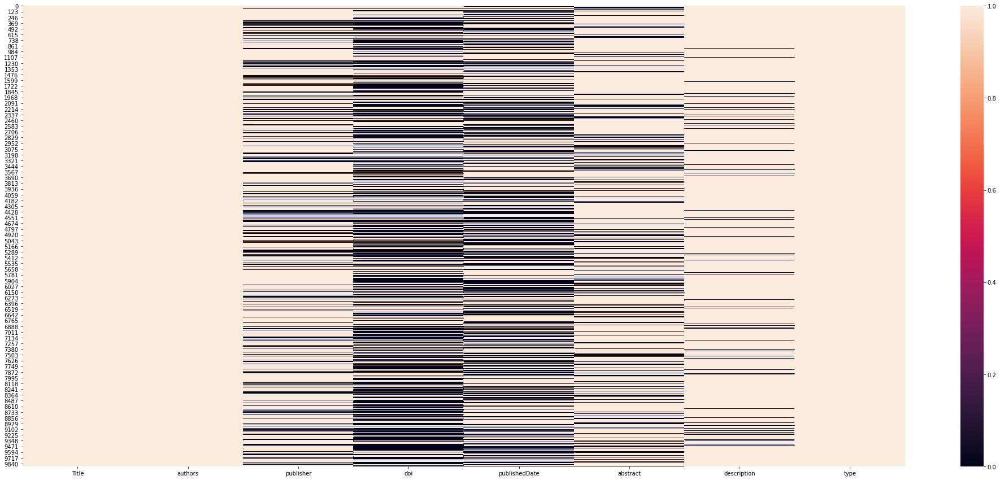

In [ ]:
plt.figure(figsize=(35,15))
sns.heatmap(ExtractDf.notna())
plt.show()

In [ ]:
# PUBLICATION DATE won't work out here :D .... re-do if needed :)

ExtractDf.isna().sum(axis = 0)

Title               0
authors             0
publisher        2582
doi              5335
publishedDate    4400
abstract         2204
description       803
type                0
dtype: int64

In [ ]:
CORE_mental_health = ExtractDf.loc[ExtractDf.abstract.isna()==False]

In [ ]:
CORE_mental_health.head()

,Title,authors,publisher,doi,publishedDate,abstract,description,type
0,Corona virus disease (COVID-19) and Mental Hea...,"[Tariku, Mandaras]","Haramaya University, Colllege of Health and Me...",None,1.597450e+12,"Introduction \nCoronavirus disease (COVID-19),...",East African Journal of Health and Biomedical ...,article
1,Multidisciplinary research priorities for the ...,"[Holmes, Emily A, O'Connor, Rory C, Perry, V H...",'Organisation for Economic Co-Operation and De...,10.17863/CAM.52678,1.589934e+12,The coronavirus disease 2019 (COVID-19) pandem...,\nSince January 2020 Elsevier has created a ...,article
2,New horizons: COVID-19 and the burden of neuro...,"[Hashmi, Ali M, Saleem, Haider Ali]",eCommons@AKU,None,NaN,This manuscript reviews the current state of k...,eCommons@AKU \nMedical College Documents Medic...,article
3,IMPACT OF HUMAN DISASTERS AND COVID-19 PANDEMI...,"[Ćosić, Krešimir, Popović, Siniša, Šarlija, Ma...",Medicinska naklada,10.24869/psyd.2020.25,NaN,Deep emotional traumas in societies overwhelme...,"25\nPsychiatria Danubina, 2020; Vol. 32, No. 1...",article
4,The scope of mental health research in the COV...,"[Hotopf, Matthew, Bullmore, Ed, O'Connor, Rory...",'Royal College of Psychiatrists',10.1192/bjp.2020.125,1.591229e+12,The effects of the COVID-19 pandemic on popula...,Editorial\nThe scope of mental health research...,article


In [ ]:
from google.colab import files

CORE_mental_health.to_csv('CORE_mental_health.csv')
files.download('CORE_mental_health.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import pandas as pd

In [ ]:
CORE_mental_health = pd.read_csv('CORE_mental_health.csv')

In [ ]:
CORE_mental_health.shape

(7696, 9)

In [ ]:
CORE_mental_health.head()

,Unnamed: 0,Title,authors,publisher,doi,publishedDate,abstract,description,type
0,0,Corona virus disease (COVID-19) and Mental Hea...,"['Tariku, Mandaras']","Haramaya University, Colllege of Health and Me...",NaN,1.597450e+12,"Introduction \nCoronavirus disease (COVID-19),...",East African Journal of Health and Biomedical ...,article
1,1,Multidisciplinary research priorities for the ...,"['Holmes, Emily A', ""O'Connor, Rory C"", 'Perry...",'Organisation for Economic Co-Operation and De...,10.17863/CAM.52678,1.589934e+12,The coronavirus disease 2019 (COVID-19) pandem...,\nSince January 2020 Elsevier has created a ...,article
2,2,New horizons: COVID-19 and the burden of neuro...,"['Hashmi, Ali M', 'Saleem, Haider Ali']",eCommons@AKU,NaN,NaN,This manuscript reviews the current state of k...,eCommons@AKU \nMedical College Documents Medic...,article
3,3,IMPACT OF HUMAN DISASTERS AND COVID-19 PANDEMI...,"['Ćosić, Krešimir', 'Popović, Siniša', 'Šarlij...",Medicinska naklada,10.24869/psyd.2020.25,NaN,Deep emotional traumas in societies overwhelme...,"25\nPsychiatria Danubina, 2020; Vol. 32, No. 1...",article
4,4,The scope of mental health research in the COV...,"['Hotopf, Matthew', 'Bullmore, Ed', ""O'Connor,...",'Royal College of Psychiatrists',10.1192/bjp.2020.125,1.591229e+12,The effects of the COVID-19 pandemic on popula...,Editorial\nThe scope of mental health research...,article


In [ ]:
def clean_text(text):
  return(clean(text, all=False, extra_spaces=True, stemming=True, 
               stopwords=True, numbers=False, punct=True, lowercase=True, 
               stp_lang='english'))

In [ ]:
CORE_mental_health["cleaner_abstract"] = CORE_mental_health["abstract"].map(lambda x: clean_text(x))

NameError: ignored

# GeoText TO EXTRACT COUNTRIES FROM TEXT

In [311]:
pip install geotext

     |████████████████████████████████| 2.0MB 3.3MB/s 


In [312]:
from geotext import GeoText
sentence = "my foreigner New York Canberra Sydney Australia, Japan, Fujimoto Godfather Avatar"
places = GeoText(sentence)
print(places.countries)
print(places.cities)

['Australia', 'Japan']
['New York']


In [ ]:
CORE_mental_health.head()

,Unnamed: 0,Title,authors,publisher,doi,publishedDate,abstract,description,type,cleaned_abstract
0,0,Corona virus disease (COVID-19) and Mental Hea...,"['Tariku, Mandaras']","Haramaya University, Colllege of Health and Me...",NaN,1.597450e+12,"Introduction \nCoronavirus disease (COVID-19),...",East African Journal of Health and Biomedical ...,article,"Introduction Coronavirus disease (COVID-19), S..."
1,1,Multidisciplinary research priorities for the ...,"['Holmes, Emily A', ""O'Connor, Rory C"", 'Perry...",'Organisation for Economic Co-Operation and De...,10.17863/CAM.52678,1.589934e+12,The coronavirus disease 2019 (COVID-19) pandem...,\nSince January 2020 Elsevier has created a ...,article,The coronavirus disease 2019 (COVID-19) pandem...
2,2,New horizons: COVID-19 and the burden of neuro...,"['Hashmi, Ali M', 'Saleem, Haider Ali']",eCommons@AKU,NaN,NaN,This manuscript reviews the current state of k...,eCommons@AKU \nMedical College Documents Medic...,article,This manuscript reviews the current state of k...
3,3,IMPACT OF HUMAN DISASTERS AND COVID-19 PANDEMI...,"['Ćosić, Krešimir', 'Popović, Siniša', 'Šarlij...",Medicinska naklada,10.24869/psyd.2020.25,NaN,Deep emotional traumas in societies overwhelme...,"25\nPsychiatria Danubina, 2020; Vol. 32, No. 1...",article,Deep emotional traumas in societies overwhelme...
4,4,The scope of mental health research in the COV...,"['Hotopf, Matthew', 'Bullmore, Ed', ""O'Connor,...",'Royal College of Psychiatrists',10.1192/bjp.2020.125,1.591229e+12,The effects of the COVID-19 pandemic on popula...,Editorial\nThe scope of mental health research...,article,The effects of the COVID-19 pandemic on popula...


In [ ]:
# join the x article texts one after another:

all_texts = ''
for text in CORE_mental_health.cleaned_abstract.dropna():
  all_texts += text

In [ ]:
all_texts

'Introduction Coronavirus disease (COVID-19), SARS-CoV-2, or novel coronavirus is a new infectious virus causing a deadly outbreak of respiratory disease. This viral dis\xadease was declared as a global health emergency and a pandemic by the World Health Organization (WHO) on March 11, 2020. It has resulted in more than 766,332 deaths globally since the first case report (WHO, 2020). Accord\xading to the most recent data from the department of labor, more than 22 million people have lost their jobs due to the lockdown in the United State of America. Many have lost their be\xadloved ones whom they were not allowed to be pre\xadsent in their funeral, which in turn can cause mental dis\xadorders including acute stress disorder, anxiety, de\xadpression, and/or sui\xadcide on the bereaved (Starace and Ferrara, 2020; USA,2020). World health organization had announced that the COVID-19 outbreak has posted an emerging serious challenge for the mental health services around the globe. Confirmed

In [ ]:
len(all_texts)

10577359

In [ ]:
places = GeoText(all_texts)

In [ ]:
country_list = places.countries

In [ ]:
country_list

['India',
 'Pakistan',
 'Pakistan',
 'Pakistan',
 'Pakistan',
 'Pakistan',
 'Croatia',
 'China',
 'Italy',
 'Nepal',
 'China',
 'India',
 'Bangladesh',
 'China',
 'China',
 'United Kingdom',
 'China',
 'Pakistan',
 'China',
 'Pakistan',
 'China',
 'Taiwan',
 'China',
 'United Kingdom',
 'Nepal',
 'Australia',
 'China',
 'United States',
 'Indonesia',
 'Indonesia',
 'Indonesia',
 'India',
 'India',
 'India',
 'China',
 'India',
 'China',
 'India',
 'India',
 'India',
 'India',
 'Vietnam',
 'China',
 'China',
 'Spain',
 'India',
 'Bangladesh',
 'Bangladesh',
 'Czech Republic',
 'China',
 'Brazil',
 'Thailand',
 'Nicaragua',
 'Armenia',
 'India',
 'Guatemala',
 'United States',
 'Israel',
 'Australia',
 'Colombia',
 'Belgium',
 'India',
 'India',
 'India',
 'India',
 'China',
 'China',
 'China',
 'China',
 'China',
 'China',
 'Nepal',
 'Nepal',
 'Nepal',
 'India',
 'Nepal',
 'India',
 'India',
 'India',
 'India',
 'Ireland',
 'Ireland',
 'Pakistan',
 'Nepal',
 'Nepal',
 'India',
 'India',

In [ ]:
type(Counter(country_list))

collections.Counter

In [ ]:
Counter(country_list)

Counter({'Afghanistan': 22,
         'Albania': 3,
         'Algeria': 11,
         'Angola': 3,
         'Antarctica': 7,
         'Argentina': 37,
         'Armenia': 1,
         'Australia': 103,
         'Austria': 21,
         'Bahrain': 3,
         'Bangladesh': 50,
         'Barbados': 1,
         'Belarus': 1,
         'Belgium': 21,
         'Bolivia': 3,
         'Botswana': 8,
         'Brazil': 137,
         'Bulgaria': 5,
         'Cambodia': 15,
         'Cameroon': 9,
         'Canada': 57,
         'Chile': 21,
         'China': 920,
         'Colombia': 47,
         'Costa Rica': 4,
         'Croatia': 6,
         'Cuba': 6,
         'Cyprus': 3,
         'Czech Republic': 2,
         'Denmark': 15,
         'Ecuador': 7,
         'Egypt': 24,
         'El Salvador': 2,
         'Equatorial Guinea': 11,
         'Estonia': 1,
         'Ethiopia': 12,
         'Fiji': 1,
         'Finland': 40,
         'France': 73,
         'French Polynesia': 2,
         'Georgia': 6

In [ ]:
def counter_to_series(counter):
  if not counter:
    return pd.Series() 
  counter_as_tuples = counter.most_common(len(counter)) 

  items, counts = zip(*counter_as_tuples)
  return pd.Series(counts, index=items)

In [ ]:
counter_to_series(Counter(country_list))

China            920
United States    466
Italy            375
Indonesia        296
India            249
                ... 
Monaco             1
Fiji               1
Jamaica            1
Turkmenistan       1
Maldives           1
Length: 138, dtype: int64

In [ ]:
hackathon_pd_series = counter_to_series(Counter(country_list))

In [ ]:
hackathon_df = pd.DataFrame(hackathon_pd_series)

In [ ]:
hackathon_df.head()

,0
China,920
United States,466
Italy,375
Indonesia,296
India,249


In [ ]:
from google.colab import files

hackathon_df.to_csv('hackathon_df.csv')
files.download('hackathon_df.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [272]:
reimported = pd.read_csv('hackathon_df.csv')

In [273]:
reimported.head()

,Unnamed: 0,0
0,China,920
1,United States,466
2,Italy,375
3,Indonesia,296
4,India,249


In [ ]:
import seaborn as sns

In [ ]:
import matplotlib.pyplot as plt

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



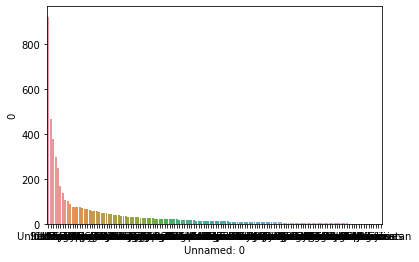

In [ ]:
sns.barplot(reimported['Unnamed: 0'],reimported['0'])

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



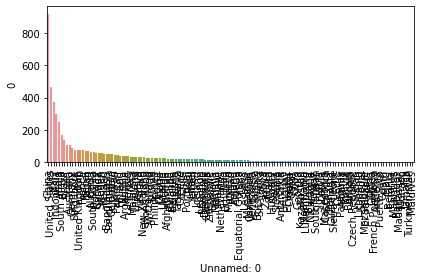

In [ ]:
sns.barplot(reimported['Unnamed: 0'],reimported['0'])

plt.xticks(rotation=90)
plt.tight_layout()

## IF WE SHOULD NEED SPACY NER FOR STH ELSE ....

In [ ]:
# https://towardsdatascience.com/named-entity-recognition-with-nltk-and-spacy-8c4a7d88e7da

In [ ]:
from spacy import displacy
from collections import Counter

In [ ]:
from nltk.chunk import conlltags2tree, tree2conlltags
from pprint import pprint

In [ ]:
doc = nlp(OVAC.article_text[20])
len(doc.ents)

29

In [ ]:
labels = [x.label_ for x in doc.ents]
Counter(labels)

Counter({'CARDINAL': 3,
         'DATE': 6,
         'GPE': 3,
         'NORP': 1,
         'ORG': 10,
         'PERCENT': 1,
         'PERSON': 5})

## START WITH PYCOUNTRY .. WORLD MAP VISUALIZATIONS

In [ ]:
CORE_mental_health.head()

,Unnamed: 0,Title,authors,publisher,doi,publishedDate,abstract,description,type,cleaned_abstract
0,0,Corona virus disease (COVID-19) and Mental Hea...,"['Tariku, Mandaras']","Haramaya University, Colllege of Health and Me...",NaN,1.597450e+12,"Introduction \nCoronavirus disease (COVID-19),...",East African Journal of Health and Biomedical ...,article,"Introduction Coronavirus disease (COVID-19), S..."
1,1,Multidisciplinary research priorities for the ...,"['Holmes, Emily A', ""O'Connor, Rory C"", 'Perry...",'Organisation for Economic Co-Operation and De...,10.17863/CAM.52678,1.589934e+12,The coronavirus disease 2019 (COVID-19) pandem...,\nSince January 2020 Elsevier has created a ...,article,The coronavirus disease 2019 (COVID-19) pandem...
2,2,New horizons: COVID-19 and the burden of neuro...,"['Hashmi, Ali M', 'Saleem, Haider Ali']",eCommons@AKU,NaN,NaN,This manuscript reviews the current state of k...,eCommons@AKU \nMedical College Documents Medic...,article,This manuscript reviews the current state of k...
3,3,IMPACT OF HUMAN DISASTERS AND COVID-19 PANDEMI...,"['Ćosić, Krešimir', 'Popović, Siniša', 'Šarlij...",Medicinska naklada,10.24869/psyd.2020.25,NaN,Deep emotional traumas in societies overwhelme...,"25\nPsychiatria Danubina, 2020; Vol. 32, No. 1...",article,Deep emotional traumas in societies overwhelme...
4,4,The scope of mental health research in the COV...,"['Hotopf, Matthew', 'Bullmore, Ed', ""O'Connor,...",'Royal College of Psychiatrists',10.1192/bjp.2020.125,1.591229e+12,The effects of the COVID-19 pandemic on popula...,Editorial\nThe scope of mental health research...,article,The effects of the COVID-19 pandemic on popula...


In [ ]:
pip install pycountry

     |████████████████████████████████| 10.1MB 2.7MB/s 
  Created wheel for pycountry: filename=pycountry-20.7.3-py2.py3-none-any.whl size=10746865 sha256=93f00b079922e8a882ff7d42004d4b2336c164a0bc13cf741abe6275556e6f3b
  Stored in directory: /root/.cache/pip/wheels/33/4e/a6/be297e6b83567e537bed9df4a93f8590ec01c1acfbcd405348
Successfully built pycountry


In [ ]:
import pycountry
import plotly.express as px
import pandas as pd

In [ ]:
# https://opensource.com/article/20/4/python-map-covid-19

In [274]:
reimported.head()

,Unnamed: 0,0
0,China,920
1,United States,466
2,Italy,375
3,Indonesia,296
4,India,249


In [275]:
list_countries = reimported['Unnamed: 0'].unique().tolist()

In [276]:
list_countries

['China',
 'United States',
 'Italy',
 'Indonesia',
 'India',
 'South Africa',
 'Brazil',
 'Spain',
 'Australia',
 'Germany',
 'Singapore',
 'Iran',
 'United Kingdom',
 'France',
 'Nepal',
 'Japan',
 'Nigeria',
 'South Korea',
 'Norway',
 'Canada',
 'Sweden',
 'Ireland',
 'Bangladesh',
 'Saudi Arabia',
 'Colombia',
 'Taiwan',
 'Pakistan',
 'Finland',
 'Russia',
 'Argentina',
 'Mexico',
 'Turkey',
 'Malaysia',
 'Thailand',
 'Kenya',
 'Vietnam',
 'New Zealand',
 'Hong Kong',
 'Switzerland',
 'Jordan',
 'Philippines',
 'Egypt',
 'Ghana',
 'Ukraine',
 'Uganda',
 'Afghanistan',
 'Rwanda',
 'Belgium',
 'Austria',
 'Tanzania',
 'Greece',
 'Chile',
 'Portugal',
 'Peru',
 'Israel',
 'Yemen',
 'Iceland',
 'Lebanon',
 'Romania',
 'Denmark',
 'Cambodia',
 'Zimbabwe',
 'Somalia',
 'Namibia',
 'Malawi',
 'Netherlands',
 'Iraq',
 'Ethiopia',
 'Morocco',
 'Oman',
 'Poland',
 'Algeria',
 'Equatorial Guinea',
 'Laos',
 'Lesotho',
 'Myanmar',
 'Cameroon',
 'Venezuela',
 'Tunisia',
 'Botswana',
 'Sri Lank

## ADDING THE WORLD MAP (PYCOUNTRY & PYPLOT)

In [ ]:
pip install pycountry

     |████████████████████████████████| 10.1MB 7.4MB/s 
  Created wheel for pycountry: filename=pycountry-20.7.3-py2.py3-none-any.whl size=10746865 sha256=e203858f9f4ad62b549b10235a16ff187bfed1ba9c30bdfec62793d333c1328d
  Stored in directory: /root/.cache/pip/wheels/33/4e/a6/be297e6b83567e537bed9df4a93f8590ec01c1acfbcd405348
Successfully built pycountry


In [ ]:
import pycountry
import plotly.express as px
import pandas as pd

In [ ]:
# https://opensource.com/article/20/4/python-map-covid-19

In [277]:
d_country_code = {}  # To hold the country names and their ISO
for country in list_countries:
    try:
        country_data = pycountry.countries.search_fuzzy(country)
        # country_data is a list of objects of class pycountry.db.Country
        # The first item  ie at index 0 of list is best fit
        # object of class Country have an alpha_3 attribute
        country_code = country_data[0].alpha_3
        d_country_code.update({country: country_code})
    except:
        print('could not add ISO 3 code for ->', country)
        # If could not find country, make ISO code ' '
        d_country_code.update({country: ' '})

could not add ISO 3 code for -> South Korea
could not add ISO 3 code for -> Laos


In [278]:
d_country_code.update({'South Korea': 'KOR', 'Laos': 'LAO'})

In [279]:
print(d_country_code)

{'China': 'CHN', 'United States': 'USA', 'Italy': 'ITA', 'Indonesia': 'IDN', 'India': 'IND', 'South Africa': 'ZAF', 'Brazil': 'BRA', 'Spain': 'ESP', 'Australia': 'AUS', 'Germany': 'DEU', 'Singapore': 'SGP', 'Iran': 'IRN', 'United Kingdom': 'GBR', 'France': 'FRA', 'Nepal': 'NPL', 'Japan': 'JPN', 'Nigeria': 'NGA', 'South Korea': 'KOR', 'Norway': 'NOR', 'Canada': 'CAN', 'Sweden': 'SWE', 'Ireland': 'IRL', 'Bangladesh': 'BGD', 'Saudi Arabia': 'SAU', 'Colombia': 'COL', 'Taiwan': 'TWN', 'Pakistan': 'PAK', 'Finland': 'FIN', 'Russia': 'RUS', 'Argentina': 'ARG', 'Mexico': 'MEX', 'Turkey': 'TUR', 'Malaysia': 'MYS', 'Thailand': 'THA', 'Kenya': 'KEN', 'Vietnam': 'VNM', 'New Zealand': 'NZL', 'Hong Kong': 'HKG', 'Switzerland': 'CHE', 'Jordan': 'JOR', 'Philippines': 'PHL', 'Egypt': 'EGY', 'Ghana': 'GHA', 'Ukraine': 'UKR', 'Uganda': 'UGA', 'Afghanistan': 'AFG', 'Rwanda': 'RWA', 'Belgium': 'BEL', 'Austria': 'AUT', 'Tanzania': 'TZA', 'Greece': 'GRC', 'Chile': 'CHL', 'Portugal': 'PRT', 'Peru': 'PER', 'Isr

In [ ]:
# Serbia & Montenegro -> SRB and MNE !!

In [280]:
reimported.head()

,Unnamed: 0,0
0,China,920
1,United States,466
2,Italy,375
3,Indonesia,296
4,India,249


In [281]:
# create a new column iso_alpha in the df
# and fill it with appropriate iso 3 code
for k, v in d_country_code.items():
    reimported.loc[(reimported['Unnamed: 0'] == k), 'iso_alpha'] = v

In [282]:
reimported.head()

,Unnamed: 0,0,iso_alpha
0,China,920,CHN
1,United States,466,USA
2,Italy,375,ITA
3,Indonesia,296,IDN
4,India,249,IND


In [283]:
NLP_CORE_Covid_MentalHealth = reimported

In [284]:
NLP_CORE_Covid_MentalHealth = NLP_CORE_Covid_MentalHealth.rename(columns={"Unnamed: 0": "country_x", "0": "publication_frequency"})

In [285]:
NLP_CORE_Covid_MentalHealth.head()

,country_x,publication_frequency,iso_alpha
0,China,920,CHN
1,United States,466,USA
2,Italy,375,ITA
3,Indonesia,296,IDN
4,India,249,IND


In [286]:
from google.colab import files

NLP_CORE_Covid_MentalHealth.to_csv('NLP_CORE_Covid_MentalHealth.csv')
files.download('NLP_CORE_Covid_MentalHealth.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
fig = px.choropleth(data_frame = reimported,
                    locations= "iso_alpha",
                    color= "0",  # value in column 'Confirmed' determines color
                    hover_name= "Unnamed: 0",
                    color_continuous_scale= 'BuPu',  #  color scale red, yellow green   # RdYlGn_r
                    #plt.clim(0, 252)
                    # animation_frame= "Date"
                    )

In [ ]:
fig.show() # Covid Effects on Mental Health - CORE Repo scraped for covid AND mental health terms

## SIJ's CLEANING FUNCTION

In [ ]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
! pip install cleantext

In [ ]:
from cleantext import clean

In [ ]:
def clean_text(text):
  return(clean(text, all=False, extra_spaces=True, stemming=False, 
               stopwords=False, numbers=False, punct=False, lowercase=False, 
               stp_lang='english'))

In [ ]:
CORE_mental_health["cleaned_abstract"] = CORE_mental_health["abstract"].map(lambda x: clean_text(x))

In [ ]:
CORE_mental_health.head()

,Unnamed: 0,Title,authors,publisher,doi,publishedDate,abstract,description,type,cleaned_abstract
0,0,Corona virus disease (COVID-19) and Mental Hea...,"['Tariku, Mandaras']","Haramaya University, Colllege of Health and Me...",NaN,1.597450e+12,"Introduction \nCoronavirus disease (COVID-19),...",East African Journal of Health and Biomedical ...,article,"Introduction Coronavirus disease (COVID-19), S..."
1,1,Multidisciplinary research priorities for the ...,"['Holmes, Emily A', ""O'Connor, Rory C"", 'Perry...",'Organisation for Economic Co-Operation and De...,10.17863/CAM.52678,1.589934e+12,The coronavirus disease 2019 (COVID-19) pandem...,\nSince January 2020 Elsevier has created a ...,article,The coronavirus disease 2019 (COVID-19) pandem...
2,2,New horizons: COVID-19 and the burden of neuro...,"['Hashmi, Ali M', 'Saleem, Haider Ali']",eCommons@AKU,NaN,NaN,This manuscript reviews the current state of k...,eCommons@AKU \nMedical College Documents Medic...,article,This manuscript reviews the current state of k...
3,3,IMPACT OF HUMAN DISASTERS AND COVID-19 PANDEMI...,"['Ćosić, Krešimir', 'Popović, Siniša', 'Šarlij...",Medicinska naklada,10.24869/psyd.2020.25,NaN,Deep emotional traumas in societies overwhelme...,"25\nPsychiatria Danubina, 2020; Vol. 32, No. 1...",article,Deep emotional traumas in societies overwhelme...
4,4,The scope of mental health research in the COV...,"['Hotopf, Matthew', 'Bullmore, Ed', ""O'Connor,...",'Royal College of Psychiatrists',10.1192/bjp.2020.125,1.591229e+12,The effects of the COVID-19 pandemic on popula...,Editorial\nThe scope of mental health research...,article,The effects of the COVID-19 pandemic on popula...


In [ ]:
mental_health_smaller = CORE_mental_health[['Title', 'publishedDate', 'cleaned_abstract']]

In [ ]:
mental_health_smaller.head()

,Title,publishedDate,cleaned_abstract
0,Corona virus disease (COVID-19) and Mental Hea...,1.597450e+12,"Introduction Coronavirus disease (COVID-19), S..."
1,Multidisciplinary research priorities for the ...,1.589934e+12,The coronavirus disease 2019 (COVID-19) pandem...
2,New horizons: COVID-19 and the burden of neuro...,NaN,This manuscript reviews the current state of k...
3,IMPACT OF HUMAN DISASTERS AND COVID-19 PANDEMI...,NaN,Deep emotional traumas in societies overwhelme...
4,The scope of mental health research in the COV...,1.591229e+12,The effects of the COVID-19 pandemic on popula...


In [ ]:
from google.colab import files

mental_health_smaller.to_csv('mental_health_smaller.csv')
files.download('mental_health_smaller.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## CONCATENATE THE VARIOUS DFs

In [ ]:
covid_interesting.head()

,country,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha
0,USA,23415.0,653.0,343909.0,0.027888,USA
1,India,4939.0,76.0,59462.0,0.015388,IND
2,Brazil,23482.0,696.0,84053.0,0.029640,BRA
3,Russia,8555.0,150.0,333673.0,0.017534,RUS
4,Spain,18654.0,696.0,292769.0,0.037311,ESP


In [151]:
world_dev_complete2_sub.head()

NameError: ignored

In [ ]:
world_dev_complete2_sub.head()

NameError: ignored

In [152]:
world_poverty_subsub.head()

,Unnamed: 0,Country,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,iso_alpha
0,0,Afghanistan,2011.0,36.0,AFG
1,1,Albania,2012.0,14.0,ALB
2,2,Algeria,2011.0,6.0,DZA
3,7,Argentina,2018.0,32.0,ARG
4,8,Armenia,2018.0,6.0,ARM


In [ ]:
world_poverty_subsub.head()

,Unnamed: 0,Country,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,iso_alpha
0,0,Afghanistan,2011.0,36.0,AFG
1,1,Albania,2012.0,14.0,ALB
2,2,Algeria,2011.0,6.0,DZA
3,7,Argentina,2018.0,32.0,ARG
4,8,Armenia,2018.0,6.0,ARM


In [ ]:
world_poverty_subsub['Unnamed: 0'].unique()

array([  0,   1,   2,   7,   8,  12,  15,  17,  20,  22,  23,  24,  26,
        29,  30,  31,  32,  33,  34,  38,  40,  41,  42,  43,  44,  45,
        46,  47,  48,  52,  54,  56,  57,  58,  59,  62,  64,  66,  70,
        71,  72,  74,  80,  81,  82,  84,  85,  87,  89,  90,  92,  97,
        99, 100, 101, 105, 107, 108, 109, 110, 111, 112, 115, 118, 119,
       120, 121, 126, 127, 128, 129, 130, 132, 133, 134, 135, 136, 139,
       143, 144, 149, 151, 153, 154, 155, 156, 160, 161, 162, 165, 167,
       168, 169, 170, 173, 174, 175, 177, 178, 180, 190, 191, 192, 193,
       194, 197, 198, 200, 201, 202, 206, 207, 208, 209, 210, 212, 213,
       214])

In [ ]:
experiment = pd.merge(covid_interesting, world_poverty_subsub, on='iso_alpha')

In [ ]:
# experiment = covid_interesting.join(world_poverty_subsub.set_index('iso_alpha'), on='iso_alpha') DONT JOIN, MERGE INSTEAD!! JOINING RESULTS IN LOSS OF VALUES -> NAN !!!

In [ ]:
experiment.head()

,country,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Unnamed: 0,Country,Population_Below_Poverty_National_Year,Population_Below_Poverty_National
0,India,4939.0,76.0,59462.0,0.015388,IND,89,India,2011.0,22.0
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,26,Brazil,2015.0,9.0
2,Russia,8555.0,150.0,333673.0,0.017534,RUS,161,Russian Federation,2018.0,13.0
3,Colombia,17046.0,529.0,77761.0,0.031034,COL,42,Colombia,2018.0,27.0
4,Peru,25169.0,995.0,120117.0,0.039533,PER,154,Peru,2018.0,21.0


In [177]:
bmi_by_sex = bmi_by_sex.rename(columns={"ISO_x": "iso_alpha", "CountryPerRegionPerWorld": "country"})

In [178]:
bmi_by_sex.head()

,country,iso_alpha,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women
0,Afghanistan,AFG,22.682456,0.033603,0.003314,0.166902,AFG,24.234135,0.080023,0.019154,0.156378
1,Albania,ALB,27.174471,0.223735,0.045036,0.003623,ALB,26.507512,0.227215,0.072337,0.019943
2,Algeria,DZA,24.865386,0.206662,0.042840,0.033010,DZA,26.561166,0.362187,0.136361,0.032798
3,American Samoa,ASM,33.066721,0.587546,0.322678,0.000456,ASM,35.148865,0.653208,0.396113,0.002016
4,Andorra,AND,27.478395,0.267498,0.068565,0.003248,AND,26.271661,0.263382,0.093098,0.014833


In [179]:
experiment1 = pd.merge(experiment, bmi_by_sex, on='iso_alpha')

In [180]:
experiment1.head()

,country_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Unnamed: 0,Country,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women
0,India,4939.0,76.0,59462.0,0.015388,IND,89,India,2011.0,22.0,India,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,26,Brazil,2015.0,9.0,Brazil,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312
2,Russia,8555.0,150.0,333673.0,0.017534,RUS,161,Russian Federation,2018.0,13.0,Russian Federation,25.988633,0.188793,0.038722,0.008777,RUS,26.691878,0.281128,0.103641,0.021275
3,Colombia,17046.0,529.0,77761.0,0.031034,COL,42,Colombia,2018.0,27.0,Colombia,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259
4,Peru,25169.0,995.0,120117.0,0.039533,PER,154,Peru,2018.0,21.0,Peru,26.366296,0.157669,0.024400,0.008526,PER,27.278299,0.251425,0.072837,0.013568


In [181]:
from google.colab import files

experiment1.to_csv('experiment1.csv')
files.download('experiment1.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [193]:
world_development_use.head()

,Country,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,iso_alpha
0,Afghanistan,0.0,5.0,62.0,NaN,84.0,18.0,63.0,0.0,2.0,35.0,28.0,AFG
1,Albania,4.0,NaN,9.0,69.0,1.0,39.0,15.0,2.0,66.0,NaN,28.0,ALB
2,Algeria,0.0,12.0,24.0,NaN,99.0,0.0,37.0,4.0,43.0,3.0,26.0,DZA
3,American Samoa,-3.0,NaN,NaN,NaN,NaN,1.0,4.0,NaN,NaN,NaN,NaN,ASM
4,Andorra,2.0,NaN,3.0,NaN,1.0,20.0,2.0,6.0,98.0,NaN,32.0,AND


In [194]:
experiment2 = pd.merge(experiment1, world_development_use, on='iso_alpha')

In [195]:
experiment2.head()

,country_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Unnamed: 0,Country_x,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Country_y,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments
0,India,4939.0,76.0,59462.0,0.015388,IND,89,India,2011.0,22.0,India,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445,India,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,26,Brazil,2015.0,9.0,Brazil,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312,Brazil,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0
2,Russia,8555.0,150.0,333673.0,0.017534,RUS,161,Russian Federation,2018.0,13.0,Russian Federation,25.988633,0.188793,0.038722,0.008777,RUS,26.691878,0.281128,0.103641,0.021275,Russian Federation,5.0,NaN,7.0,76.0,1.0,3.0,16.0,12.0,73.0,NaN,16.0
3,Colombia,17046.0,529.0,77761.0,0.031034,COL,42,Colombia,2018.0,27.0,Colombia,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259,Colombia,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0
4,Peru,25169.0,995.0,120117.0,0.039533,PER,154,Peru,2018.0,21.0,Peru,26.366296,0.157669,0.024400,0.008526,PER,27.278299,0.251425,0.072837,0.013568,Peru,1.0,13.0,14.0,5.0,95.0,26.0,26.0,2.0,46.0,19.0,28.0


In [196]:
from google.colab import files

experiment2.to_csv('experiment2.csv')
files.download('experiment2.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [218]:
world_dev3_sub.head()

,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,iso_alpha
0,Afghanistan,57.0,46.0,18.0,49.0,83.0,94.0,9.0,9.0,64.0,0.0,37.0,AFG
1,Albania,272.0,7.0,96.0,47.0,74.0,95.0,6.0,2.0,78.0,1.0,3.0,ALB
2,Algeria,260.0,11.0,68.0,15.0,75.0,NaN,8.0,NaN,76.0,1.0,42.0,DZA
3,American Samoa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,ASM
4,Andorra,3835.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,0.0,AND


In [219]:
experiment3 = pd.merge(experiment2, world_dev3_sub, on='iso_alpha')

In [220]:
experiment3.head()

,country_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Unnamed: 0,Country_x,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Country_y,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018
0,India,4939.0,76.0,59462.0,0.015388,IND,89,India,2011.0,22.0,India,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445,India,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,26,Brazil,2015.0,9.0,Brazil,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312,Brazil,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0
2,Colombia,17046.0,529.0,77761.0,0.031034,COL,42,Colombia,2018.0,27.0,Colombia,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259,Colombia,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0
3,Argentina,18198.0,482.0,46594.0,0.026486,ARG,7,Argentina,2018.0,32.0,Argentina,28.017682,0.282313,0.076017,0.003472,ARG,27.798589,0.301352,0.124261,0.011436,Argentina,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0
4,Mexico,6146.0,637.0,15633.0,0.103645,MEX,128,Mexico,2018.0,42.0,Mexico,27.635164,0.251200,0.070726,0.008199,MEX,28.592706,0.339817,0.132470,0.015216,Mexico,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0


In [221]:
from google.colab import files

experiment3.to_csv('experiment3.csv')
files.download('experiment3.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [287]:
NLP_CORE_Covid_MentalHealth.head()

,country_x,publication_frequency,iso_alpha
0,China,920,CHN
1,United States,466,USA
2,Italy,375,ITA
3,Indonesia,296,IDN
4,India,249,IND


In [288]:
experiment4 = pd.merge(experiment3, NLP_CORE_Covid_MentalHealth, on='iso_alpha')

In [289]:
experiment4.head()

,country_x_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Unnamed: 0,Country_x,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Country_y,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,physician_density,country_x_y,publication_frequency
0,India,4939.0,76.0,59462.0,0.015388,IND,89,India,2011.0,22.0,India,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445,India,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0,0.000739,India,249
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,26,Brazil,2015.0,9.0,Brazil,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312,Brazil,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0,0.009524,Brazil,137
2,Colombia,17046.0,529.0,77761.0,0.031034,COL,42,Colombia,2018.0,27.0,Colombia,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259,Colombia,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0,0.040000,Colombia,47
3,Argentina,18198.0,482.0,46594.0,0.026486,ARG,7,Argentina,2018.0,32.0,Argentina,28.017682,0.282313,0.076017,0.003472,ARG,27.798589,0.301352,0.124261,0.011436,Argentina,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0,0.088889,Argentina,37
4,Mexico,6146.0,637.0,15633.0,0.103645,MEX,128,Mexico,2018.0,42.0,Mexico,27.635164,0.251200,0.070726,0.008199,MEX,28.592706,0.339817,0.132470,0.015216,Mexico,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0,0.015873,Mexico,35


In [290]:
experiment4.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 69 entries, 0 to 68
Data columns (total 47 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   country_x_x                                69 non-null     object 
 1   total_per_1M                               69 non-null     float64
 2   deaths_per_1M                              67 non-null     float64
 3   tests_per_1M                               67 non-null     float64
 4   deathsPerTotal                             67 non-null     float64
 5   iso_alpha                                  69 non-null     object 
 6   Unnamed: 0                                 69 non-null     int64  
 7   Country_x                                  69 non-null     object 
 8   Population_Below_Poverty_National_Year     69 non-null     float64
 9   Population_Below_Poverty_National          69 non-null     float64
 10  country_y                   

In [292]:
experiment4.shape

(69, 47)

In [293]:
experiment4

,country_x_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Unnamed: 0,Country_x,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Country_y,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,physician_density,country_x_y,publication_frequency
0,India,4939.0,76.0,59462.0,0.015388,IND,89,India,2011.0,22.0,India,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445,India,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0,0.000739,India,249
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,26,Brazil,2015.0,9.0,Brazil,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312,Brazil,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0,0.009524,Brazil,137
2,Colombia,17046.0,529.0,77761.0,0.031034,COL,42,Colombia,2018.0,27.0,Colombia,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259,Colombia,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0,0.040000,Colombia,47
3,Argentina,18198.0,482.0,46594.0,0.026486,ARG,7,Argentina,2018.0,32.0,Argentina,28.017682,0.282313,0.076017,0.003472,ARG,27.798589,0.301352,0.124261,0.011436,Argentina,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0,0.088889,Argentina,37
4,Mexico,6146.0,637.0,15633.0,0.103645,MEX,128,Mexico,2018.0,42.0,Mexico,27.635164,0.251200,0.070726,0.008199,MEX,28.592706,0.339817,0.132470,0.015216,Mexico,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0,0.015873,Mexico,35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64,Liberia,266.0,16.0,5877.0,0.060150,LBR,112,Liberia,2016.0,51.0,Liberia,23.172301,0.057322,0.011764,0.082485,LBR,25.199524,0.148203,0.054000,0.075722,Liberia,0.0,32.0,71.0,NaN,20.0,84.0,17.0,0.0,7.0,36.0,12.0,Liberia,68.0,38.0,NaN,55.0,58.0,84.0,18.0,13.0,63.0,NaN,5.0,NaN,Liberia,2
65,Mauritius,310.0,8.0,199042.0,0.025806,MUS,127,Mauritius,2012.0,8.0,Mauritius,24.670173,0.058308,0.009087,0.086521,MUS,26.066932,0.163525,0.054419,0.068814,Mauritius,4.0,NaN,16.0,NaN,99.0,12.0,15.0,3.0,52.0,NaN,12.0,Mauritius,553.0,7.0,91.0,45.0,79.0,NaN,NaN,NaN,75.0,2.0,1.0,2.000000,Mauritius,1
66,Cambodia,17.0,NaN,8765.0,NaN,KHM,33,Cambodia,2012.0,18.0,Cambodia,22.154053,0.028397,0.002743,0.126039,KHM,22.387620,0.050575,0.010470,0.138122,Cambodia,5.0,32.0,28.0,24.0,50.0,65.0,26.0,0.0,32.0,19.0,2.0,Cambodia,78.0,29.0,75.0,75.0,81.0,88.0,12.0,14.0,69.0,0.0,16.0,0.000000,Cambodia,15
67,Fiji,36.0,2.0,11562.0,0.055556,FJI,66,Fiji,2013.0,34.0,Fiji,26.805610,0.259518,0.067581,0.015689,FJI,29.003238,0.365046,0.143681,0.016966,Fiji,3.0,NaN,26.0,NaN,99.0,31.0,8.0,1.0,47.0,NaN,16.0,Fiji,180.0,5.0,NaN,38.0,78.0,NaN,NaN,NaN,70.0,1.0,1.0,1.000000,Fiji,1


In [291]:
from google.colab import files

experiment4.to_csv('experiment4.csv')
files.download('experiment4.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [222]:
experiment3.describe()

,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,Unnamed: 0,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018
count,87.000000,83.000000,81.000000,83.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,66.000000,84.000000,42.000000,87.000000,87.000000,85.000000,84.000000,85.000000,58.000000,85.000000,82.000000,77.000000,73.000000,83.000000,83.000000,39.000000,65.000000,41.000000,86.000000,67.000000,87.000000
mean,4624.494253,119.458795,63314.666667,0.025619,85.126437,2014.528736,28.712644,24.919772,0.134473,0.030095,0.061419,25.732845,0.206090,0.073199,0.061659,2.413793,24.984848,37.976190,58.809524,36.735632,40.344828,37.658824,2.428571,37.788235,27.706897,19.164706,288.378049,19.311688,72.438356,52.951807,76.108434,75.307692,21.938462,10.707317,69.418605,1.522388,64.643678
std,6174.921310,184.179111,66020.697966,0.018341,47.858514,2.250783,16.631371,2.210245,0.088489,0.022959,0.057421,2.113577,0.093961,0.041018,0.050178,2.599426,14.520534,34.026912,32.268869,38.685512,30.352896,31.766467,2.896969,26.097844,20.796431,11.689278,333.432527,13.323169,27.775382,15.194594,9.920430,15.791660,18.119290,7.524108,7.368399,1.318381,210.286459
min,3.000000,0.080000,1095.000000,0.001860,0.000000,2010.000000,0.000000,20.110440,0.019809,0.001507,0.002027,21.119707,0.050575,0.008711,0.009261,-6.000000,2.000000,3.000000,2.000000,1.000000,0.000000,2.000000,0.000000,2.000000,2.000000,1.000000,19.000000,3.000000,14.000000,12.000000,52.000000,29.000000,1.000000,2.000000,53.000000,0.000000,1.000000
25%,390.500000,9.000000,8765.000000,0.015131,41.500000,2013.000000,18.000000,22.648558,0.048224,0.009297,0.010627,24.032402,0.136488,0.048426,0.021520,1.000000,12.000000,11.500000,27.000000,1.000000,15.000000,19.000000,0.000000,15.000000,11.250000,12.000000,57.500000,7.000000,48.000000,46.500000,69.000000,68.000000,6.000000,6.000000,64.000000,0.000000,3.500000
50%,2022.000000,38.000000,40999.000000,0.020919,89.000000,2015.000000,25.000000,25.561235,0.154459,0.029633,0.030893,26.045267,0.227215,0.075548,0.034181,3.000000,26.500000,24.500000,69.000000,16.000000,33.000000,24.000000,1.000000,30.000000,23.500000,18.000000,165.000000,18.000000,85.000000,53.000000,78.000000,79.000000,14.000000,8.000000,72.000000,1.000000,11.000000
75%,5949.500000,130.500000,111163.000000,0.029455,129.000000,2016.000000,41.000000,26.789231,0.214479,0.045300,0.105922,27.313711,0.273956,0.096959,0.092895,4.000000,36.750000,62.750000,88.750000,80.500000,73.500000,47.000000,4.000000,62.000000,39.500000,26.000000,361.250000,28.000000,97.000000,63.500000,83.000000,86.000000,35.000000,14.000000,75.000000,2.000000,30.000000
max,26913.000000,696.000000,300630.000000,0.103645,168.000000,2018.000000,71.000000,28.505387,0.291715,0.079419,0.225643,30.087790,0.446042,0.196146,0.237445,8.000000,56.000000,120.000000,99.000000,100.000000,96.000000,140.000000,15.000000,87.000000,76.000000,53.000000,1322.000000,55.000000,100.000000,84.000000,91.000000,95.000000,64.000000,26.000000,80.000000,5.000000,1393.000000


In [223]:
experiment3.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87 entries, 0 to 86
Data columns (total 44 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   country_x                                  87 non-null     object 
 1   total_per_1M                               87 non-null     float64
 2   deaths_per_1M                              83 non-null     float64
 3   tests_per_1M                               81 non-null     float64
 4   deathsPerTotal                             83 non-null     float64
 5   iso_alpha                                  87 non-null     object 
 6   Unnamed: 0                                 87 non-null     int64  
 7   Country_x                                  87 non-null     object 
 8   Population_Below_Poverty_National_Year     87 non-null     float64
 9   Population_Below_Poverty_National          87 non-null     float64
 10  country_y                   

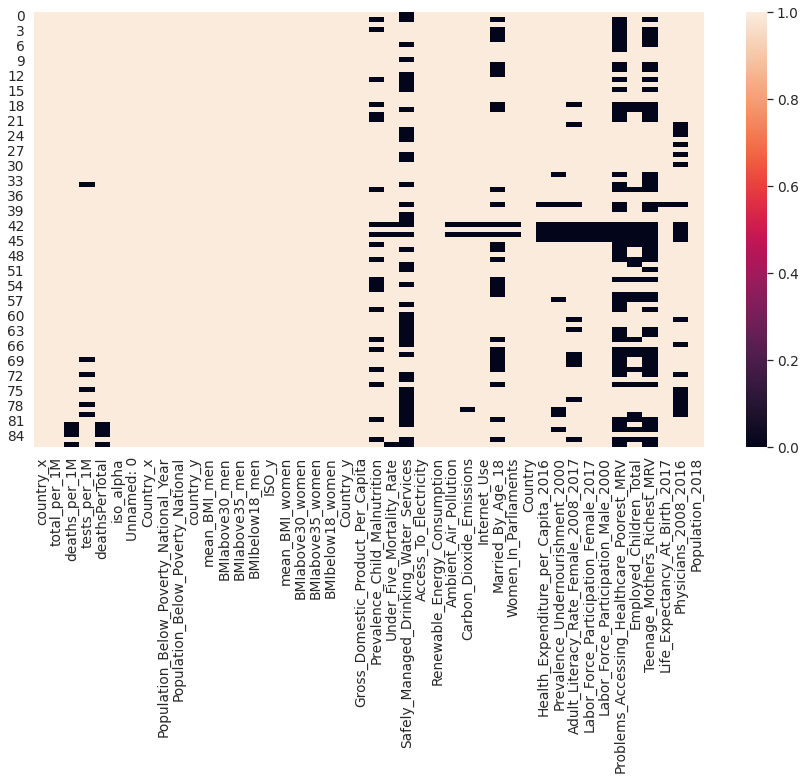

In [224]:
plt.figure(figsize=(15,8))
sns.heatmap(experiment3.notna())
plt.show()

In [225]:
experiment3.columns

Index(['country_x', 'total_per_1M', 'deaths_per_1M', 'tests_per_1M',
       'deathsPerTotal', 'iso_alpha', 'Unnamed: 0', 'Country_x',
       'Population_Below_Poverty_National_Year',
       'Population_Below_Poverty_National', 'country_y', 'mean_BMI_men',
       'BMIabove30_men', 'BMIabove35_men', 'BMIbelow18_men', 'ISO_y',
       'mean_BMI_women', 'BMIabove30_women', 'BMIabove35_women',
       'BMIbelow18_women', 'Country_y', 'Gross_Domestic_Product_Per_Capita',
       'Prevalence_Child_Malnutrition', 'Under_Five_Mortality_Rate',
       'Safely_Managed_Drinking_Water_Services', 'Access_To_Electricity',
       'Renewable_Energy_Consumption', 'Ambient_Air_Pollution',
       'Carbon_Dioxide_Emissions', 'Internet_Use', 'Married_By_Age_18',
       'Women_In_Parliaments', 'Country', 'Health_Expenditure_per_Capita_2016',
       'Prevalence_Undernourishment_2000',
       'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female_2017',
       'Labor_Force_Participation_M

In [226]:
experiment3['physician_density'] = experiment3.Physicians_2008_2016 / experiment3.Population_2018

In [227]:
experiment3.columns

Index(['country_x', 'total_per_1M', 'deaths_per_1M', 'tests_per_1M',
       'deathsPerTotal', 'iso_alpha', 'Unnamed: 0', 'Country_x',
       'Population_Below_Poverty_National_Year',
       'Population_Below_Poverty_National', 'country_y', 'mean_BMI_men',
       'BMIabove30_men', 'BMIabove35_men', 'BMIbelow18_men', 'ISO_y',
       'mean_BMI_women', 'BMIabove30_women', 'BMIabove35_women',
       'BMIbelow18_women', 'Country_y', 'Gross_Domestic_Product_Per_Capita',
       'Prevalence_Child_Malnutrition', 'Under_Five_Mortality_Rate',
       'Safely_Managed_Drinking_Water_Services', 'Access_To_Electricity',
       'Renewable_Energy_Consumption', 'Ambient_Air_Pollution',
       'Carbon_Dioxide_Emissions', 'Internet_Use', 'Married_By_Age_18',
       'Women_In_Parliaments', 'Country', 'Health_Expenditure_per_Capita_2016',
       'Prevalence_Undernourishment_2000',
       'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female_2017',
       'Labor_Force_Participation_M

In [228]:
experiment3.head()

,country_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Unnamed: 0,Country_x,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Country_y,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,physician_density
0,India,4939.0,76.0,59462.0,0.015388,IND,89,India,2011.0,22.0,India,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445,India,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0,0.000739
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,26,Brazil,2015.0,9.0,Brazil,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312,Brazil,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0,0.009524
2,Colombia,17046.0,529.0,77761.0,0.031034,COL,42,Colombia,2018.0,27.0,Colombia,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259,Colombia,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0,0.040000
3,Argentina,18198.0,482.0,46594.0,0.026486,ARG,7,Argentina,2018.0,32.0,Argentina,28.017682,0.282313,0.076017,0.003472,ARG,27.798589,0.301352,0.124261,0.011436,Argentina,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0,0.088889
4,Mexico,6146.0,637.0,15633.0,0.103645,MEX,128,Mexico,2018.0,42.0,Mexico,27.635164,0.251200,0.070726,0.008199,MEX,28.592706,0.339817,0.132470,0.015216,Mexico,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0,0.015873


In [229]:
CH = experiment3.loc[experiment3.country_x=='Switzerland']

In [230]:
CH

,country_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Unnamed: 0,Country_x,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Country_y,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,physician_density


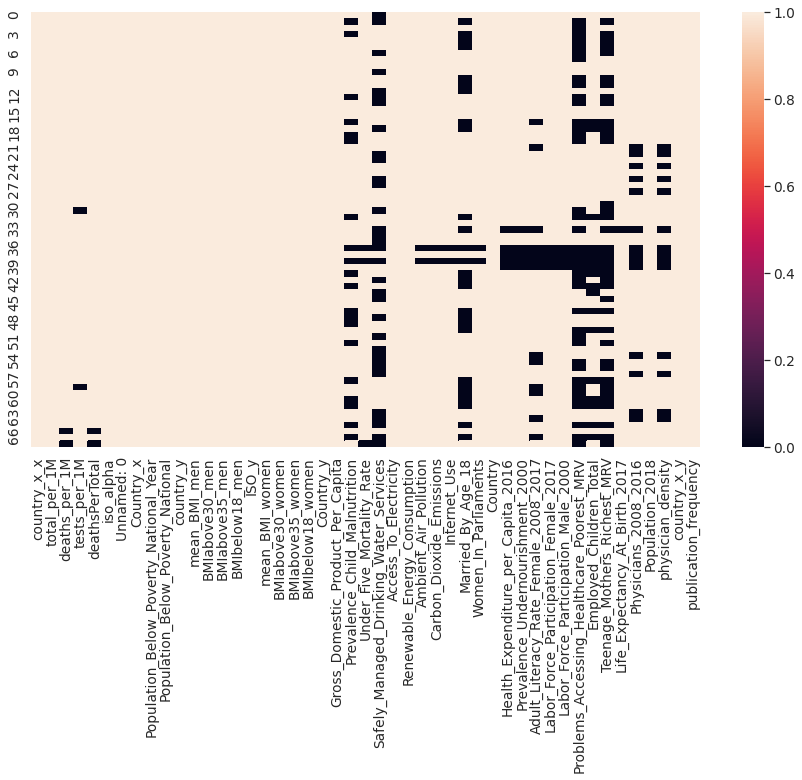

In [294]:
plt.figure(figsize=(15,8))
sns.heatmap(experiment4.notna())
plt.show()

In [295]:
experiment4.columns

Index(['country_x_x', 'total_per_1M', 'deaths_per_1M', 'tests_per_1M',
       'deathsPerTotal', 'iso_alpha', 'Unnamed: 0', 'Country_x',
       'Population_Below_Poverty_National_Year',
       'Population_Below_Poverty_National', 'country_y', 'mean_BMI_men',
       'BMIabove30_men', 'BMIabove35_men', 'BMIbelow18_men', 'ISO_y',
       'mean_BMI_women', 'BMIabove30_women', 'BMIabove35_women',
       'BMIbelow18_women', 'Country_y', 'Gross_Domestic_Product_Per_Capita',
       'Prevalence_Child_Malnutrition', 'Under_Five_Mortality_Rate',
       'Safely_Managed_Drinking_Water_Services', 'Access_To_Electricity',
       'Renewable_Energy_Consumption', 'Ambient_Air_Pollution',
       'Carbon_Dioxide_Emissions', 'Internet_Use', 'Married_By_Age_18',
       'Women_In_Parliaments', 'Country', 'Health_Expenditure_per_Capita_2016',
       'Prevalence_Undernourishment_2000',
       'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female_2017',
       'Labor_Force_Participation

In [296]:
experiment4.head()

,country_x_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Unnamed: 0,Country_x,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Country_y,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,physician_density,country_x_y,publication_frequency
0,India,4939.0,76.0,59462.0,0.015388,IND,89,India,2011.0,22.0,India,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445,India,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0,0.000739,India,249
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,26,Brazil,2015.0,9.0,Brazil,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312,Brazil,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0,0.009524,Brazil,137
2,Colombia,17046.0,529.0,77761.0,0.031034,COL,42,Colombia,2018.0,27.0,Colombia,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259,Colombia,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0,0.040000,Colombia,47
3,Argentina,18198.0,482.0,46594.0,0.026486,ARG,7,Argentina,2018.0,32.0,Argentina,28.017682,0.282313,0.076017,0.003472,ARG,27.798589,0.301352,0.124261,0.011436,Argentina,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0,0.088889,Argentina,37
4,Mexico,6146.0,637.0,15633.0,0.103645,MEX,128,Mexico,2018.0,42.0,Mexico,27.635164,0.251200,0.070726,0.008199,MEX,28.592706,0.339817,0.132470,0.015216,Mexico,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0,0.015873,Mexico,35


## CORRELATIONS

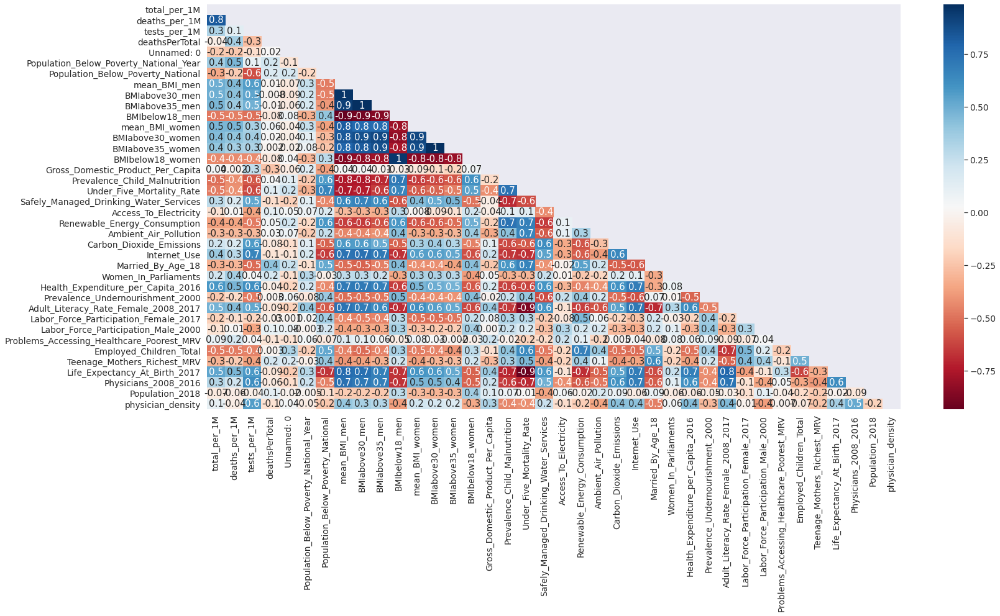

In [231]:
#get correlations of each features in dataset
corrmat = experiment3.corr()
top_corr_features = corrmat.index

mask = np.zeros_like(corrmat, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

plt.figure(figsize=(25,12))
# plt.legend(loc='left')
cmap = sns.diverging_palette(220, 10, as_cmap=True)  # custom color map

# plot heat map
g=sns.heatmap(experiment3[top_corr_features].corr(),annot=True,cmap="RdBu", mask=mask, fmt='.1g')

/usr/local/lib/python3.6/dist-packages/seaborn/matrix.py:204: RuntimeWarning:

All-NaN slice encountered

/usr/local/lib/python3.6/dist-packages/seaborn/matrix.py:209: RuntimeWarning:

All-NaN slice encountered



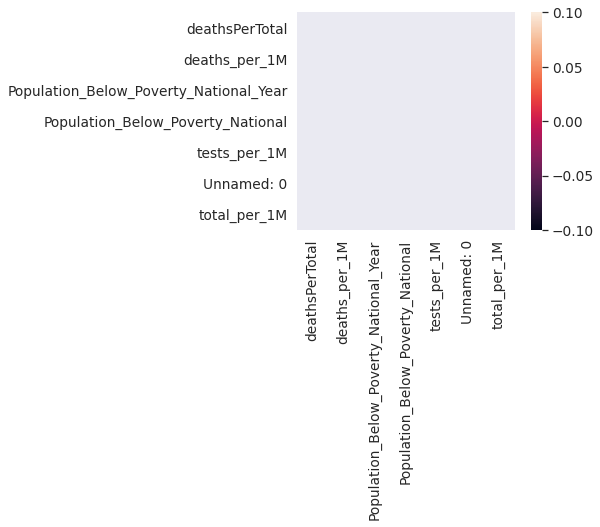

In [ ]:
# Top 10 Heatmap - Great, but do not take into consideration the categoric variables

k = 10 #number of variables for heatmap
cols = corrmat.nlargest(k, 'deathsPerTotal')['deathsPerTotal'].index
cm = np.corrcoef(experiment[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=True, annot=True, fmt='.1g', square=True, annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

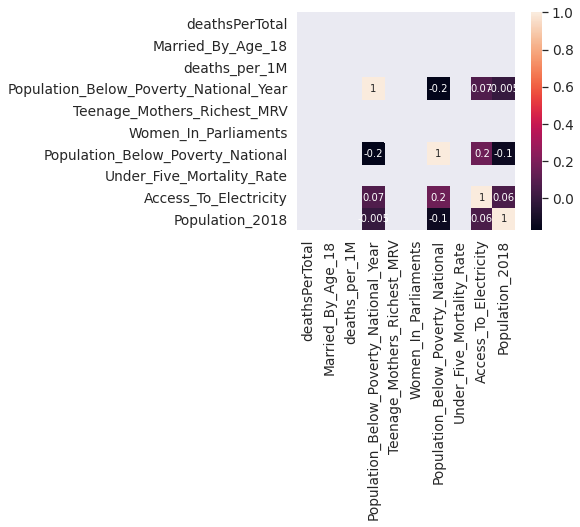

In [258]:
# Top 10 Heatmap - Great, but do not take into consideration the categoric variables

k = 10 #number of variables for heatmap
cols = corrmat.nlargest(k, 'deathsPerTotal')['deathsPerTotal'].index
cm = np.corrcoef(experiment3[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=True, annot=True, fmt='.1g', square=True, annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

## Data Analysis Baseline Library (dabl)

In [ ]:
# https://www.kaggle.com/pavansanagapati/6-useful-automated-ml-tools-for-data-scientists

In [260]:
pip install dabl

     |████████████████████████████████| 573kB 3.3MB/s 
  Created wheel for dabl: filename=dabl-0.1.9-cp36-none-any.whl size=572788 sha256=dcaa5ef741609bc0e03299263b096679c3b80d9e69bc37caa595d92e1eb2b381
  Stored in directory: /root/.cache/pip/wheels/5c/cc/90/94172b7b3c03126e869bba34ed3852a617ddc6621ad1385697
Successfully built dabl


In [261]:
import dabl

/usr/local/lib/python3.6/dist-packages/dabl/plot/supervised.py:540: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:403: RuntimeWarning:

invalid value encountered in greater_equal

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:404: RuntimeWarning:

invalid value encountered in less_equal

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:839: RuntimeWarning:

invalid value encountered in greater_equal

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:840: RuntimeWarning:

invalid value encountered in less_equal

/usr/local/lib/python3.6/dist-packages/dabl/plot/supervised.py:59: UserWarning:

Missing values in target_col have been removed for regression



Target looks like regression
Showing only top 10 of 36 continuous features


/usr/local/lib/python3.6/dist-packages/dabl/plot/supervised.py:124: UserWarning:

Missing values in target_col have been removed for regression



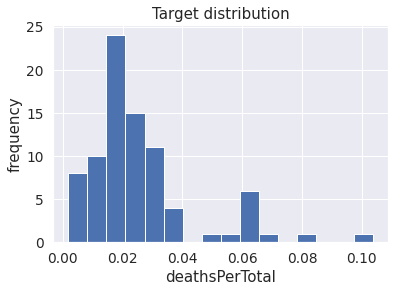

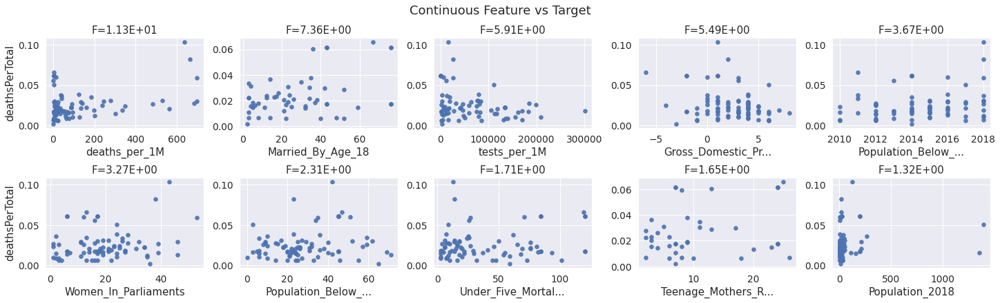

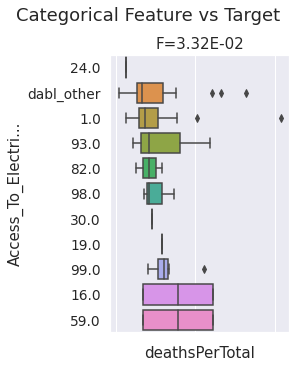

In [262]:
dabl.plot(experiment3, 'deathsPerTotal')

In [302]:
experiment4_clean.head()

,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,physician_density,publication_frequency
0,4939.0,76.0,59462.0,0.015388,IND,2011.0,22.0,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0,0.000739,249
1,23482.0,696.0,84053.0,0.029640,BRA,2015.0,9.0,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0,0.009524,137
2,17046.0,529.0,77761.0,0.031034,COL,2018.0,27.0,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0,0.040000,47
3,18198.0,482.0,46594.0,0.026486,ARG,2018.0,32.0,28.017682,0.282313,0.076017,0.003472,ARG,27.798589,0.301352,0.124261,0.011436,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0,0.088889,37
4,6146.0,637.0,15633.0,0.103645,MEX,2018.0,42.0,27.635164,0.251200,0.070726,0.008199,MEX,28.592706,0.339817,0.132470,0.015216,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0,0.015873,35


In [305]:
from google.colab import files

experiment4_clean.to_csv('experiment4_clean.csv')
files.download('experiment4_clean.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [347]:
clinical_trial_locations.head()

,country_x,clinical_trial_frequency,iso_alpha
0,United States,4811,USA
1,France,1680,FRA
2,Spain,958,ESP
3,Italy,567,ITA
4,Brazil,509,BRA


In [348]:
experiment5 = pd.merge(experiment4_clean, clinical_trial_locations, on='iso_alpha')

In [349]:
experiment5.head()

,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,physician_density,publication_frequency,country_x,clinical_trial_frequency
0,4939.0,76.0,59462.0,0.015388,IND,2011.0,22.0,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0,0.000739,249,India,114
1,23482.0,696.0,84053.0,0.029640,BRA,2015.0,9.0,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0,0.009524,137,Brazil,509
2,17046.0,529.0,77761.0,0.031034,COL,2018.0,27.0,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0,0.040000,47,Colombia,80
3,18198.0,482.0,46594.0,0.026486,ARG,2018.0,32.0,28.017682,0.282313,0.076017,0.003472,ARG,27.798589,0.301352,0.124261,0.011436,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0,0.088889,37,Argentina,100
4,6146.0,637.0,15633.0,0.103645,MEX,2018.0,42.0,27.635164,0.251200,0.070726,0.008199,MEX,28.592706,0.339817,0.132470,0.015216,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0,0.015873,35,Mexico,141


In [351]:
experiment5.columns

Index(['total_per_1M', 'deaths_per_1M', 'tests_per_1M', 'deathsPerTotal',
       'iso_alpha', 'Population_Below_Poverty_National_Year',
       'Population_Below_Poverty_National', 'mean_BMI_men', 'BMIabove30_men',
       'BMIabove35_men', 'BMIbelow18_men', 'ISO_y', 'mean_BMI_women',
       'BMIabove30_women', 'BMIabove35_women', 'BMIbelow18_women',
       'Gross_Domestic_Product_Per_Capita', 'Prevalence_Child_Malnutrition',
       'Under_Five_Mortality_Rate', 'Safely_Managed_Drinking_Water_Services',
       'Access_To_Electricity', 'Renewable_Energy_Consumption',
       'Ambient_Air_Pollution', 'Carbon_Dioxide_Emissions', 'Internet_Use',
       'Married_By_Age_18', 'Women_In_Parliaments', 'Country',
       'Health_Expenditure_per_Capita_2016',
       'Prevalence_Undernourishment_2000',
       'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female_2017',
       'Labor_Force_Participation_Male_2000',
       'Problems_Accessing_Healthcare_Poorest_MRV', 'Employed_

In [350]:
from google.colab import files

experiment5.to_csv('experiment5.csv')
files.download('experiment5.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [353]:
from google.colab import files

FINAL_WORLD_REPORT.to_csv('FINAL_WORLD_REPORT.csv')
files.download('FINAL_WORLD_REPORT.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## REMOVE ALL YEARS FROM COL NAMES!!!!

In [355]:
FINAL_WORLD_REPORT.columns

Index(['total_per_1M', 'deaths_per_1M', 'tests_per_1M', 'deathsPerTotal',
       'iso_alpha', 'Population_Below_Poverty_National', 'mean_BMI_men',
       'BMIabove30_men', 'BMIabove35_men', 'BMIbelow18_men', 'ISO_y',
       'mean_BMI_women', 'BMIabove30_women', 'BMIabove35_women',
       'BMIbelow18_women', 'Gross_Domestic_Product_Per_Capita',
       'Prevalence_Child_Malnutrition', 'Under_Five_Mortality_Rate',
       'Safely_Managed_Drinking_Water_Services', 'Access_To_Electricity',
       'Renewable_Energy_Consumption', 'Ambient_Air_Pollution',
       'Carbon_Dioxide_Emissions', 'Internet_Use', 'Married_By_Age_18',
       'Women_In_Parliaments', 'Country', 'Health_Expenditure_per_Capita_2016',
       'Prevalence_Undernourishment_2000',
       'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female_2017',
       'Labor_Force_Participation_Male_2000',
       'Problems_Accessing_Healthcare_Poorest_MRV', 'Employed_Children_Total',
       'Teenage_Mothers_Richest_

In [358]:
FINAL_WORLD_REPORT = FINAL_WORLD_REPORT.rename(columns={"Health_Expenditure_per_Capita_2016": "Health_Expenditure_per_Capita", "Prevalence_Undernourishment_2000": "Prevalence_Undernourishment",
                                                              "HAdult_Literacy_Rate_Female_2008_2017": "Adult_Literacy_Rate_Female", "Labor_Force_Participation_Female_2017": "Labor_Force_Participation_Female",
                                                              "Labor_Force_Participation_Male_2000": "Labor_Force_Participation_Male", "Life_Expectancy_At_Birth_2017": "Life_Expectancy_At_Birth",
                                                              "Physicians_2008_2016": "Physicians", "Population_2018": "Population"})

In [359]:
FINAL_WORLD_REPORT.head()

,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Population_Below_Poverty_National,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita,Prevalence_Undernourishment,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female,Labor_Force_Participation_Male,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth,Physicians,Population,physician_density,publication_frequency,country_x,clinical_trial_frequency
0,4939.0,76.0,59462.0,0.015388,IND,22.0,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0,0.000739,249,India,114
1,23482.0,696.0,84053.0,0.029640,BRA,9.0,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0,0.009524,137,Brazil,509
2,17046.0,529.0,77761.0,0.031034,COL,27.0,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0,0.040000,47,Colombia,80
3,18198.0,482.0,46594.0,0.026486,ARG,32.0,28.017682,0.282313,0.076017,0.003472,ARG,27.798589,0.301352,0.124261,0.011436,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0,0.088889,37,Argentina,100
4,6146.0,637.0,15633.0,0.103645,MEX,42.0,27.635164,0.251200,0.070726,0.008199,MEX,28.592706,0.339817,0.132470,0.015216,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0,0.015873,35,Mexico,141


In [364]:
FINAL_WORLD_REPORT.columns

Index(['total_per_1M', 'deaths_per_1M', 'tests_per_1M', 'deathsPerTotal',
       'iso_alpha', 'Population_Below_Poverty_National', 'mean_BMI_men',
       'BMIabove30_men', 'BMIabove35_men', 'BMIbelow18_men', 'ISO_y',
       'mean_BMI_women', 'BMIabove30_women', 'BMIabove35_women',
       'BMIbelow18_women', 'Gross_Domestic_Product_Per_Capita',
       'Prevalence_Child_Malnutrition', 'Under_Five_Mortality_Rate',
       'Safely_Managed_Drinking_Water_Services', 'Access_To_Electricity',
       'Renewable_Energy_Consumption', 'Ambient_Air_Pollution',
       'Carbon_Dioxide_Emissions', 'Internet_Use', 'Married_By_Age_18',
       'Women_In_Parliaments', 'Country', 'Health_Expenditure_per_Capita',
       'Prevalence_Undernourishment', 'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female', 'Labor_Force_Participation_Male',
       'Problems_Accessing_Healthcare_Poorest_MRV', 'Employed_Children_Total',
       'Teenage_Mothers_Richest_MRV', 'Life_Expectancy_At_Birth', 

In [360]:
FINAL_WORLD_REPORT = FINAL_WORLD_REPORT.drop(['Physicians'], axis=1)

In [365]:
FINAL_WORLD_REPORT = FINAL_WORLD_REPORT.drop(['country_x', 'ISO_y'], axis=1)

In [366]:
from google.colab import files

FINAL_WORLD_REPORT.to_csv('FINAL_WORLD_REPORT.csv')
files.download('FINAL_WORLD_REPORT.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [367]:
FINAL_WORLD_REPORT_4_DABL = FINAL_WORLD_REPORT.drop(['deaths_per_1M'], axis=1)

/usr/local/lib/python3.6/dist-packages/dabl/plot/supervised.py:540: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like regression
Showing only top 10 of 32 continuous features


/usr/local/lib/python3.6/dist-packages/dabl/plot/utils.py:630: UserWarning:

Dropped 1 outliers in column publication_frequency.



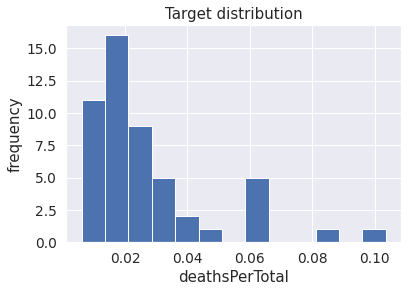

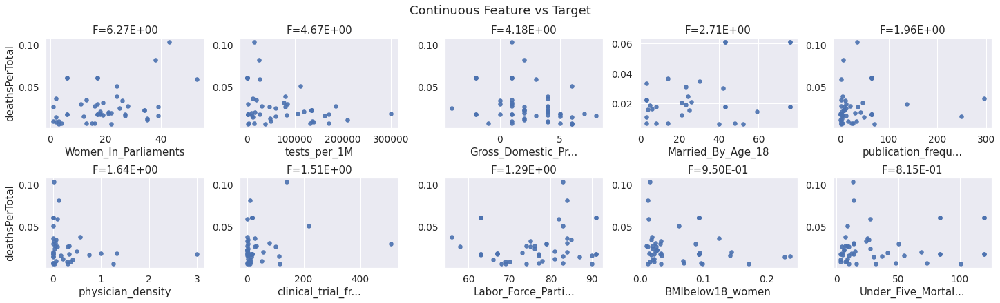

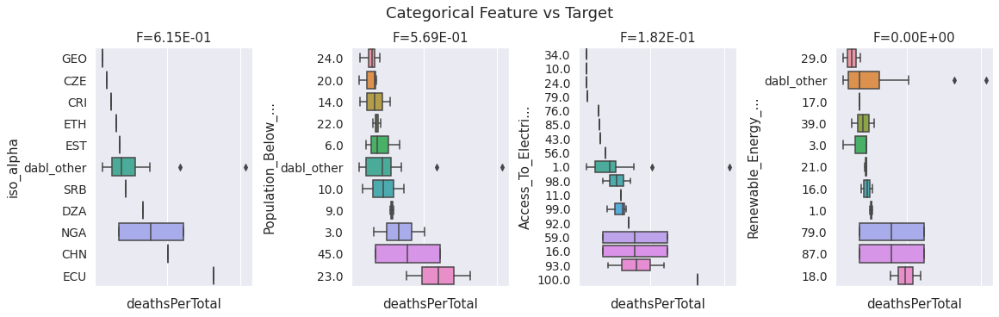

In [368]:
dabl.plot(FINAL_WORLD_REPORT_4_DABL, 'deathsPerTotal')

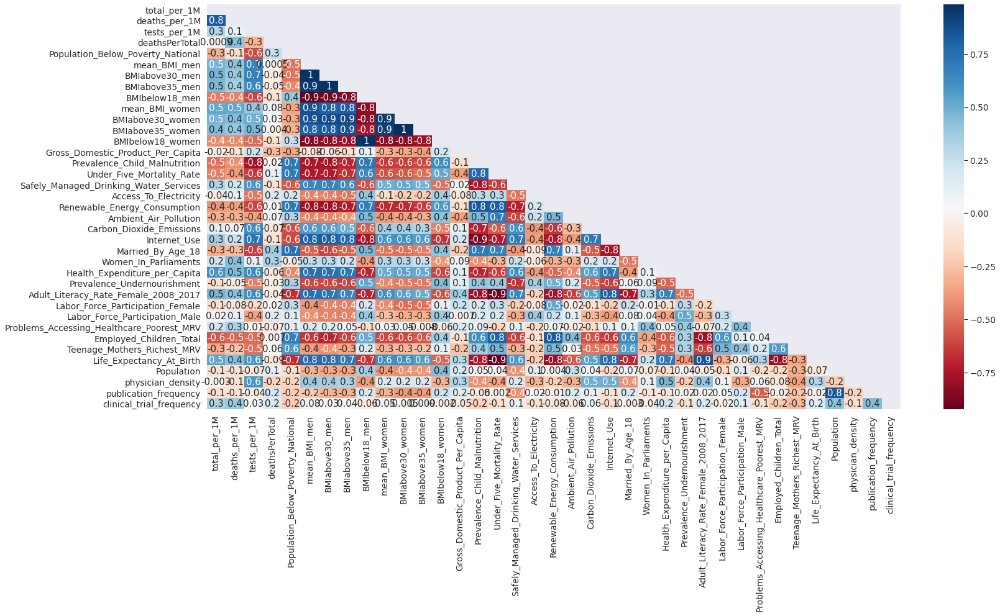

In [369]:
#get correlations of each features in dataset
corrmat = FINAL_WORLD_REPORT.corr()
top_corr_features = corrmat.index

mask = np.zeros_like(corrmat, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

plt.figure(figsize=(25,12))
# plt.legend(loc='left')
cmap = sns.diverging_palette(220, 10, as_cmap=True)  # custom color map

# plot heat map
g=sns.heatmap(FINAL_WORLD_REPORT[top_corr_features].corr(),annot=True,cmap="RdBu", mask=mask, fmt='.1g')

## REMOVE TESTS PER 1M and REPEAT!

In [263]:
experiment_clean.head()

,country_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,physician_density
0,India,4939.0,76.0,59462.0,0.015388,IND,2011.0,22.0,India,21.814527,0.028715,0.003298,0.225643,22.003666,0.053060,0.011160,0.237445,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0,0.000739
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,2015.0,9.0,Brazil,26.471577,0.192359,0.043007,0.017673,27.038562,0.264351,0.101411,0.031312,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0,0.009524
2,Colombia,17046.0,529.0,77761.0,0.031034,COL,2018.0,27.0,Colombia,25.990732,0.182812,0.038402,0.015566,26.754532,0.277014,0.086031,0.024259,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0,0.040000
3,Argentina,18198.0,482.0,46594.0,0.026486,ARG,2018.0,32.0,Argentina,28.017682,0.282313,0.076017,0.003472,27.798589,0.301352,0.124261,0.011436,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0,0.088889
4,Mexico,6146.0,637.0,15633.0,0.103645,MEX,2018.0,42.0,Mexico,27.635164,0.251200,0.070726,0.008199,28.592706,0.339817,0.132470,0.015216,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0,0.015873


In [303]:
experiment_4_dabl = experiment4_clean.drop(['deaths_per_1M'], axis=1)

/usr/local/lib/python3.6/dist-packages/dabl/plot/supervised.py:540: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:403: RuntimeWarning:

invalid value encountered in greater_equal

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:404: RuntimeWarning:

invalid value encountered in less_equal

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:839: RuntimeWarning:

invalid value encountered in greater_equal

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:840: RuntimeWarning:

invalid value encountered in less_equal

/usr/local/lib/python3.6/dist-packages/dabl/plot/supervised.py:59: UserWarning:

Missing values in target_col have been removed for regression



Target looks like regression
Showing only top 10 of 34 continuous features


/usr/local/lib/python3.6/dist-packages/dabl/plot/utils.py:630: UserWarning:

Dropped 1 outliers in column publication_frequency.

/usr/local/lib/python3.6/dist-packages/dabl/plot/supervised.py:124: UserWarning:

Missing values in target_col have been removed for regression



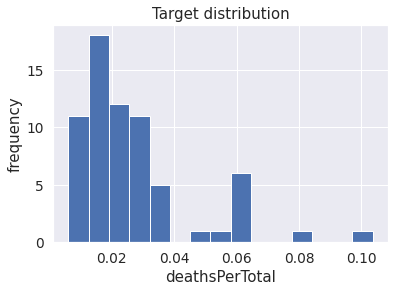

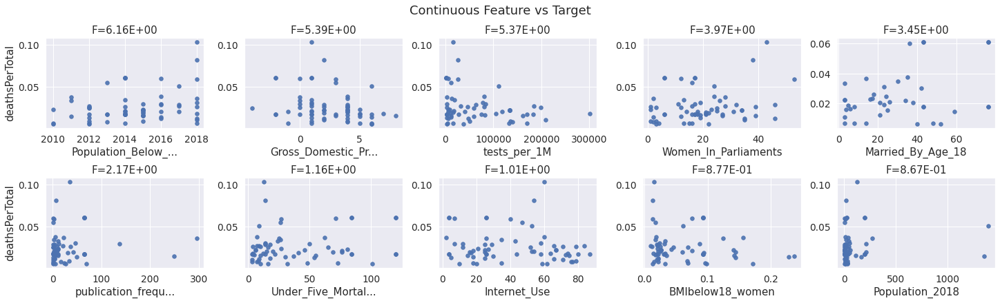

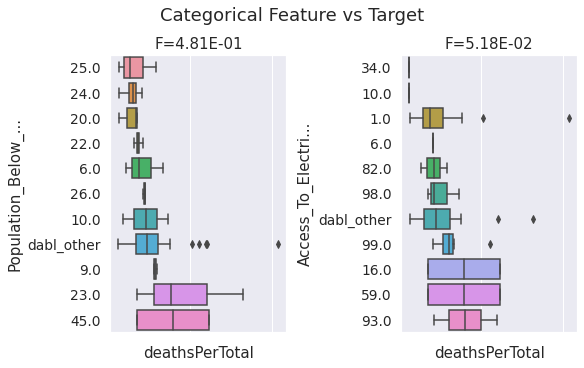

In [304]:
dabl.plot(experiment_4_dabl, 'deathsPerTotal')

In [297]:
experiment4.columns

Index(['country_x_x', 'total_per_1M', 'deaths_per_1M', 'tests_per_1M',
       'deathsPerTotal', 'iso_alpha', 'Unnamed: 0', 'Country_x',
       'Population_Below_Poverty_National_Year',
       'Population_Below_Poverty_National', 'country_y', 'mean_BMI_men',
       'BMIabove30_men', 'BMIabove35_men', 'BMIbelow18_men', 'ISO_y',
       'mean_BMI_women', 'BMIabove30_women', 'BMIabove35_women',
       'BMIbelow18_women', 'Country_y', 'Gross_Domestic_Product_Per_Capita',
       'Prevalence_Child_Malnutrition', 'Under_Five_Mortality_Rate',
       'Safely_Managed_Drinking_Water_Services', 'Access_To_Electricity',
       'Renewable_Energy_Consumption', 'Ambient_Air_Pollution',
       'Carbon_Dioxide_Emissions', 'Internet_Use', 'Married_By_Age_18',
       'Women_In_Parliaments', 'Country', 'Health_Expenditure_per_Capita_2016',
       'Prevalence_Undernourishment_2000',
       'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female_2017',
       'Labor_Force_Participation

In [298]:
experiment4_clean = experiment4.drop(['Unnamed: 0', 'Country_x', 'country_x_y'], axis=1)

In [299]:
experiment4_clean.columns

Index(['country_x_x', 'total_per_1M', 'deaths_per_1M', 'tests_per_1M',
       'deathsPerTotal', 'iso_alpha', 'Population_Below_Poverty_National_Year',
       'Population_Below_Poverty_National', 'country_y', 'mean_BMI_men',
       'BMIabove30_men', 'BMIabove35_men', 'BMIbelow18_men', 'ISO_y',
       'mean_BMI_women', 'BMIabove30_women', 'BMIabove35_women',
       'BMIbelow18_women', 'Country_y', 'Gross_Domestic_Product_Per_Capita',
       'Prevalence_Child_Malnutrition', 'Under_Five_Mortality_Rate',
       'Safely_Managed_Drinking_Water_Services', 'Access_To_Electricity',
       'Renewable_Energy_Consumption', 'Ambient_Air_Pollution',
       'Carbon_Dioxide_Emissions', 'Internet_Use', 'Married_By_Age_18',
       'Women_In_Parliaments', 'Country', 'Health_Expenditure_per_Capita_2016',
       'Prevalence_Undernourishment_2000',
       'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female_2017',
       'Labor_Force_Participation_Male_2000',
       'Problems_Acce

In [300]:
experiment4_clean = experiment4_clean.drop(['country_x_x', 'country_y', 'Country_y'], axis=1)

In [301]:
experiment4_clean.columns

Index(['total_per_1M', 'deaths_per_1M', 'tests_per_1M', 'deathsPerTotal',
       'iso_alpha', 'Population_Below_Poverty_National_Year',
       'Population_Below_Poverty_National', 'mean_BMI_men', 'BMIabove30_men',
       'BMIabove35_men', 'BMIbelow18_men', 'ISO_y', 'mean_BMI_women',
       'BMIabove30_women', 'BMIabove35_women', 'BMIbelow18_women',
       'Gross_Domestic_Product_Per_Capita', 'Prevalence_Child_Malnutrition',
       'Under_Five_Mortality_Rate', 'Safely_Managed_Drinking_Water_Services',
       'Access_To_Electricity', 'Renewable_Energy_Consumption',
       'Ambient_Air_Pollution', 'Carbon_Dioxide_Emissions', 'Internet_Use',
       'Married_By_Age_18', 'Women_In_Parliaments', 'Country',
       'Health_Expenditure_per_Capita_2016',
       'Prevalence_Undernourishment_2000',
       'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female_2017',
       'Labor_Force_Participation_Male_2000',
       'Problems_Accessing_Healthcare_Poorest_MRV', 'Employed_

## LINEAR REGRESSION PIPELINE with amazing FEATURE-ENGINE

In [234]:
pip install feature_engine

     |████████████████████████████████| 9.5MB 6.7MB/s 
  Found existing installation: statsmodels 0.10.2
    Uninstalling statsmodels-0.10.2:
      Successfully uninstalled statsmodels-0.10.2


In [235]:
from math import sqrt

# for the model
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Lasso
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score

# for feature engineering
from sklearn.preprocessing import StandardScaler
from feature_engine import missing_data_imputers as mdi
from feature_engine import discretisers as dsc
from feature_engine import categorical_encoders as ce

pd.pandas.set_option('display.max_columns', None)

In [253]:
# for the model
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score               # <- newly added. TRY OUT !!!!


from sklearn.metrics import roc_auc_score
from sklearn.metrics import classification_report                # <- newly added. TRY OUT !!!!
from sklearn.metrics import confusion_matrix                     # <- newly added. SHOW IT !!!!
from sklearn.pipeline import Pipeline
from sklearn.naive_bayes import GaussianNB                       # <- newly added. TRY OUT !!!!
from sklearn import svm  

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import BaggingClassifier, AdaBoostClassifier       # <- newly added. TRY OUT !!!!
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB                       

# for feature engineering
from feature_engine import missing_data_imputers as mdi
from feature_engine import discretisers as dsc
from feature_engine import categorical_encoders as ce
from sklearn.preprocessing import StandardScaler as ssc

%matplotlib inline 
# the outputted plot will appear immediately under each code cell
from matplotlib.colors import ListedColormap

from pandas.plotting import scatter_matrix

In [238]:
experiment3.head()

,country_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Unnamed: 0,Country_x,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,ISO_y,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Country_y,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,physician_density
0,India,4939.0,76.0,59462.0,0.015388,IND,89,India,2011.0,22.0,India,21.814527,0.028715,0.003298,0.225643,IND,22.003666,0.053060,0.011160,0.237445,India,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0,0.000739
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,26,Brazil,2015.0,9.0,Brazil,26.471577,0.192359,0.043007,0.017673,BRA,27.038562,0.264351,0.101411,0.031312,Brazil,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0,0.009524
2,Colombia,17046.0,529.0,77761.0,0.031034,COL,42,Colombia,2018.0,27.0,Colombia,25.990732,0.182812,0.038402,0.015566,COL,26.754532,0.277014,0.086031,0.024259,Colombia,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0,0.040000
3,Argentina,18198.0,482.0,46594.0,0.026486,ARG,7,Argentina,2018.0,32.0,Argentina,28.017682,0.282313,0.076017,0.003472,ARG,27.798589,0.301352,0.124261,0.011436,Argentina,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0,0.088889
4,Mexico,6146.0,637.0,15633.0,0.103645,MEX,128,Mexico,2018.0,42.0,Mexico,27.635164,0.251200,0.070726,0.008199,MEX,28.592706,0.339817,0.132470,0.015216,Mexico,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0,0.015873


In [239]:
experiment_clean = experiment3.drop(['Unnamed: 0'], axis=1)

In [240]:
experiment_clean = experiment_clean.drop(['Country_x', 'ISO_y', 'Country_y'], axis=1)

In [237]:
experiment3.columns

Index(['country_x', 'total_per_1M', 'deaths_per_1M', 'tests_per_1M',
       'deathsPerTotal', 'iso_alpha', 'Unnamed: 0', 'Country_x',
       'Population_Below_Poverty_National_Year',
       'Population_Below_Poverty_National', 'country_y', 'mean_BMI_men',
       'BMIabove30_men', 'BMIabove35_men', 'BMIbelow18_men', 'ISO_y',
       'mean_BMI_women', 'BMIabove30_women', 'BMIabove35_women',
       'BMIbelow18_women', 'Country_y', 'Gross_Domestic_Product_Per_Capita',
       'Prevalence_Child_Malnutrition', 'Under_Five_Mortality_Rate',
       'Safely_Managed_Drinking_Water_Services', 'Access_To_Electricity',
       'Renewable_Energy_Consumption', 'Ambient_Air_Pollution',
       'Carbon_Dioxide_Emissions', 'Internet_Use', 'Married_By_Age_18',
       'Women_In_Parliaments', 'Country', 'Health_Expenditure_per_Capita_2016',
       'Prevalence_Undernourishment_2000',
       'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female_2017',
       'Labor_Force_Participation_M

In [241]:
experiment_clean.head()

,country_x,total_per_1M,deaths_per_1M,tests_per_1M,deathsPerTotal,iso_alpha,Population_Below_Poverty_National_Year,Population_Below_Poverty_National,country_y,mean_BMI_men,BMIabove30_men,BMIabove35_men,BMIbelow18_men,mean_BMI_women,BMIabove30_women,BMIabove35_women,BMIbelow18_women,Gross_Domestic_Product_Per_Capita,Prevalence_Child_Malnutrition,Under_Five_Mortality_Rate,Safely_Managed_Drinking_Water_Services,Access_To_Electricity,Renewable_Energy_Consumption,Ambient_Air_Pollution,Carbon_Dioxide_Emissions,Internet_Use,Married_By_Age_18,Women_In_Parliaments,Country,Health_Expenditure_per_Capita_2016,Prevalence_Undernourishment_2000,Adult_Literacy_Rate_Female_2008_2017,Labor_Force_Participation_Female_2017,Labor_Force_Participation_Male_2000,Problems_Accessing_Healthcare_Poorest_MRV,Employed_Children_Total,Teenage_Mothers_Richest_MRV,Life_Expectancy_At_Birth_2017,Physicians_2008_2016,Population_2018,physician_density
0,India,4939.0,76.0,59462.0,0.015388,IND,2011.0,22.0,India,21.814527,0.028715,0.003298,0.225643,22.003666,0.053060,0.011160,0.237445,5.0,38.0,37.0,NaN,85.0,36.0,76.0,2.0,30.0,25.0,12.0,India,63.0,18.0,59.0,24.0,83.0,79.0,2.0,3.0,69.0,1.0,1353.0,0.000739
1,Brazil,23482.0,696.0,84053.0,0.029640,BRA,2015.0,9.0,Brazil,26.471577,0.192359,0.043007,0.017673,27.038562,0.264351,0.101411,0.031312,0.0,NaN,14.0,NaN,1.0,44.0,13.0,3.0,7.0,NaN,11.0,Brazil,1016.0,12.0,92.0,54.0,79.0,NaN,3.0,NaN,76.0,2.0,210.0,0.009524
2,Colombia,17046.0,529.0,77761.0,0.031034,COL,2018.0,27.0,Colombia,25.990732,0.182812,0.038402,0.015566,26.754532,0.277014,0.086031,0.024259,1.0,13.0,14.0,71.0,99.0,24.0,17.0,2.0,58.0,23.0,19.0,Colombia,340.0,10.0,95.0,59.0,84.0,NaN,6.0,5.0,75.0,2.0,50.0,0.040000
3,Argentina,18198.0,482.0,46594.0,0.026486,ARG,2018.0,32.0,Argentina,28.017682,0.282313,0.076017,0.003472,27.798589,0.301352,0.124261,0.011436,2.0,NaN,10.0,99.0,1.0,1.0,14.0,5.0,71.0,NaN,39.0,Argentina,955.0,4.0,99.0,49.0,75.0,NaN,5.0,NaN,77.0,4.0,45.0,0.088889
4,Mexico,6146.0,637.0,15633.0,0.103645,MEX,2018.0,42.0,Mexico,27.635164,0.251200,0.070726,0.008199,28.592706,0.339817,0.132470,0.015216,1.0,12.0,13.0,43.0,1.0,9.0,19.0,4.0,60.0,NaN,43.0,Mexico,462.0,4.0,94.0,44.0,83.0,NaN,6.0,NaN,77.0,2.0,126.0,0.015873


In [243]:
experiment_clean.columns

Index(['country_x', 'total_per_1M', 'deaths_per_1M', 'tests_per_1M',
       'deathsPerTotal', 'iso_alpha', 'Population_Below_Poverty_National_Year',
       'Population_Below_Poverty_National', 'country_y', 'mean_BMI_men',
       'BMIabove30_men', 'BMIabove35_men', 'BMIbelow18_men', 'mean_BMI_women',
       'BMIabove30_women', 'BMIabove35_women', 'BMIbelow18_women',
       'Gross_Domestic_Product_Per_Capita', 'Prevalence_Child_Malnutrition',
       'Under_Five_Mortality_Rate', 'Safely_Managed_Drinking_Water_Services',
       'Access_To_Electricity', 'Renewable_Energy_Consumption',
       'Ambient_Air_Pollution', 'Carbon_Dioxide_Emissions', 'Internet_Use',
       'Married_By_Age_18', 'Women_In_Parliaments', 'Country',
       'Health_Expenditure_per_Capita_2016',
       'Prevalence_Undernourishment_2000',
       'Adult_Literacy_Rate_Female_2008_2017',
       'Labor_Force_Participation_Female_2017',
       'Labor_Force_Participation_Male_2000',
       'Problems_Accessing_Healthcare_Poorest

In [242]:
from google.colab import files

experiment_clean.to_csv('experiment_clean.csv')
files.download('experiment_clean.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [246]:
X = experiment_clean.drop(['country_x', 'total_per_1M', 'deaths_per_1M', 'tests_per_1M', 'deathsPerTotal', 'iso_alpha', 'country_y', 'Country'], axis=1)

y = experiment_clean['deathsPerTotal']    

In [247]:
X.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87 entries, 0 to 86
Data columns (total 33 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   Population_Below_Poverty_National_Year     87 non-null     float64
 1   Population_Below_Poverty_National          87 non-null     float64
 2   mean_BMI_men                               87 non-null     float64
 3   BMIabove30_men                             87 non-null     float64
 4   BMIabove35_men                             87 non-null     float64
 5   BMIbelow18_men                             87 non-null     float64
 6   mean_BMI_women                             87 non-null     float64
 7   BMIabove30_women                           87 non-null     float64
 8   BMIabove35_women                           87 non-null     float64
 9   BMIbelow18_women                           87 non-null     float64
 10  Gross_Domestic_Product_Per_C

In [248]:
# make a list of the numerical variables first
numerical = [var for var in X.columns if X[var].dtype!='O' and var != 'Population_Below_Poverty_National_Year' and var != 'Physicians_2008_2016']

print('There are {} numerical variables'.format(len(numerical)))

There are 31 numerical variables


In [249]:
numerical

['Population_Below_Poverty_National',
 'mean_BMI_men',
 'BMIabove30_men',
 'BMIabove35_men',
 'BMIbelow18_men',
 'mean_BMI_women',
 'BMIabove30_women',
 'BMIabove35_women',
 'BMIbelow18_women',
 'Gross_Domestic_Product_Per_Capita',
 'Prevalence_Child_Malnutrition',
 'Under_Five_Mortality_Rate',
 'Safely_Managed_Drinking_Water_Services',
 'Access_To_Electricity',
 'Renewable_Energy_Consumption',
 'Ambient_Air_Pollution',
 'Carbon_Dioxide_Emissions',
 'Internet_Use',
 'Married_By_Age_18',
 'Women_In_Parliaments',
 'Health_Expenditure_per_Capita_2016',
 'Prevalence_Undernourishment_2000',
 'Adult_Literacy_Rate_Female_2008_2017',
 'Labor_Force_Participation_Female_2017',
 'Labor_Force_Participation_Male_2000',
 'Problems_Accessing_Healthcare_Poorest_MRV',
 'Employed_Children_Total',
 'Teenage_Mothers_Richest_MRV',
 'Life_Expectancy_At_Birth_2017',
 'Population_2018',
 'physician_density']

In [254]:

covid_letality_pipe = Pipeline([('discretisation', dsc.EqualFrequencyDiscretiser(
        q=5, return_object=True, variables=numerical)),

        # feature Scaling - section 10
        ('scaler', ssc),
    
        # regression
        #('lasso', Lasso(random_state=0))

        # regression
        ('LinReg', LinearRegression())
])


In [255]:
# let's separate into training and testing set

X_train, X_test, y_train, y_test = train_test_split(
    X, y, 
    
    test_size=0.3,  # percentage of obs in test set
    random_state=0)  # seed to ensure reproducibility

X_train.shape, X_test.shape

((60, 33), (27, 33))

In [256]:
# let's fit the pipeline
covid_letality_pipe.fit(X_train, y_train)

# let's get the predictions
# X_train_preds = house_pipe.predict(X_train)
# X_test_preds = house_pipe.predict(X_test)

ValueError: ignored

In [ ]:
# okay, then outside a pipeline: first EFD, then ssc:

# dsc.EqualFrequencyDiscretiser(
#         q=5, return_object=True, variables=numerical)

In [ ]:
# let's get the predictions
X_train_preds = house_pipe.predict(X_train)
#X_test_preds = house_pipe.predict(X_test)

AttributeError: ignored

In [ ]:
X_train_preds

NameError: ignored

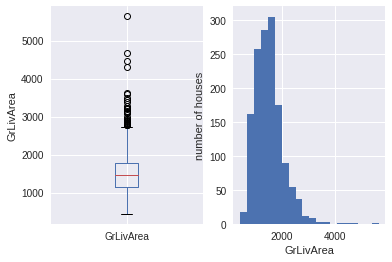

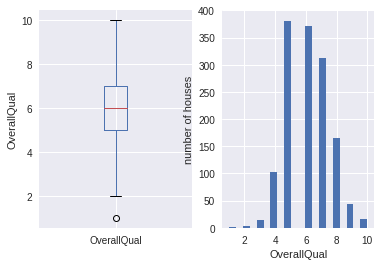

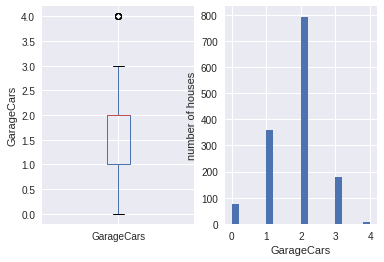

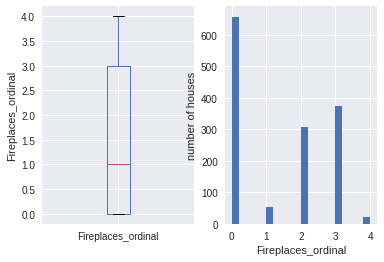

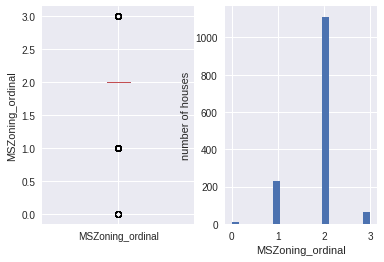

In [ ]:
for var in numerical:
    plt.figure(figsize=(6,4))
    plt.subplot(1, 2, 1)
    fig = X_train.boxplot(column=var)
    fig.set_title('')
    fig.set_ylabel(var)
    
    plt.subplot(1, 2, 2)
    fig = X_train[var].hist(bins=20)
    fig.set_ylabel('number of houses')
    fig.set_xlabel(var)

    plt.show()

In [ ]:
# negative coefficient before YearBuilt: does not make sense, does it??? -> investigate YearBuilt!
# adjusted R2 equals R2 -> no unnecessary var in my model, it seems? but: include additional ones and see if I can improve R2! :)
# H0: all coeffs = 0

LinRegCleaned=sm.OLS(y_train,X_train).fit()
LinRegCleaned.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:              SalePrice   R-squared (uncentered):                   0.951
Model:                            OLS   Adj. R-squared (uncentered):              0.950
Method:                 Least Squares   F-statistic:                              5411.
Date:                Tue, 11 Aug 2020   Prob (F-statistic):                        0.00
Time:                        21:42:43   Log-Likelihood:                         -17108.
No. Observations:                1412   AIC:                                  3.423e+04
Df Residuals:                    1407   BIC:                                  3.425e+04
Df Model:                           5                                                  
Covariance Type:            nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
GrLivArea             42.6203      2.876     14.820      0.000      36.979      48.262
OverallQual         1.292e+04   1086.991     11.890      0.000    1.08e+04    1.51e+04
GarageCars          2.393e+04   2019.855     11.846      0.000       2e+04    2.79e+04
Fireplaces_ordinal  9529.6805   1010.633      9.429      0.000    7547.171    1.15e+04
MSZoning_ordinal   -7126.1975   2302.711     -3.095      0.002   -1.16e+04   -2609.081
==============================================================================
Omnibus:                      651.803   Durbin-Watson:                   1.982
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             9586.724
Skew:                           1.758   Prob(JB):                         0.00
Kurtosis:                      15.271   Cond. No.                     3.30e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.3e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

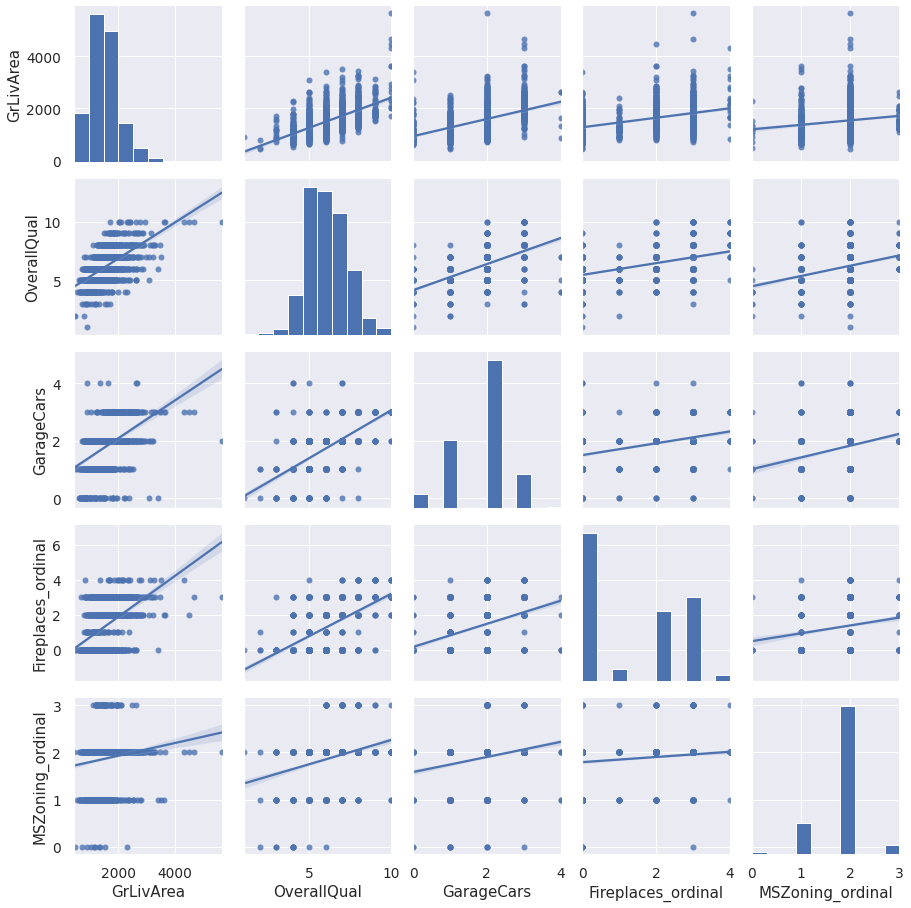

In [ ]:
sns.pairplot(X_train, vars=['GrLivArea', 'OverallQual', 'GarageCars', 'Fireplaces_ordinal', 'MSZoning_ordinal'], kind='reg')